## Setup, Loading Data and CDFs

In [6]:
DATA_NAME = 'standardTesting-full' 
TRANSFORM = 'gabor'
CHANNEL = 'gray'
PARAM_CSV = "gabor_new.csv"

In [7]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
gray_gabor_full_standardTesting.ipynb


In [8]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/standardTesting/full/gabor/gray'

In [9]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [10]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [11]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 2359296,
 1: 2359296,
 2: 2359296,
 3: 2359296,
 4: 2359296,
 5: 2359296,
 6: 2359296,
 7: 2359296,
 8: 2359296,
 9: 2359296,
 10: 2359296,
 11: 2359296,
 12: 2359296,
 13: 2359296,
 14: 2359296,
 15: 2359296,
 16: 2359296,
 17: 2359296,
 18: 2359296,
 19: 2359296,
 20: 2359296,
 21: 2359296,
 22: 2359296,
 23: 2359296,
 24: 2359296,
 25: 2359296,
 26: 2359296,
 27: 2359296,
 28: 2359296,
 29: 2359296,
 30: 2359296,
 31: 2359296,
 32: 2359296,
 33: 2359296,
 34: 2359296,
 35: 2359296,
 36: 2359296,
 37: 2359296,
 38: 2359296,
 39: 2359296,
 40: 2359296,
 41: 2359296}

Running 12760 CDFs


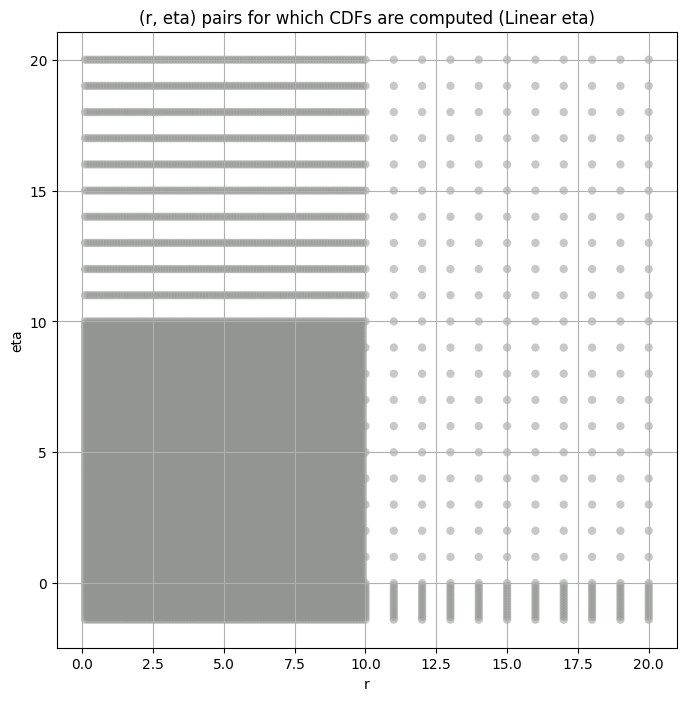

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [12]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [13]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [14]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,38922.66400,30951.148000,47092.977000,4.409872,2.737330,7.668057,2359296.0,"(2.0, 0.5, 0.044)"
1,13811.33800,10857.232000,17411.840000,5.708673,3.505895,10.191732,2359296.0,"(2.0, 0.5, 0.065)"
2,5212.11130,4147.616000,6494.641000,5.850252,3.246446,9.314557,2359296.0,"(2.0, 0.5, 0.096)"
3,1797.79000,1354.278400,2296.739300,9.139929,5.153275,16.219257,2359296.0,"(2.0, 0.5, 0.141)"
4,583.18730,428.792420,749.157100,10.078462,5.642832,22.572874,2359296.0,"(2.0, 0.5, 0.208)"
5,181.50945,127.899025,248.526540,15.314480,5.525773,54.680214,2359296.0,"(2.0, 0.5, 0.306)"
6,111.37292,80.555720,156.800570,14.459356,5.156713,57.622300,2359296.0,"(2.0, 0.5, 0.45)"
7,52155.28000,40917.543000,66751.110000,7.146744,4.161360,11.858514,2359296.0,"(2.0, 1.0, 0.044)"
8,19633.50200,15193.773000,24351.654000,6.894701,3.830083,11.340195,2359296.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [15]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [16]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,38922.66400,38922.664062,37773.964844,36928.398438,35466.714844
1,13811.33800,13811.337891,13315.708008,12965.476562,12399.890625
2,5212.11130,5212.111328,5017.784668,4879.925293,4655.940430
3,1797.79000,1797.790039,1710.367798,1647.257446,1548.520752
4,583.18730,583.187317,551.454041,530.014038,496.726837
5,181.50945,181.509445,167.097565,158.165588,146.447861
6,111.37292,111.372917,102.647118,97.410759,90.353676
7,52155.28000,52155.281250,49976.972656,48368.128906,45655.226562
8,19633.50200,19633.501953,18795.781250,18213.585938,17277.875000


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.009005374270695254 38922.664


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.008643962050478793 37773.965


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.009042827623031324 36928.4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.01029974970765779 35466.715
Number of samples: 100000, Without approximation : 2359296.0


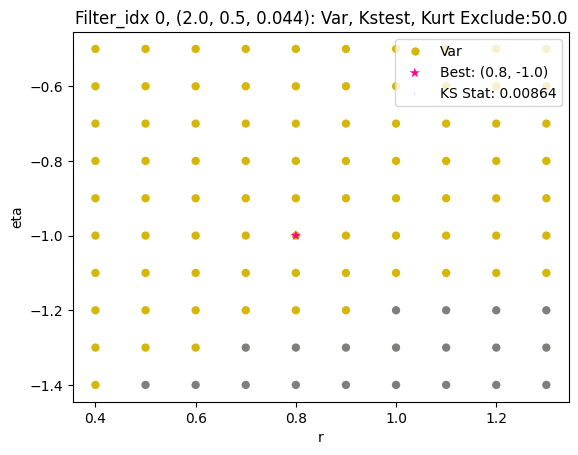

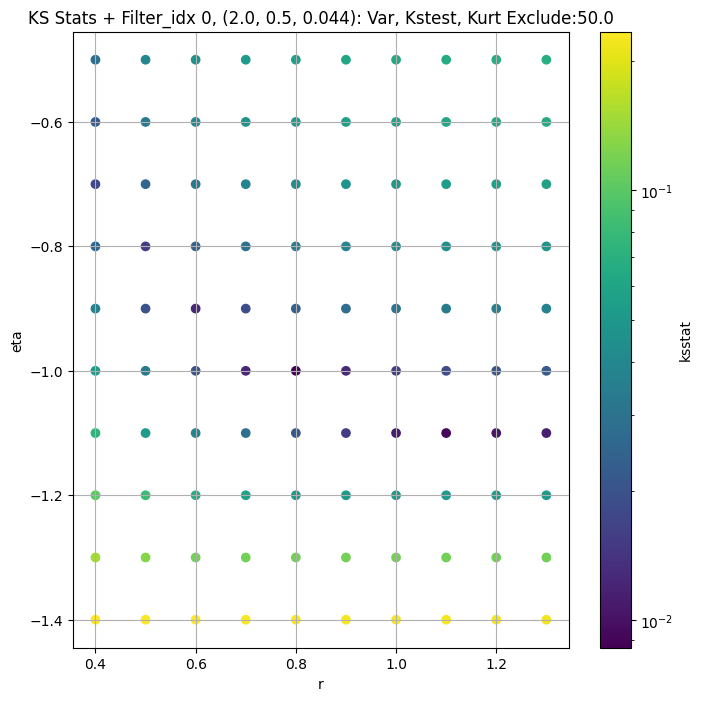

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.009054492154366212 13811.338


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.009407290834972548 13315.708


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.0097275188462142 12965.477


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.009291543316868989 12399.891
Number of samples: 100000, Without approximation : 2359296.0


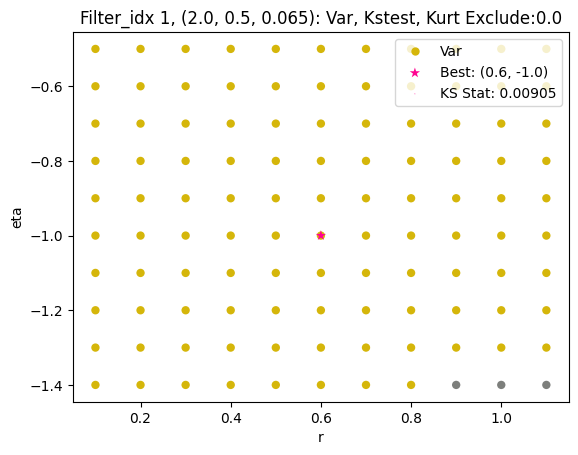

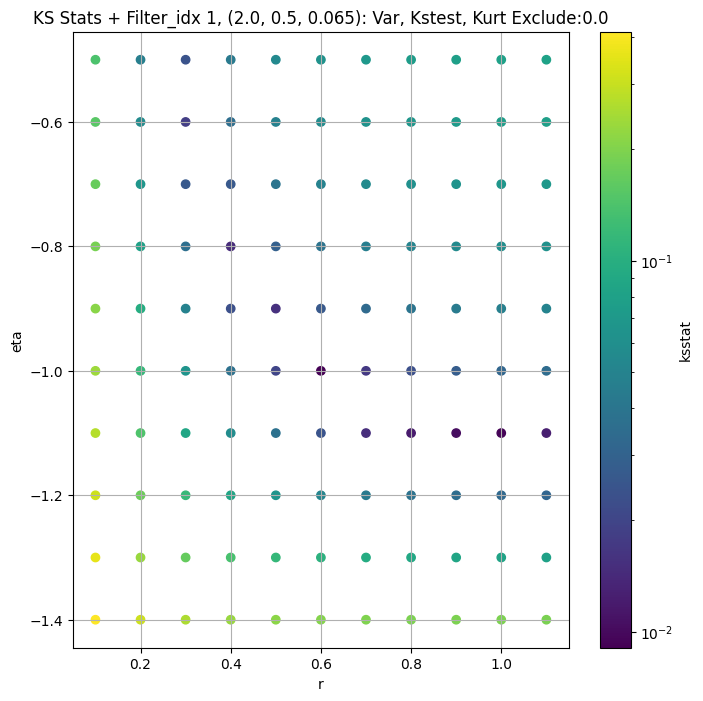

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.006735152526533117 5212.1113


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.007275677270097369 5017.7847


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.00774309435141568 4879.9253


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.00767995579472365 4655.9404
Number of samples: 100000, Without approximation : 2359296.0


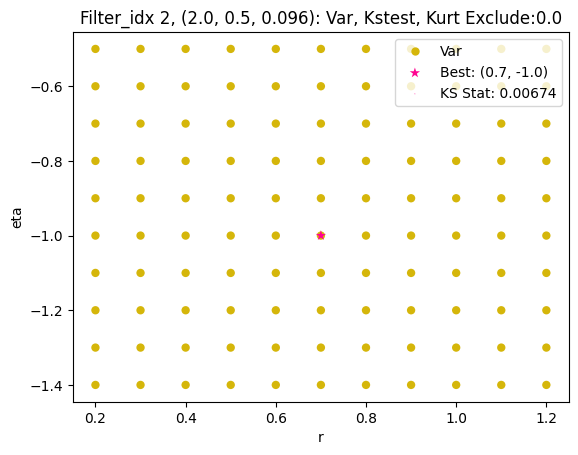

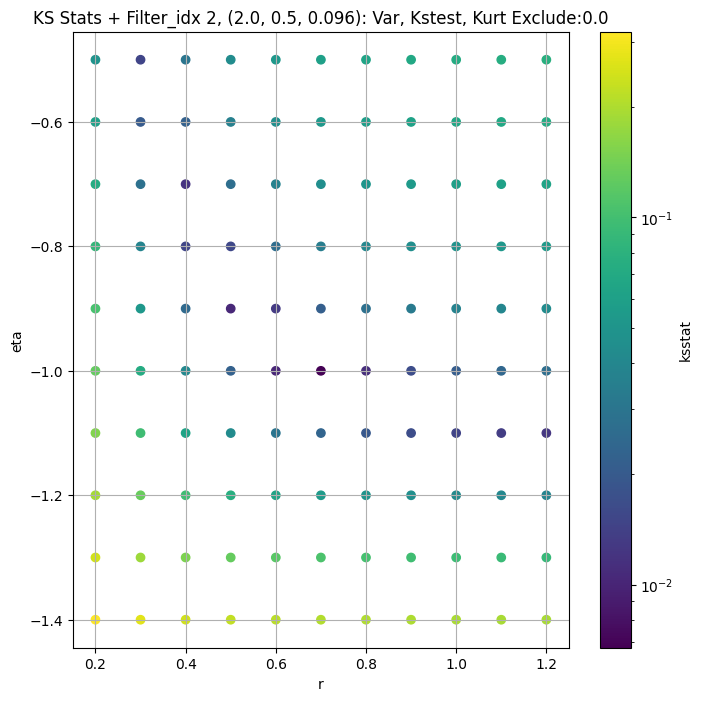

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.0178162260468816 1797.79


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.017815626038904298 1710.3678


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.01781950640453206 1647.2574


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.017807827655764052 1548.5208
Number of samples: 100000, Without approximation : 2359296.0


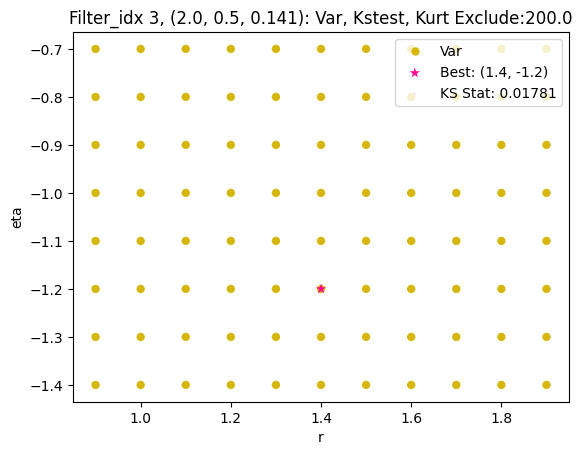

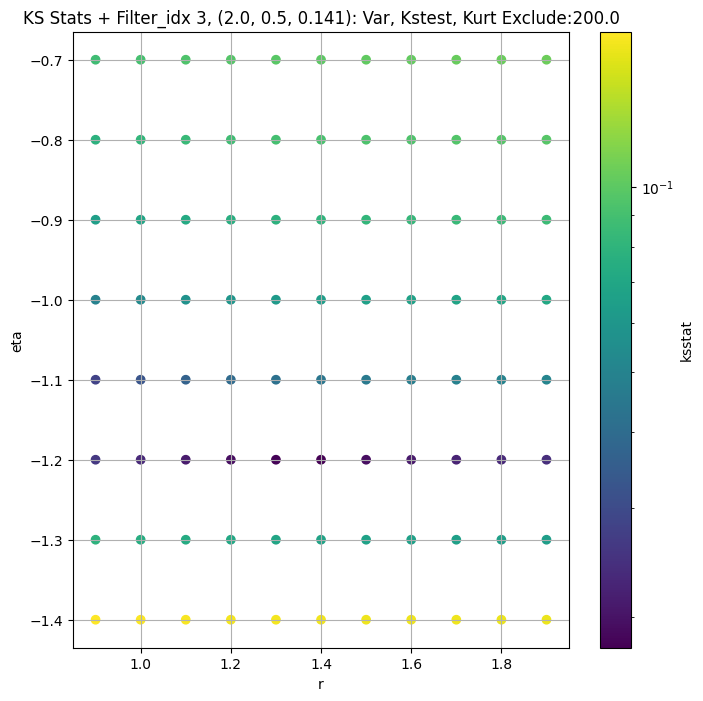

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.00992903959966758 583.1873


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.010460804086771164 551.45404


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.011269957298154165 530.01404


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.010748416819373996 496.72684
Number of samples: 100000, Without approximation : 2359296.0


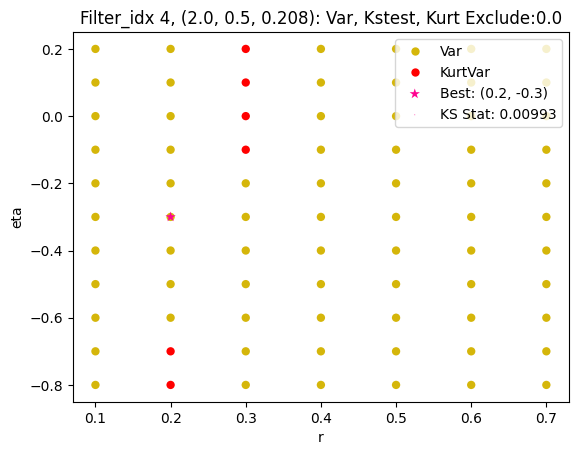

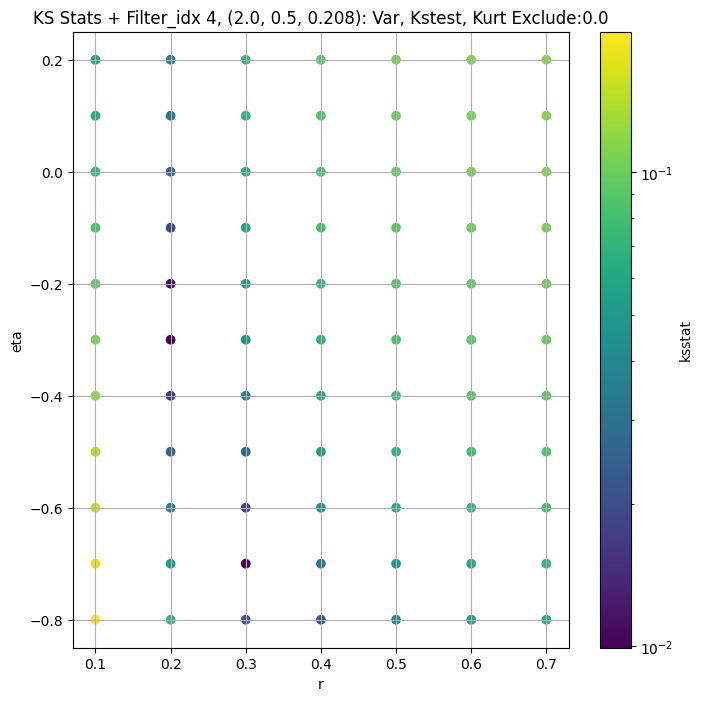

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.010095722892134062 181.50945


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.010095001174206919 167.09756


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.010089739005322174 158.16559


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.010295448407064083 146.44786
Number of samples: 100000, Without approximation : 2359296.0


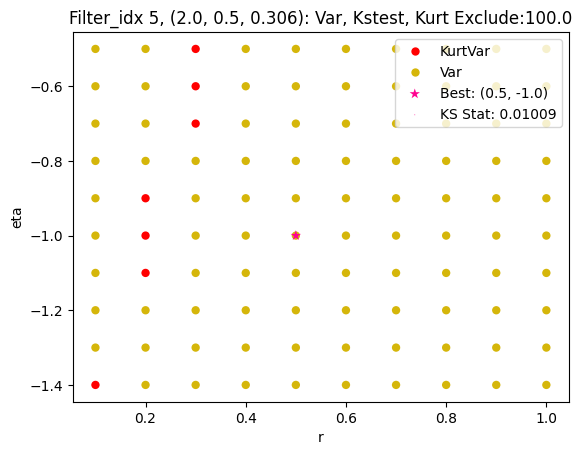

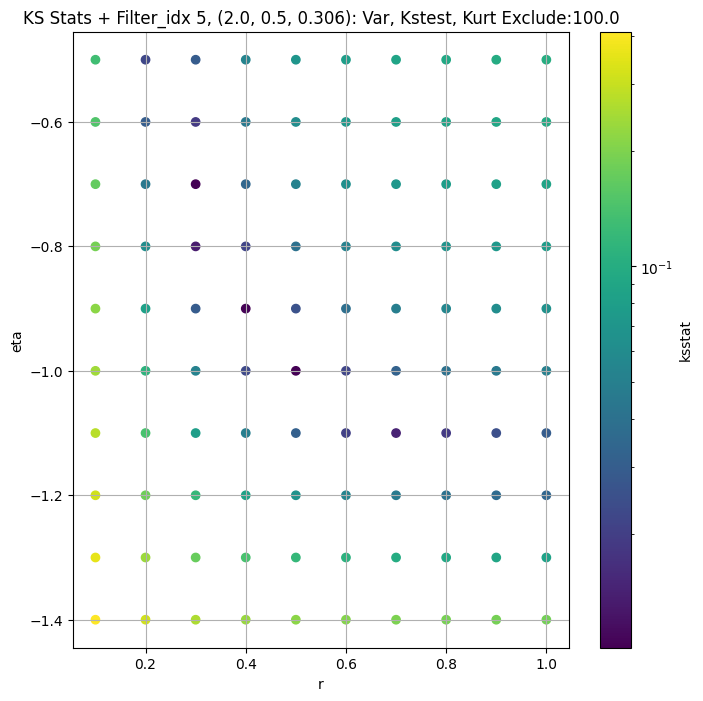

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.005017808581960492 111.37292


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.004954627148105573 102.64712


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.005552170297533743 97.41076


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.006420839068802586 90.353676
Number of samples: 100000, Without approximation : 2359296.0


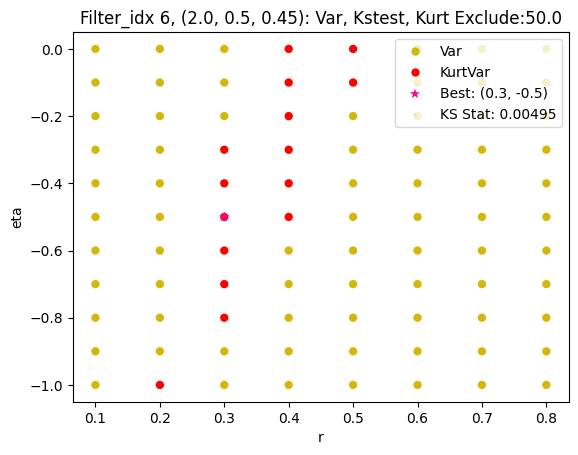

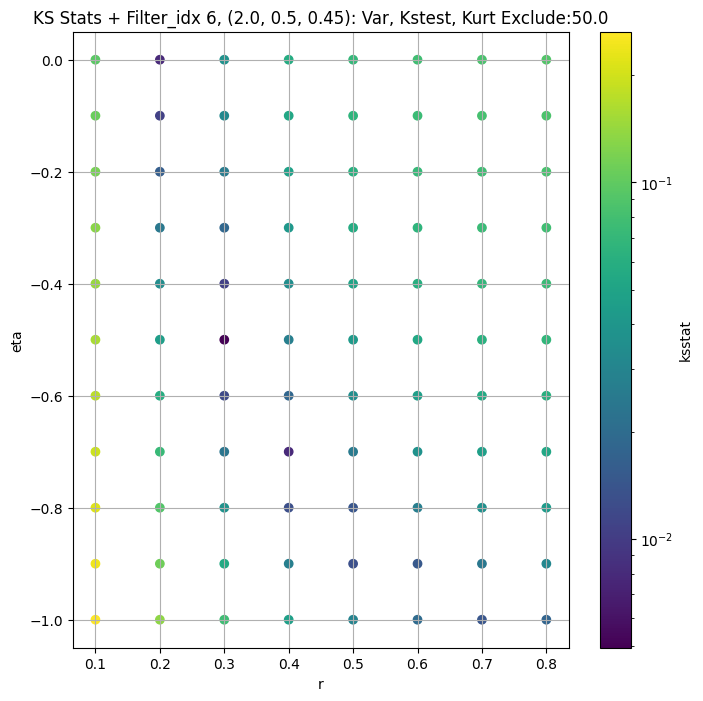

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.005557256978622749 52155.28


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.004158897243495496 49976.973


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.004182990274849363 48368.13


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.006036411432047972 45655.227
Number of samples: 100000, Without approximation : 2359296.0


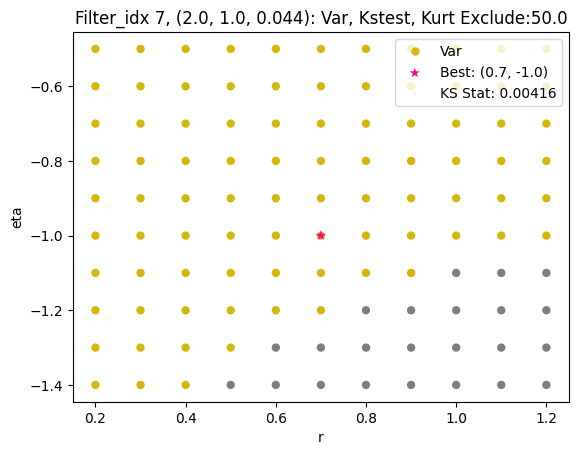

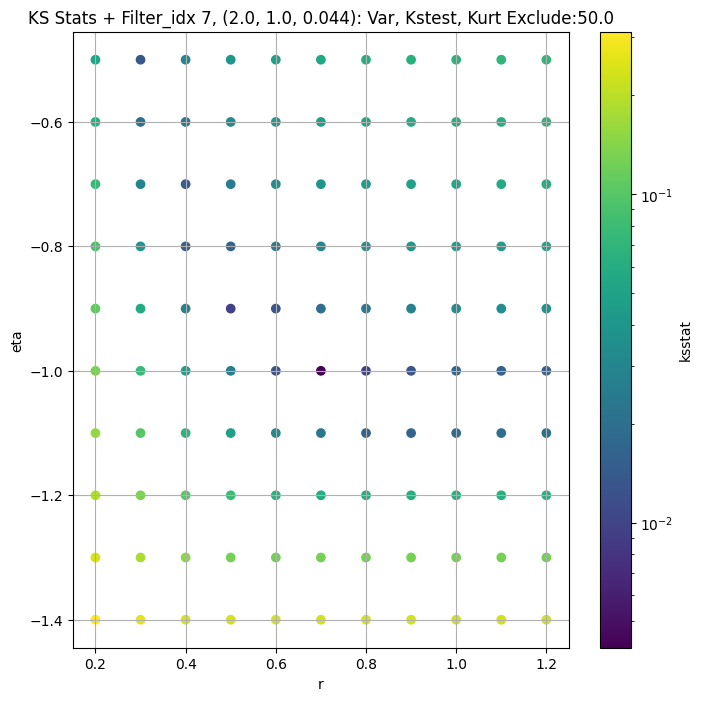

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.006595910353143664 19633.502


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.006344502423641041 18795.781


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.006163763618956319 18213.586


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.006089576561880139 17277.875
Number of samples: 100000, Without approximation : 2359296.0


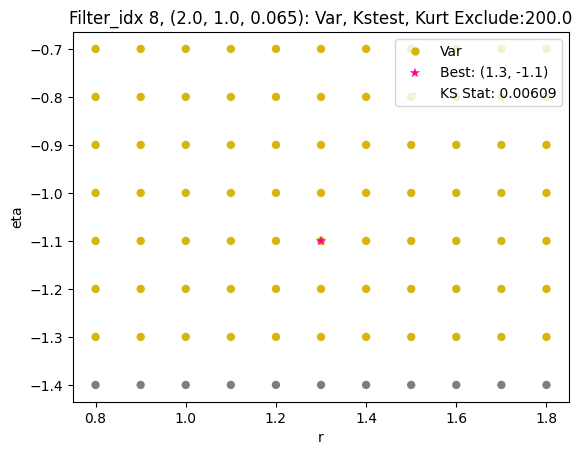

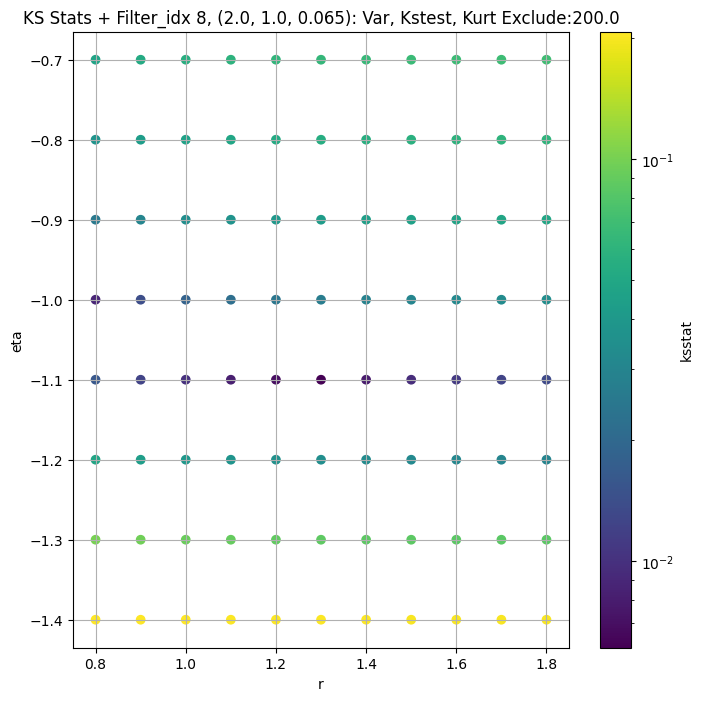

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.014356951044715016 7266.4287


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.014356621191354502 6912.5386


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.014356371327712503 6661.397


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.014355973003722156 6288.441
Number of samples: 100000, Without approximation : 2359296.0


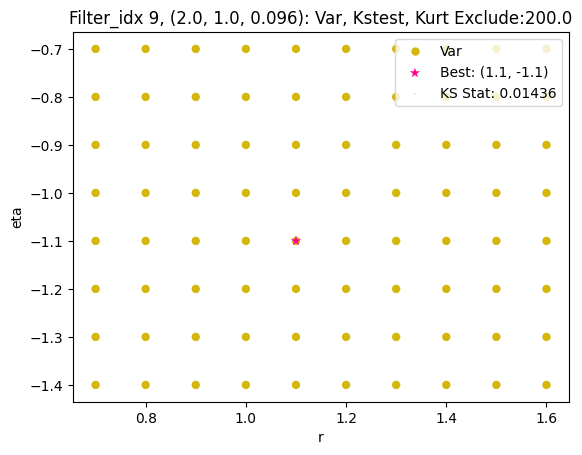

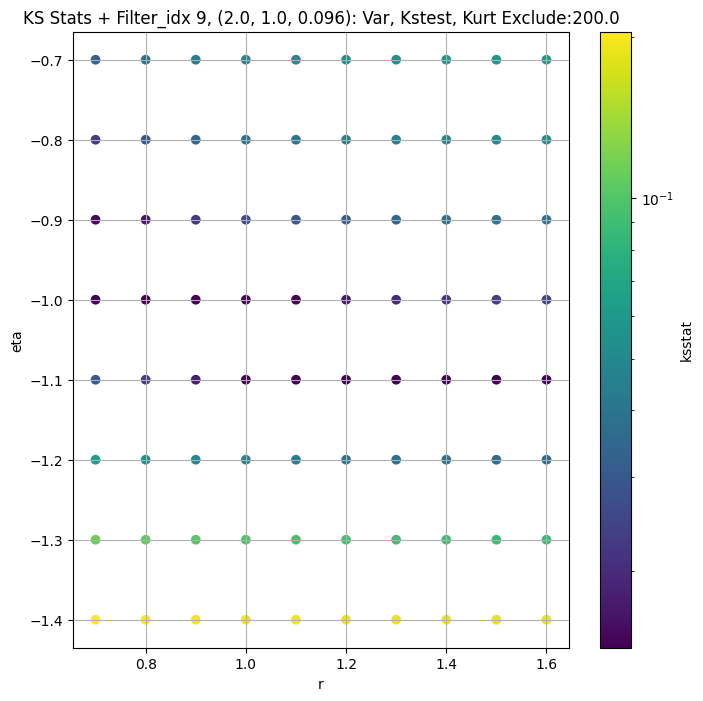

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.0073032692565668245 2767.6428


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.006509851512711606 2608.0017


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.008045399467360895 2508.8923


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.0076458676543351145 2364.2402
Number of samples: 100000, Without approximation : 2359296.0


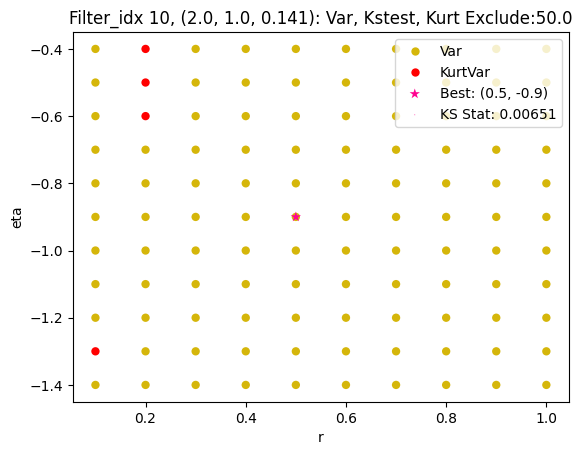

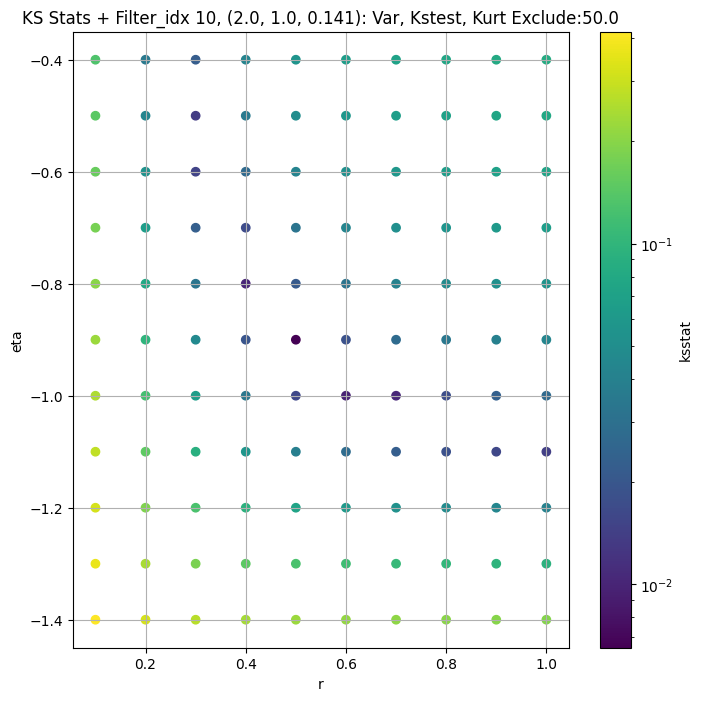

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.018132164057774625 996.8963


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.018130493312181084 930.745


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.018131335102255952 892.34283


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.018130961867202644 833.2825
Number of samples: 100000, Without approximation : 2359296.0


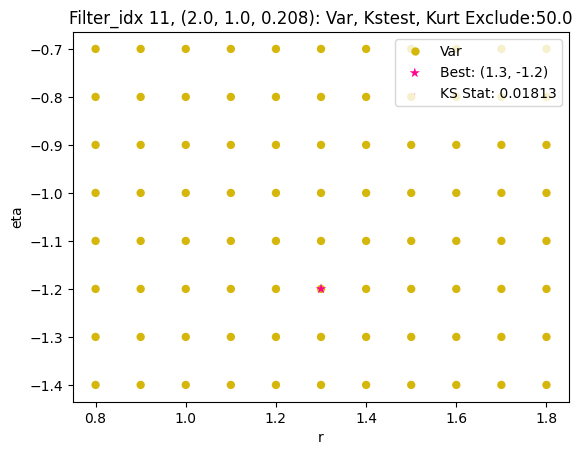

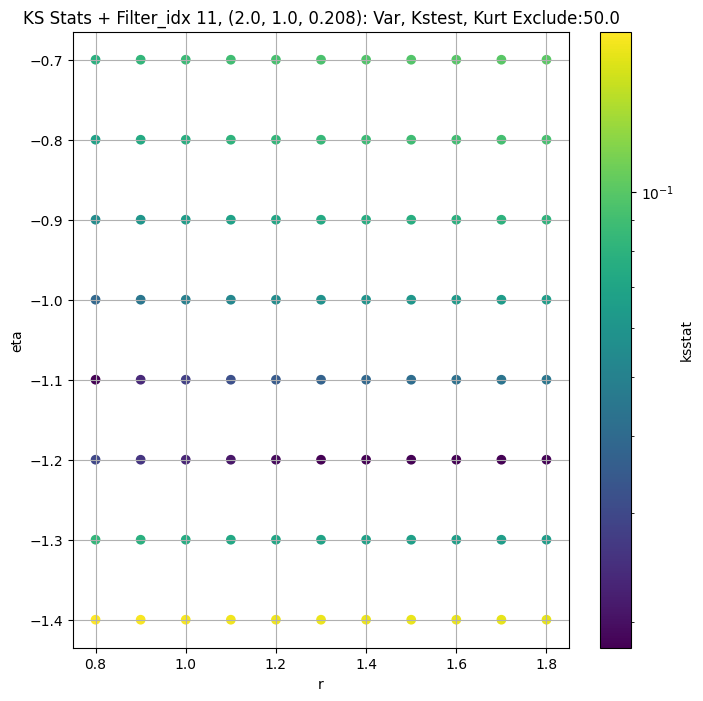

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.007350071532956748 305.44904


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.009071158940185314 280.28467


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.008310813881311718 268.57742


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.009518568330816712 252.34325
Number of samples: 100000, Without approximation : 2359296.0


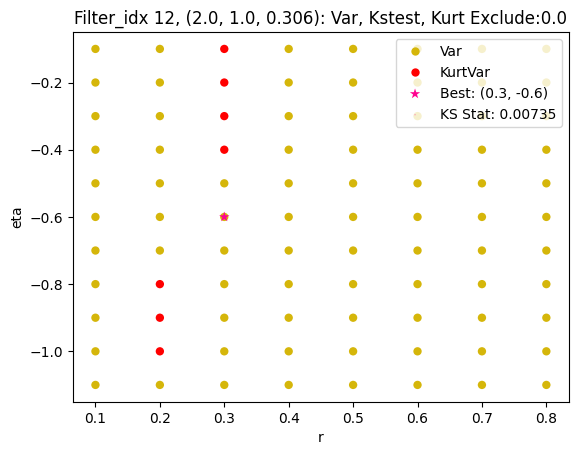

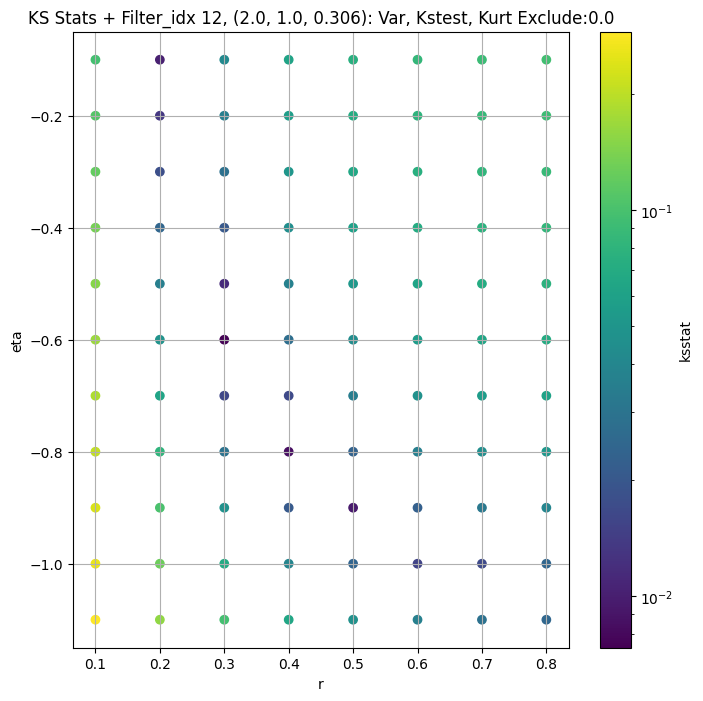

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.01966897893203534 83.43419


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.019631024328067737 67.756935


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.01962655006222397 60.685406


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.019634546796840735 53.48259
Number of samples: 100000, Without approximation : 2359296.0


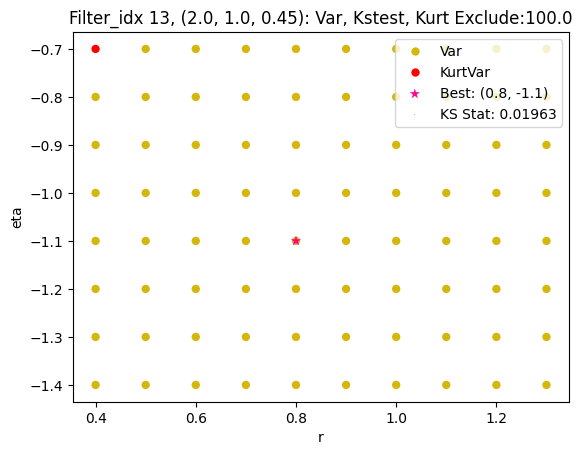

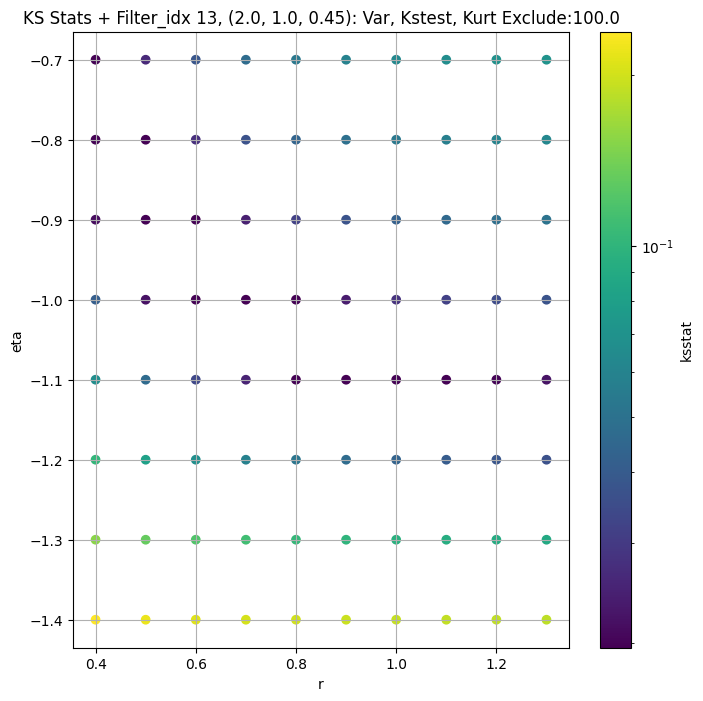

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.0023797749806095947 28972.158


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.0027911187834587237 27895.6


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.004222889029906283 27077.854


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.004931403273224753 25788.92
Number of samples: 100000, Without approximation : 2359296.0


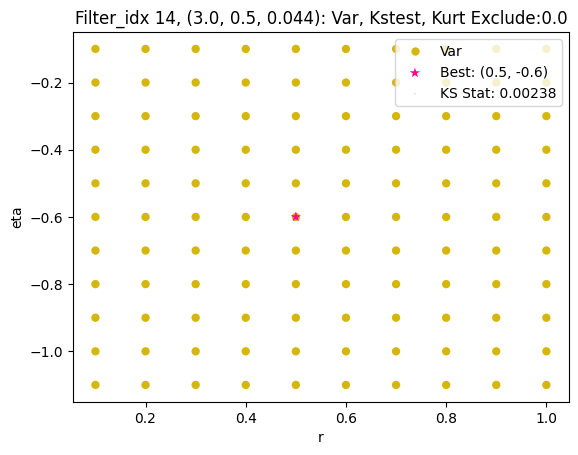

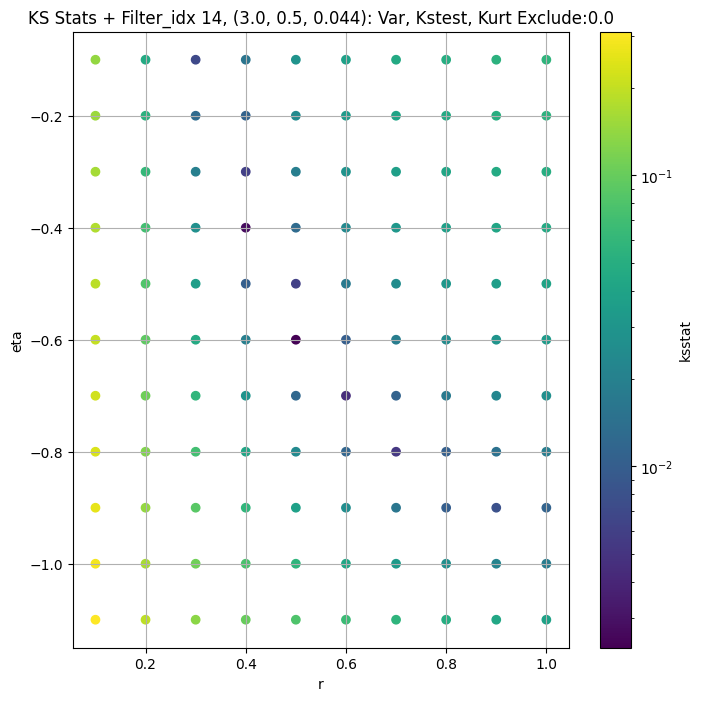

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.011933398776135085 11871.661


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.011914417974994485 11363.005


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.011899971789279984 10997.242


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.011875644752695702 10419.614
Number of samples: 100000, Without approximation : 2359296.0


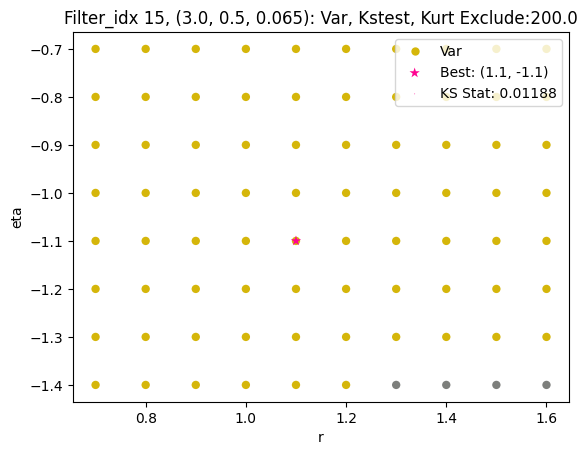

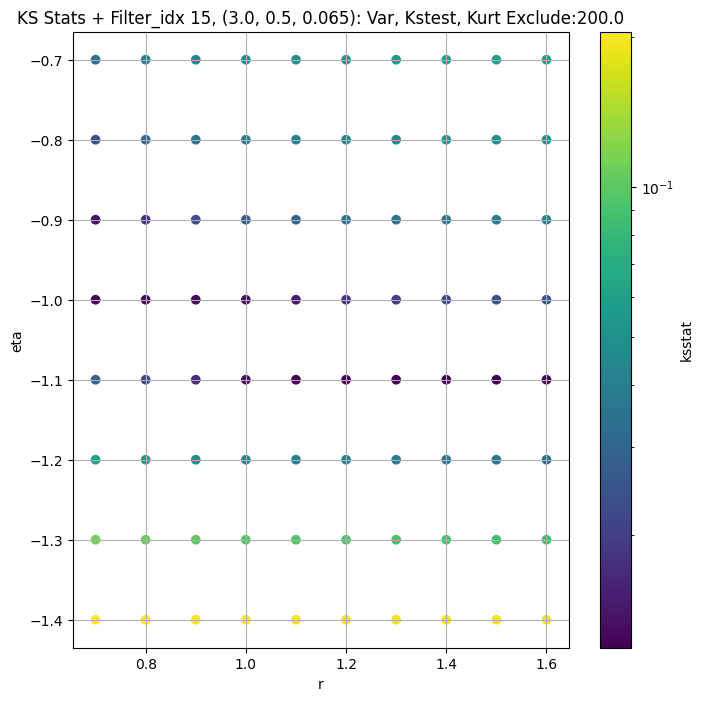

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.0073327619421492685 4800.171


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.007369061540868402 4554.4775


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.009490835561139166 4391.25


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.008196740188182394 4137.3276
Number of samples: 100000, Without approximation : 2359296.0


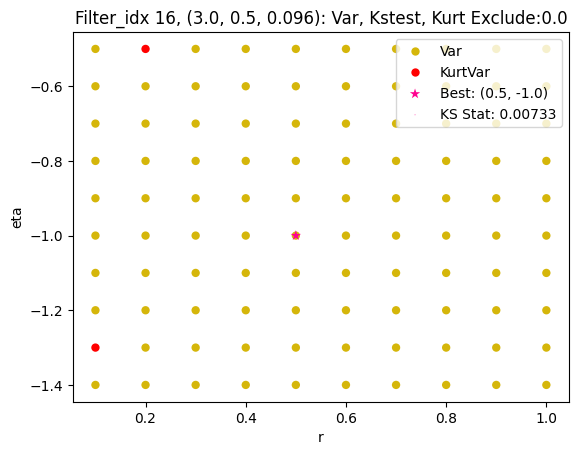

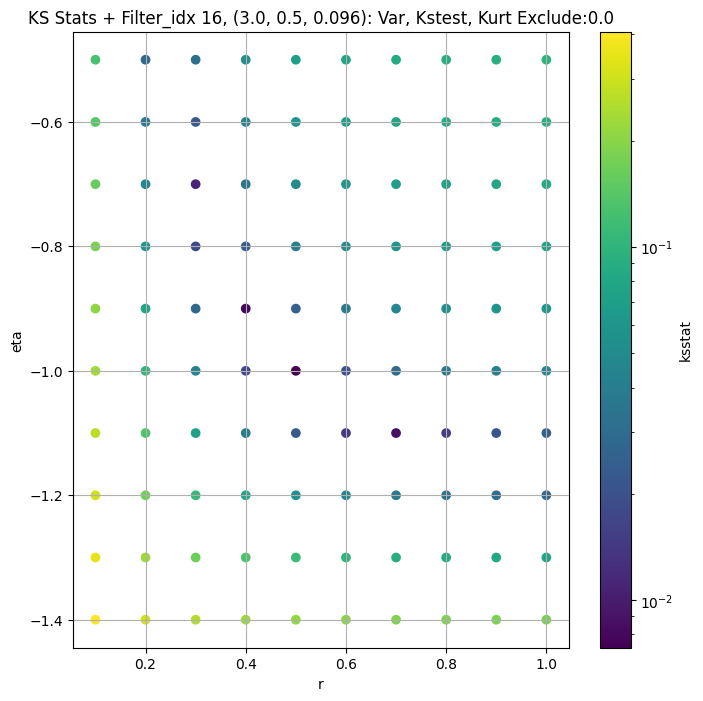

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.023720744230604995 1633.9363


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.0237188864078422 1536.1036


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.02371755460032582 1471.279


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.02373421381457047 1375.387
Number of samples: 100000, Without approximation : 2359296.0


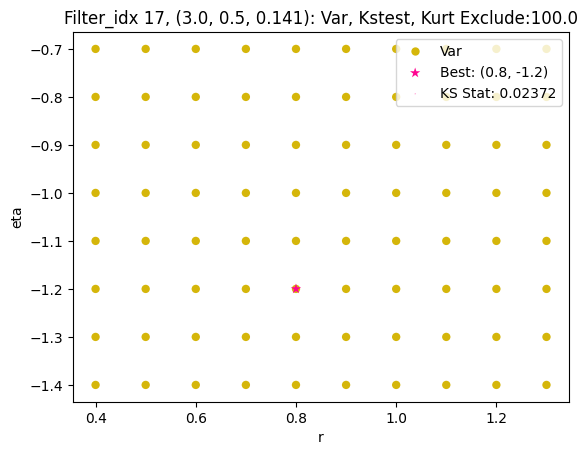

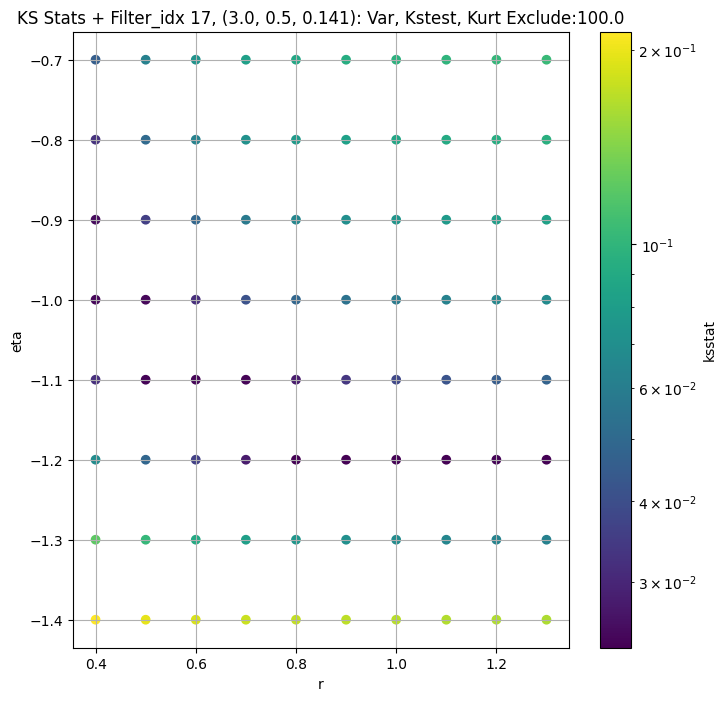

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.008953241012400082 721.1616


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.010430962763846197 685.1686


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.011969663811081444 662.4167


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.011012101171004152 625.5776
Number of samples: 100000, Without approximation : 2359296.0


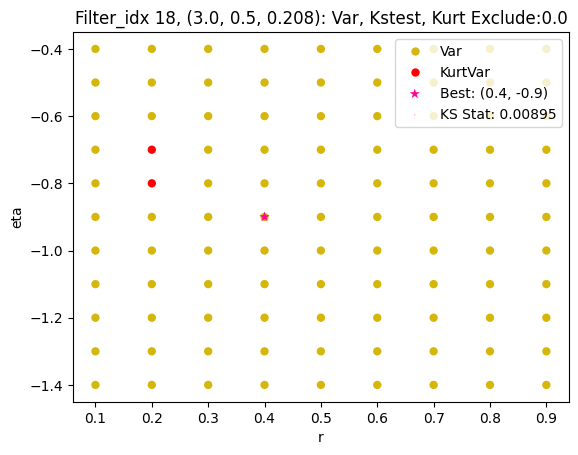

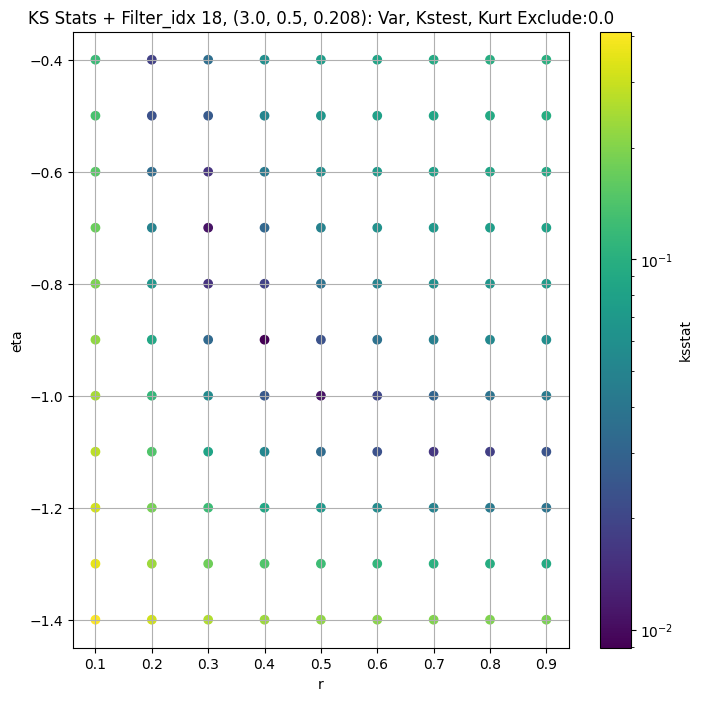

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.009506526997150155 220.14052


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.00944637011808419 205.76038


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.00944585042950108 196.99988


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.009475420336671259 184.3141
Number of samples: 100000, Without approximation : 2359296.0


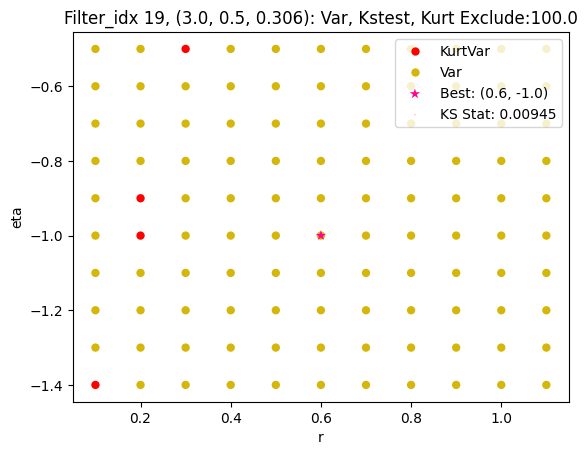

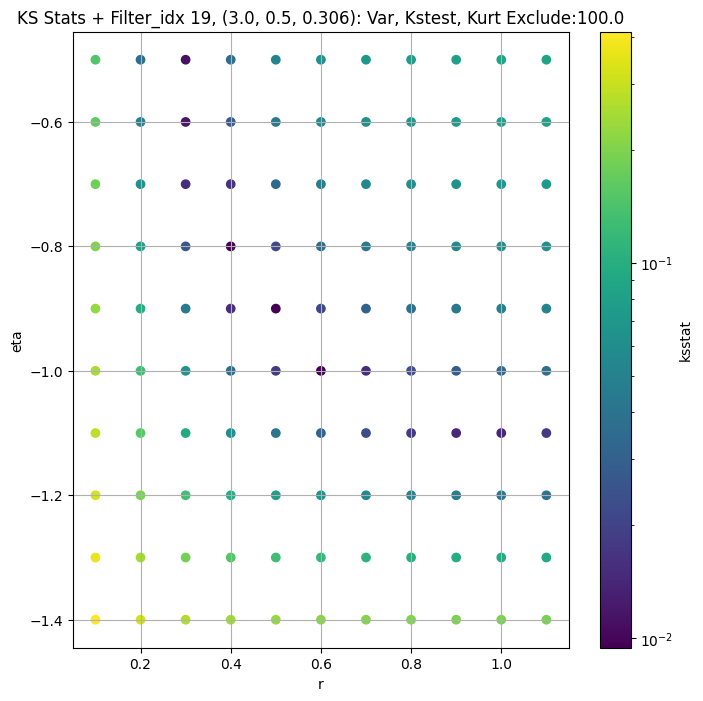

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.008557892611610607 65.82343


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.008962782812346831 57.418335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.008251841947854666 52.303448


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.009262098125559337 46.518764
Number of samples: 100000, Without approximation : 2359296.0


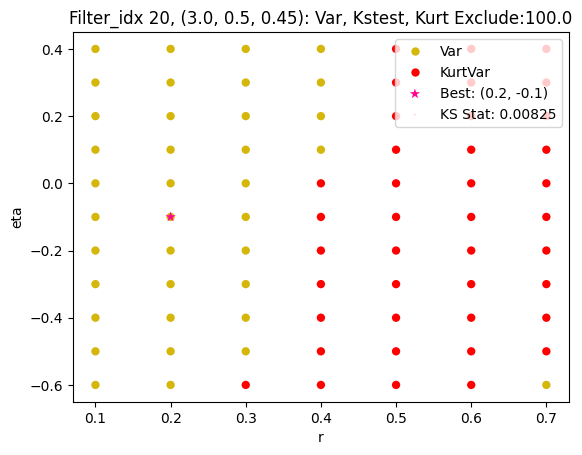

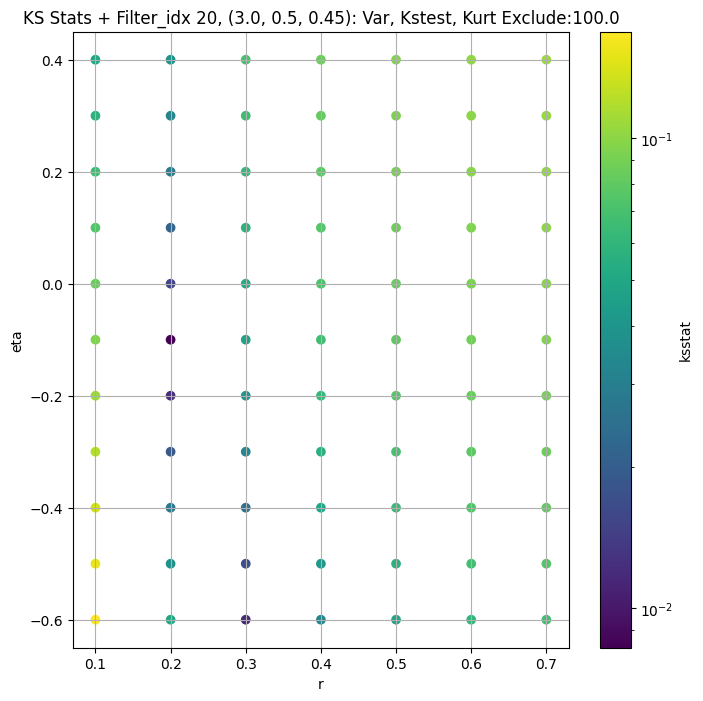

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.00667584251673059 44780.305


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.006608825113533889 42325.562


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.006769952162928139 40802.46


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.00668038756559769 38446.176
Number of samples: 100000, Without approximation : 2359296.0


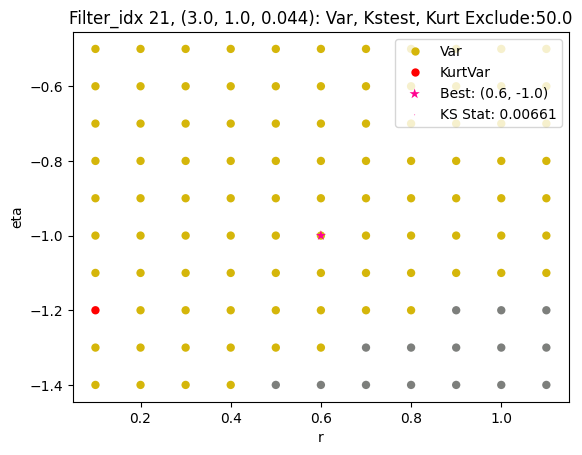

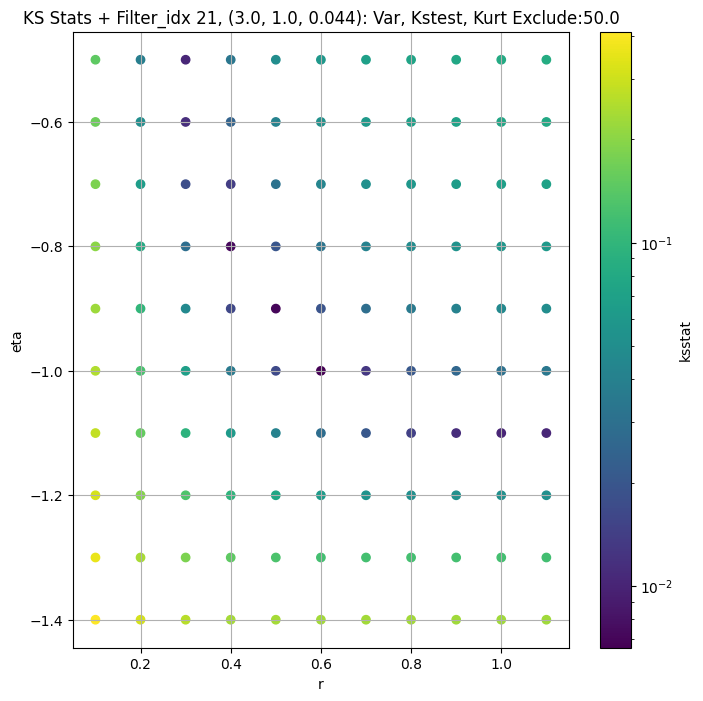

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.004335446744571536 14435.065


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.005588185174690619 13689.787


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.006274435520191912 13149.549


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.00885483454162328 12294.274
Number of samples: 100000, Without approximation : 2359296.0


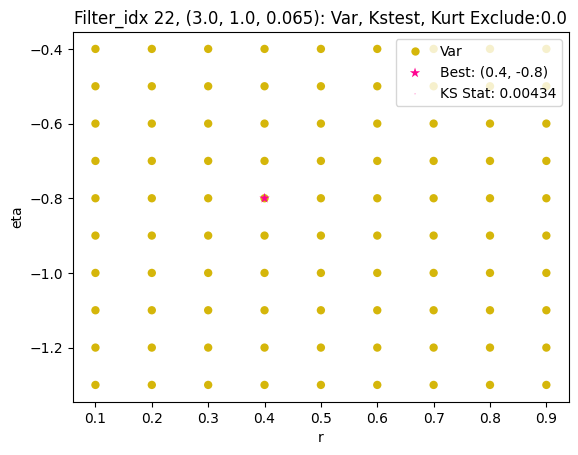

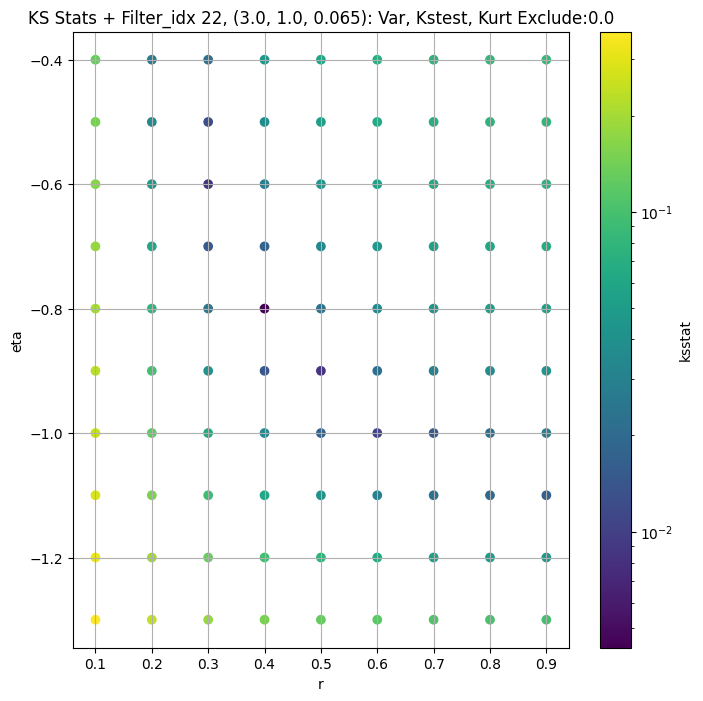

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.009948323148728622 5968.863


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.01212314434977202 5536.8945


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.010776036495293406 5242.3833


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.013084097591325894 4843.3926
Number of samples: 100000, Without approximation : 2359296.0


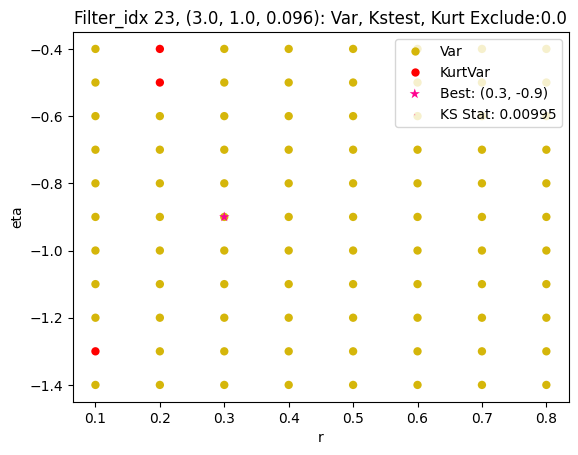

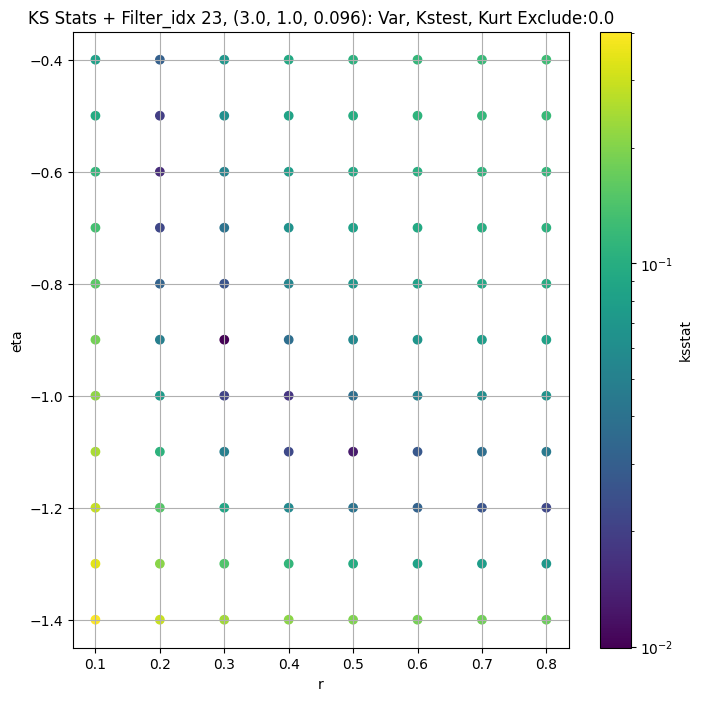

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.009752145001713453 2101.808


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.013600020271921753 1913.5939


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.012191009208349868 1795.6243


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.01130902577378562 1630.8038
Number of samples: 100000, Without approximation : 2359296.0


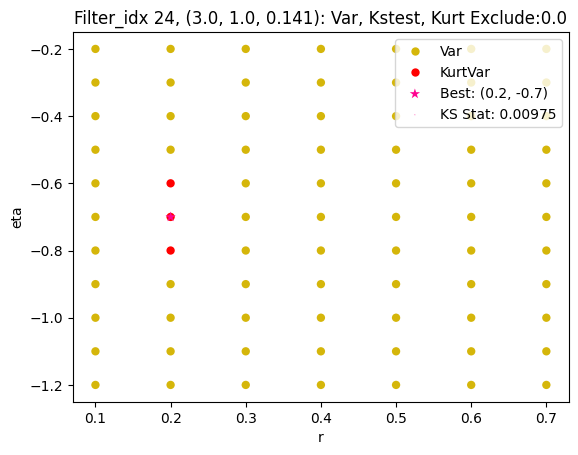

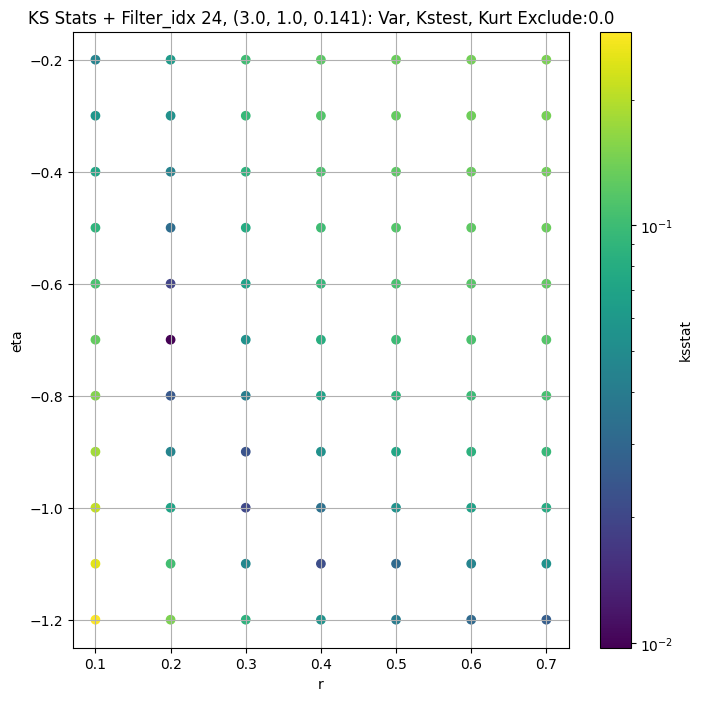

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.010354001821304748 794.82135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.011234276453093092 723.8036


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.01362133396168852 685.62646


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.0114398227605359 633.67645
Number of samples: 100000, Without approximation : 2359296.0


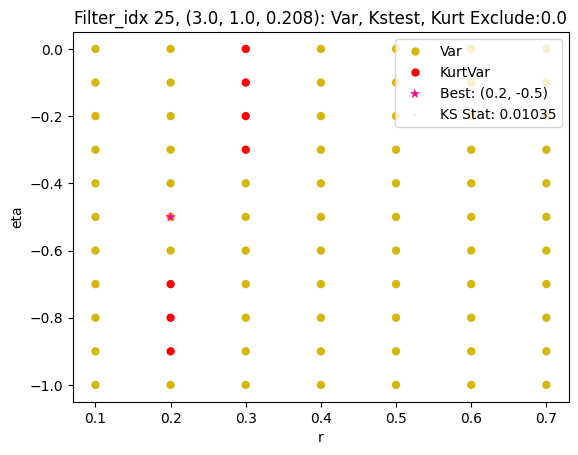

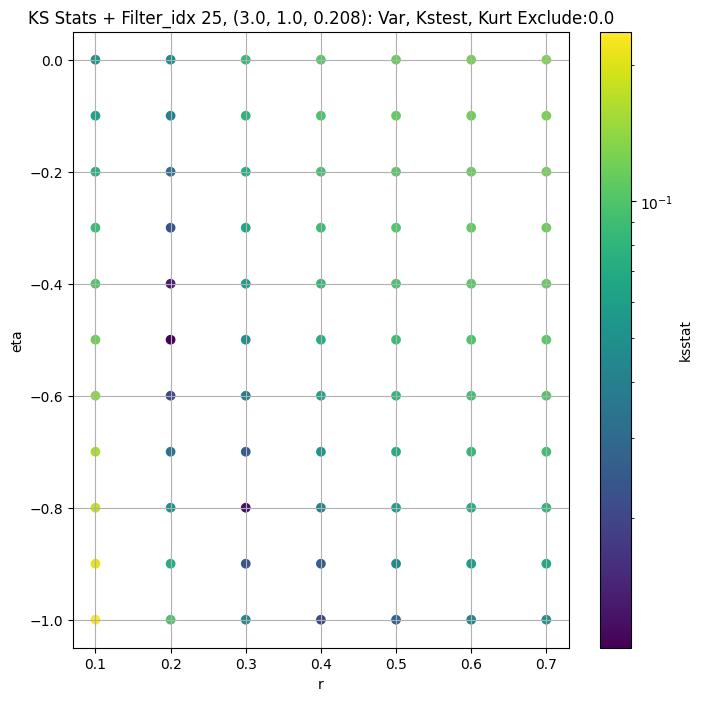

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.00915944981738881 181.34373


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.009129336986123726 153.42918


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.009181689274280869 142.51819


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.009108434814749655 128.48189
Number of samples: 100000, Without approximation : 2359296.0


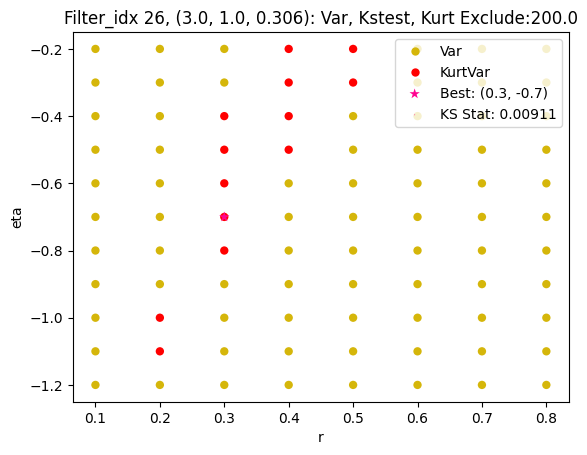

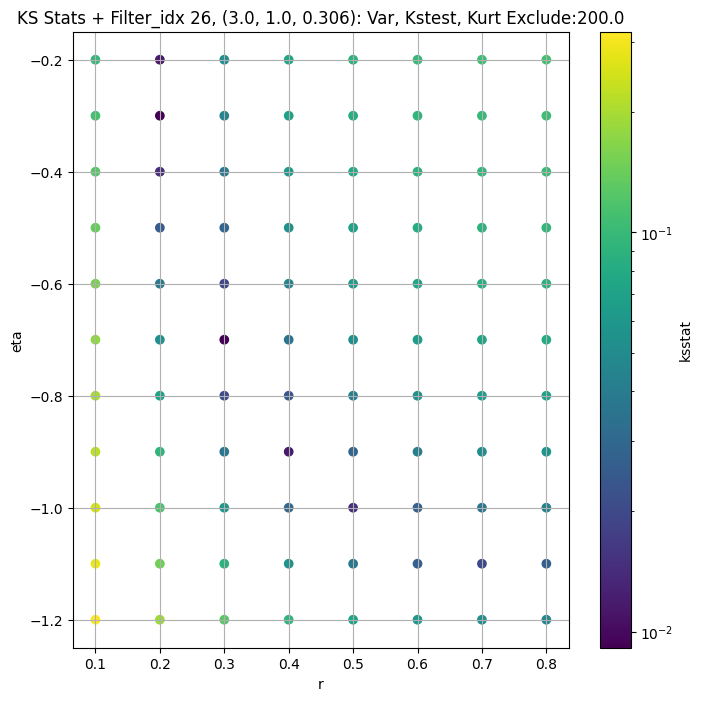

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.008960608114268687 79.18611


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.007567824977095294 67.91387


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.00790123741036302 63.609234


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.008266509723489412 58.35007
Number of samples: 100000, Without approximation : 2359296.0


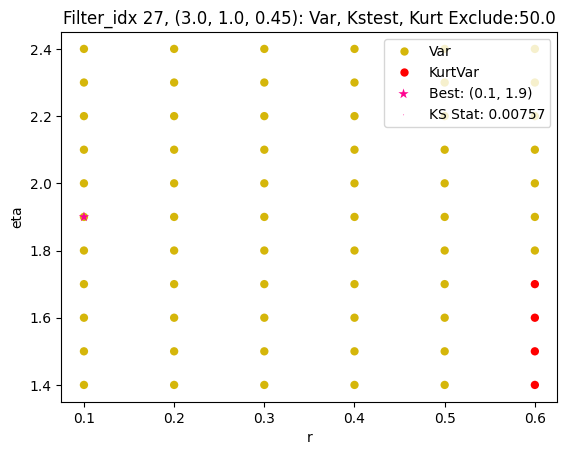

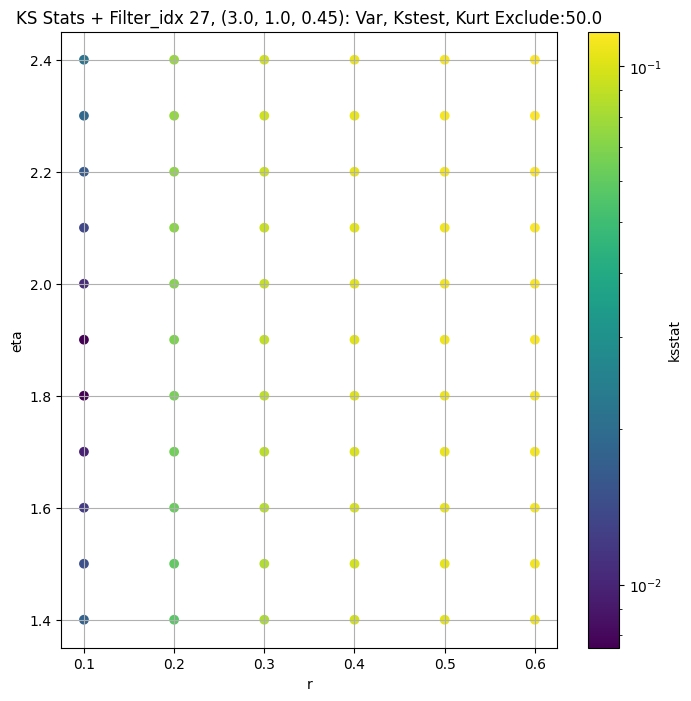

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.00377060739427193 32999.508


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.0038985919860853313 31633.64


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.0044670489852313144 30685.174


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.004928341840592654 29174.795
Number of samples: 100000, Without approximation : 2359296.0


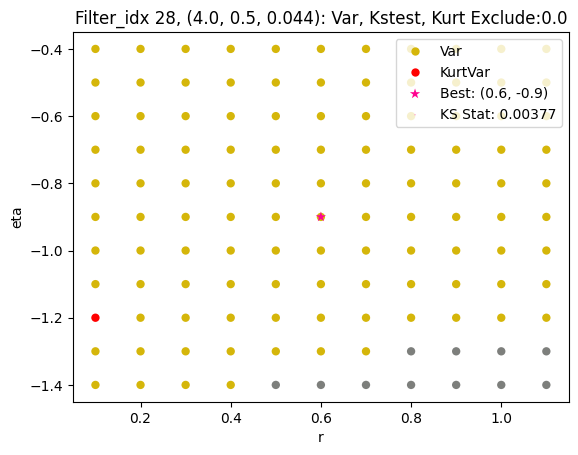

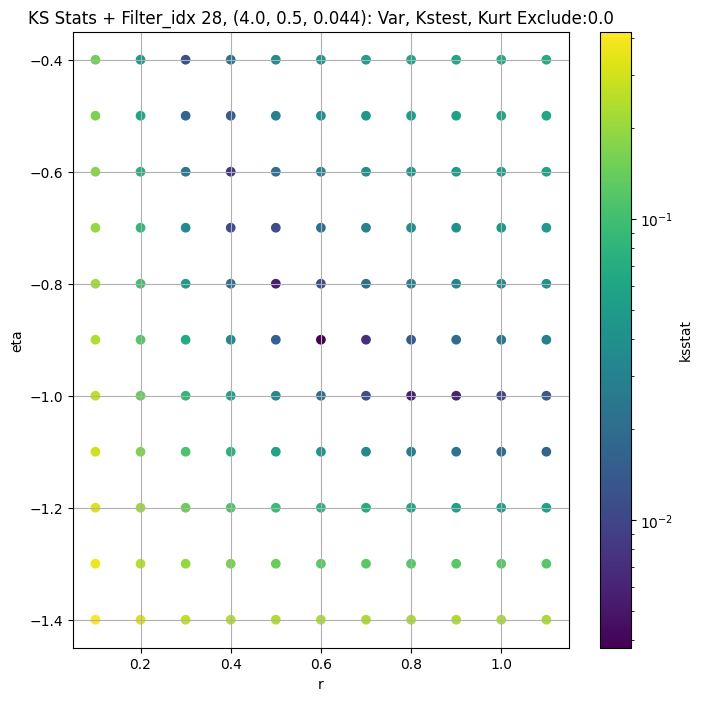

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.007034924628011141 11413.85


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.007703069997651801 10936.03


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.00781132835434456 10608.053


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.006957310289599672 10071.444
Number of samples: 100000, Without approximation : 2359296.0


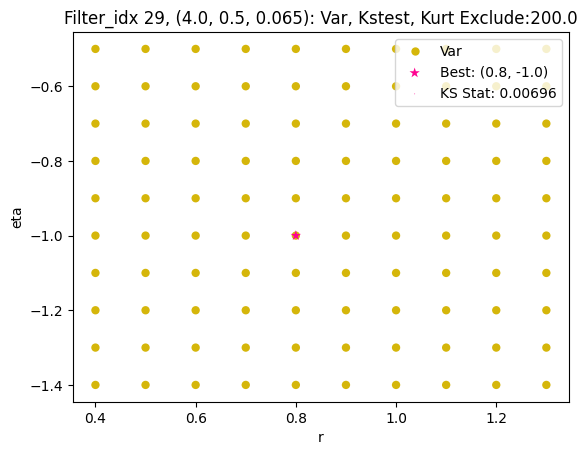

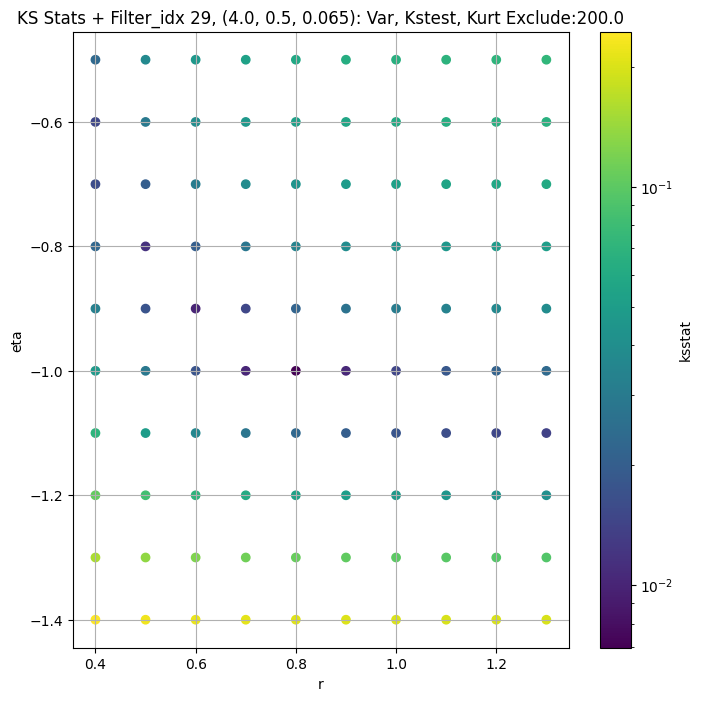

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.013016552086828725 4582.912


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.010162373701367633 4358.454


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.011100842976571768 4214.889


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.013914529298447498 3993.704
Number of samples: 100000, Without approximation : 2359296.0


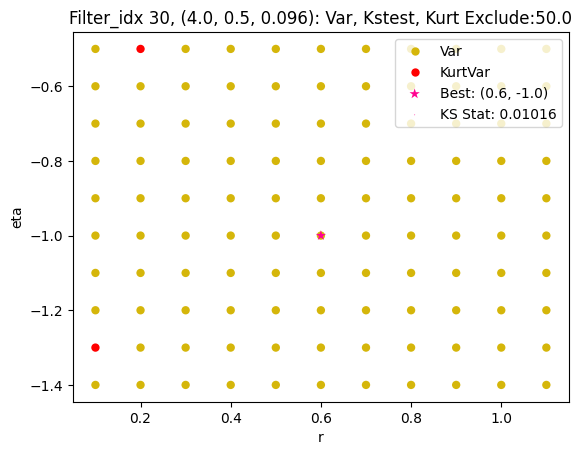

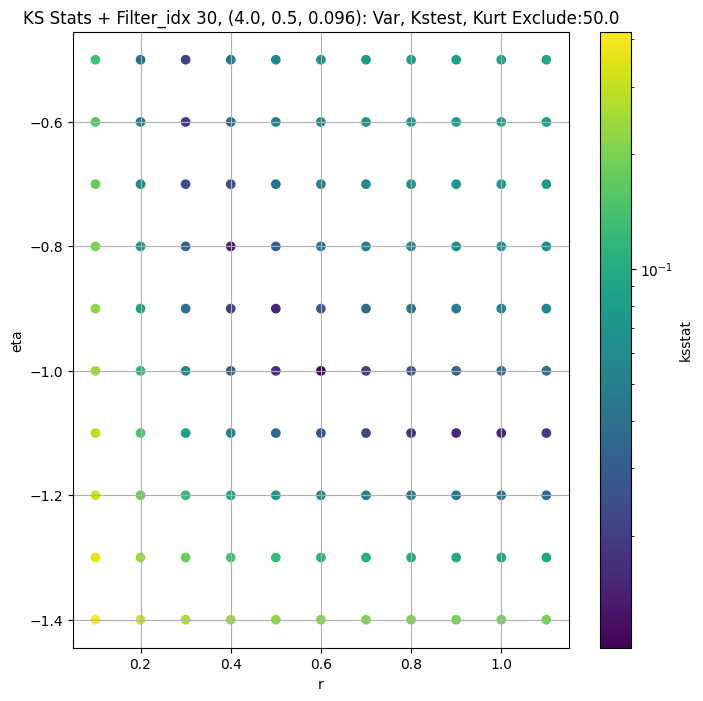

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.014952002658604968 1618.3718


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.014977049320404612 1501.6348


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.014973264102734918 1437.9961


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.01496785206854545 1343.4241
Number of samples: 100000, Without approximation : 2359296.0


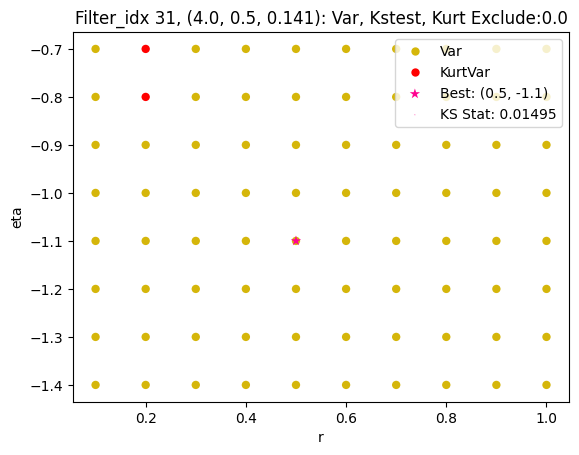

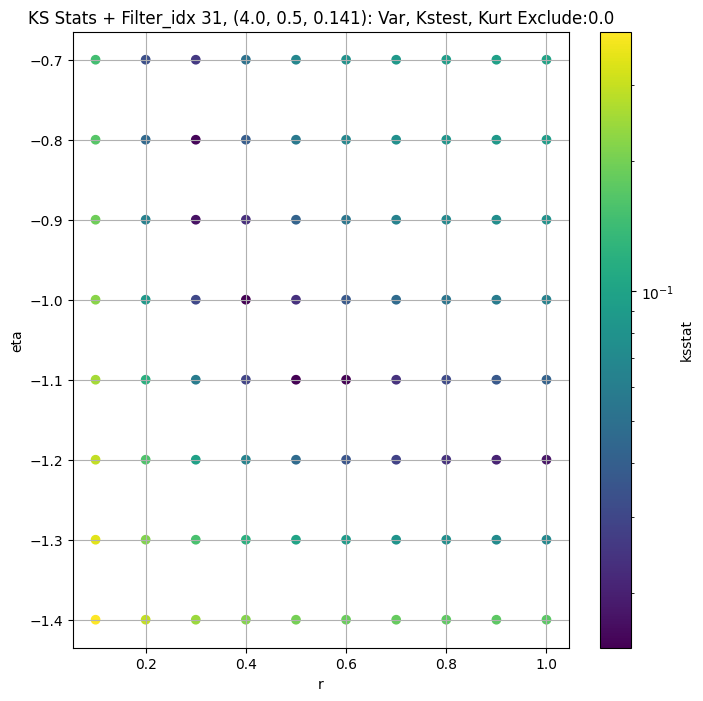

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.016994076158644122 574.25934


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.01690731051576655 533.2574


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.01689355768695866 509.28693


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.016878095184056863 473.01553
Number of samples: 100000, Without approximation : 2359296.0


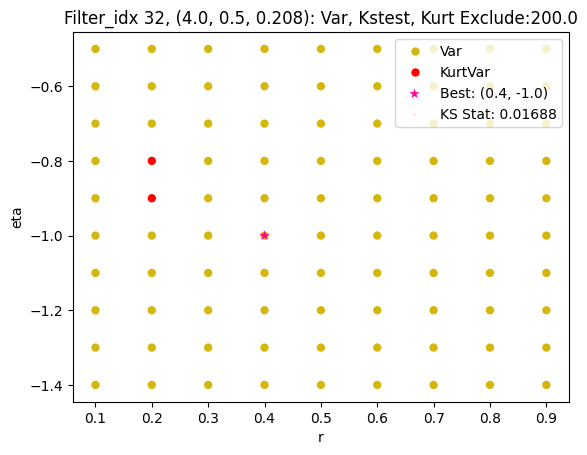

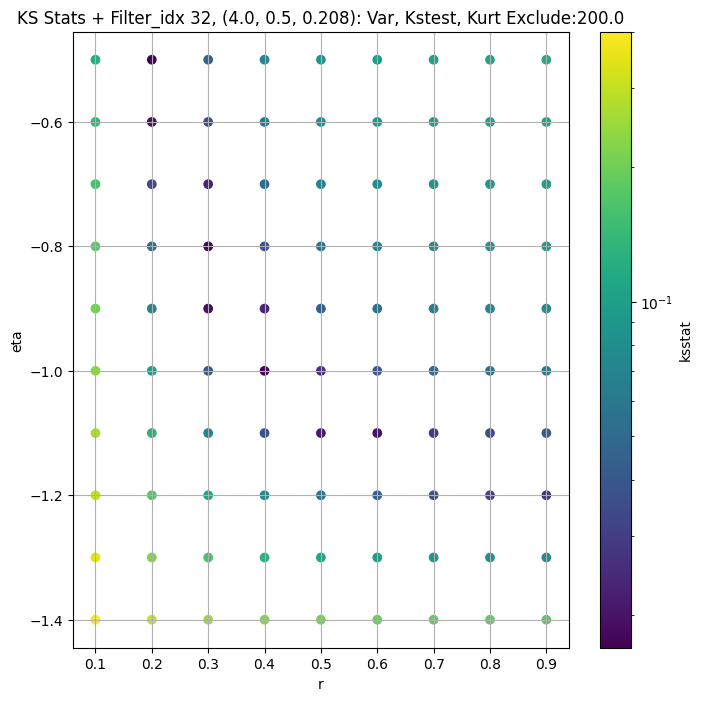

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.018112952975634866 168.57628


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.018108798563806427 153.56776


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.01810633484885027 145.59511


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.018102206030327195 133.56041
Number of samples: 100000, Without approximation : 2359296.0


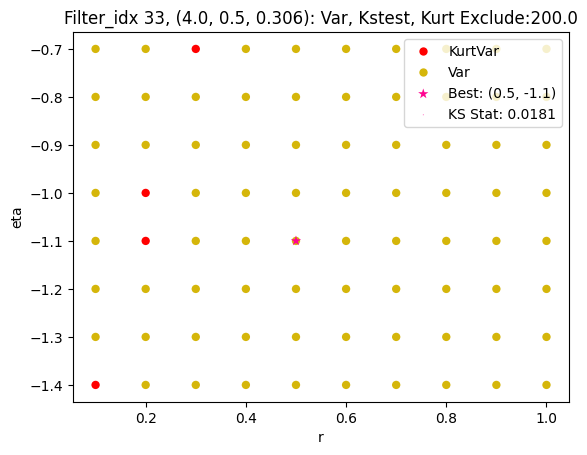

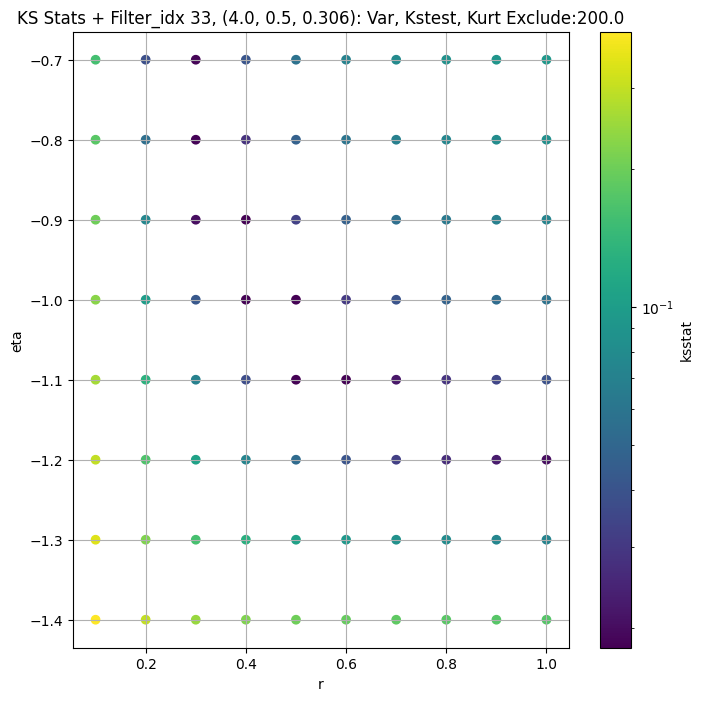

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.02889618313237141 63.26655


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.028877547430375128 54.502064


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.02886763989524771 50.136494


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.028893031141131398 44.830593
Number of samples: 100000, Without approximation : 2359296.0


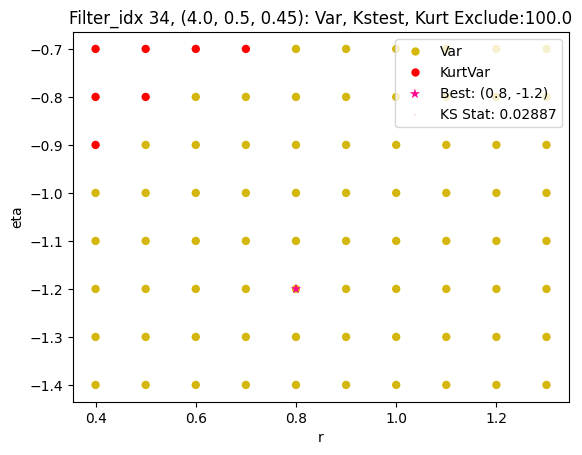

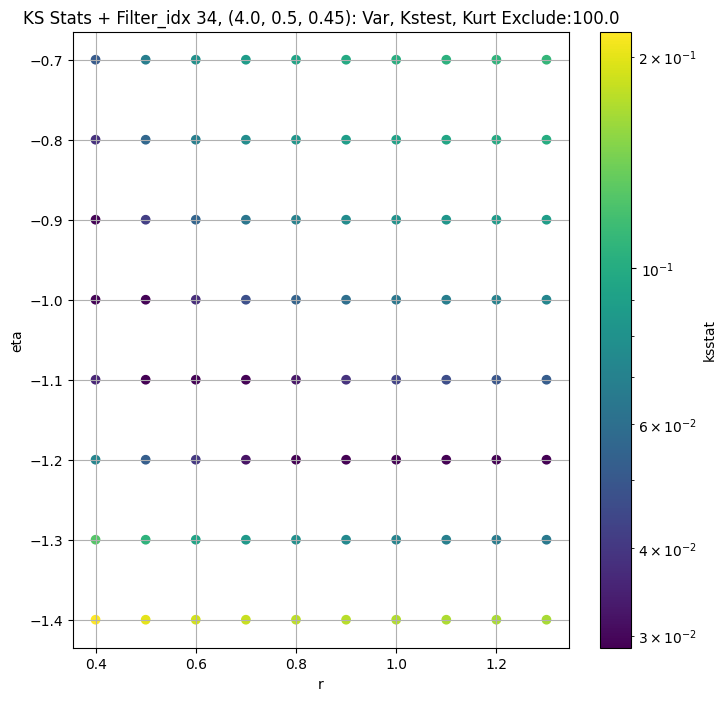

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.008345691802149724 40600.367


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.008207935876492434 37709.92


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.007353789859596671 35670.203


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.007273914037379536 32438.574
Number of samples: 100000, Without approximation : 2359296.0


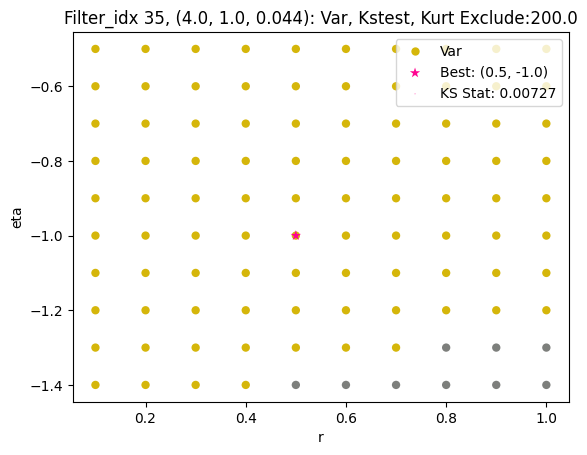

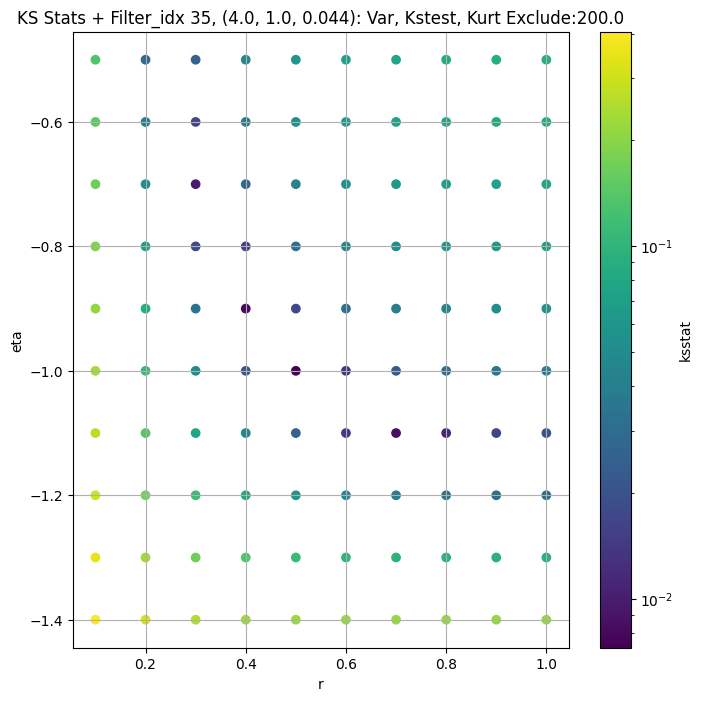

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.004693213494518456 14875.311


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.0024492588425185646 14070.894


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.004362140997743291 13548.77


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.0036678990483426377 12736.972
Number of samples: 100000, Without approximation : 2359296.0


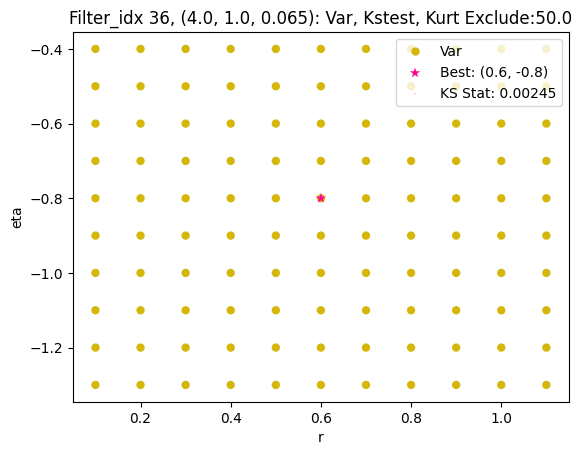

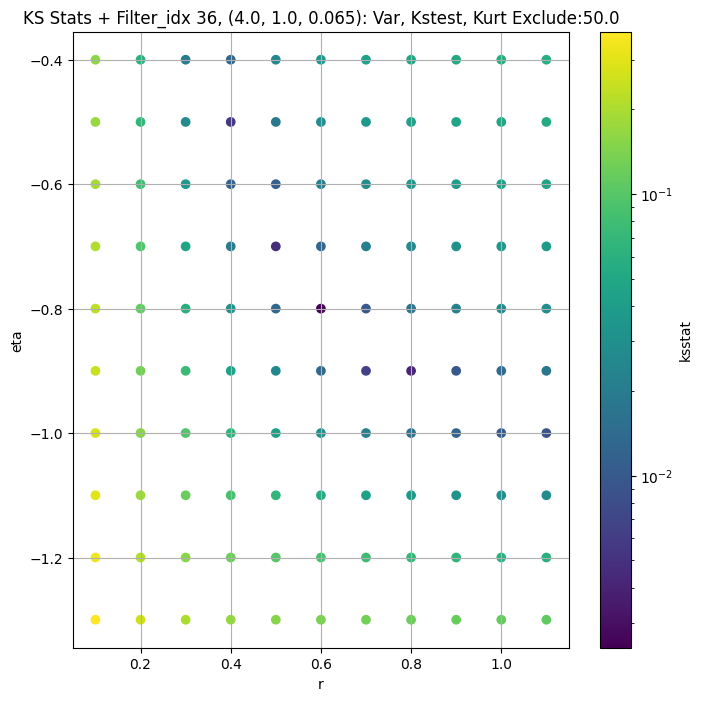

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.005820285350823018 4569.4595


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.004649622649509522 4280.6846


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.005257832105960536 4097.194


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.006360310591661089 3826.3113
Number of samples: 100000, Without approximation : 2359296.0


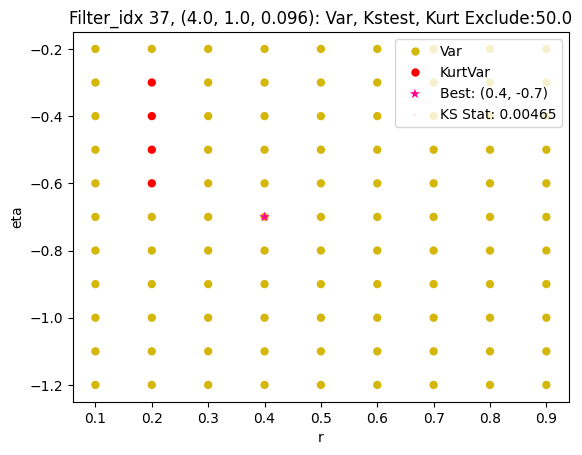

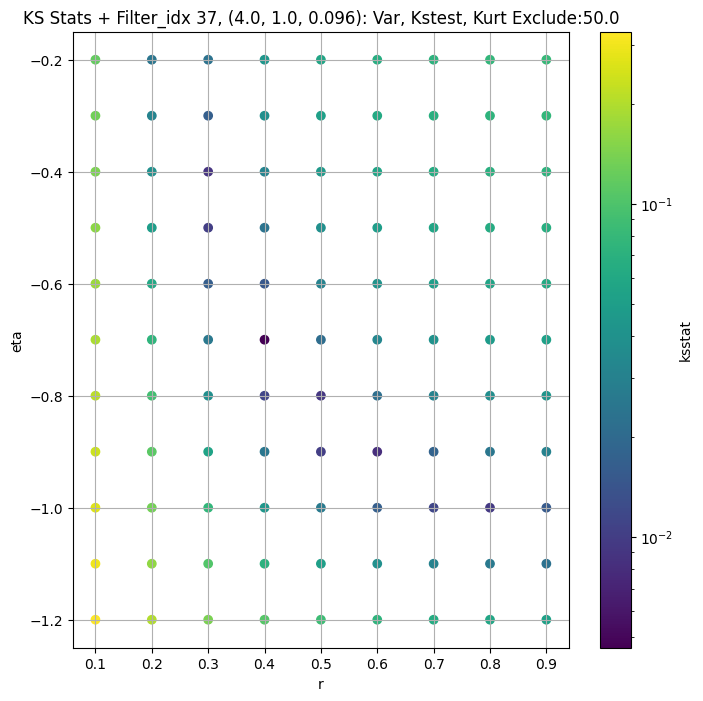

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.013396275626498366 1789.6858


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.013331122719608235 1636.9137


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.01331126583120723 1554.365


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.013378879680430944 1438.0098
Number of samples: 100000, Without approximation : 2359296.0


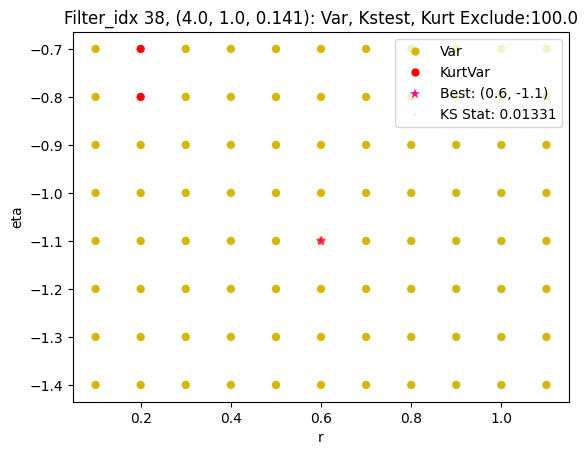

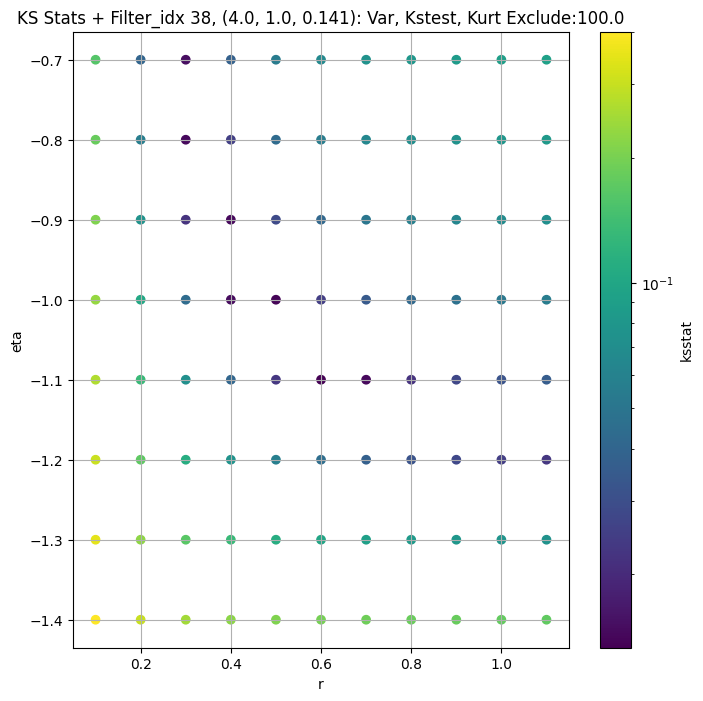

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.009200388004725779 647.68274


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.008751236841928134 576.70514


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.008740844439040996 539.8493


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.011010853587949732 488.52304
Number of samples: 100000, Without approximation : 2359296.0


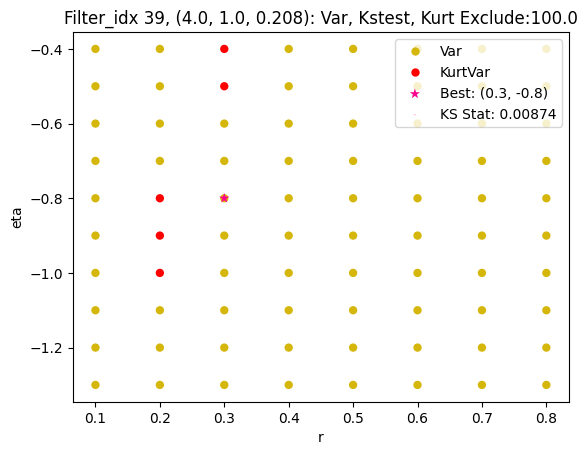

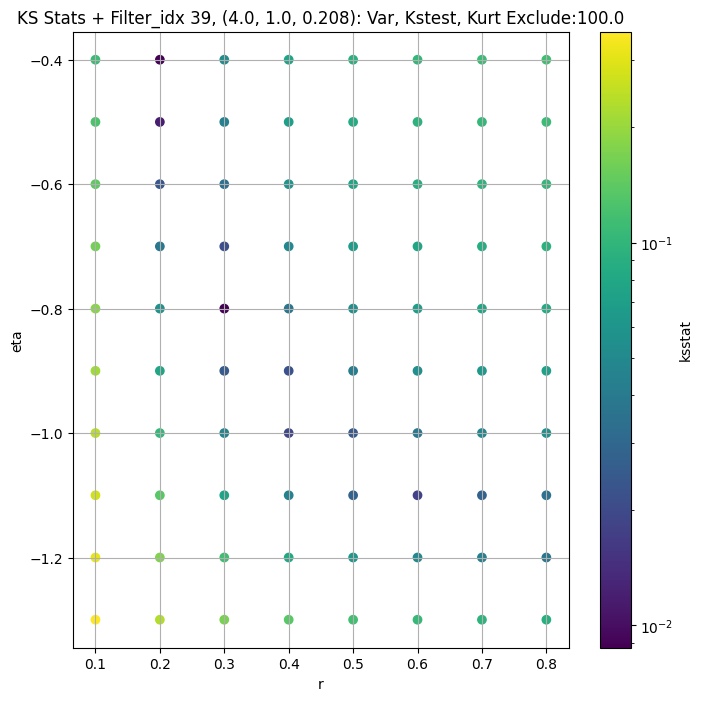

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.017738983126049823 243.3492


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.0177242187076303 208.02855


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.01772114387895296 193.87988


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.017701081806249575 177.3588
Number of samples: 100000, Without approximation : 2359296.0


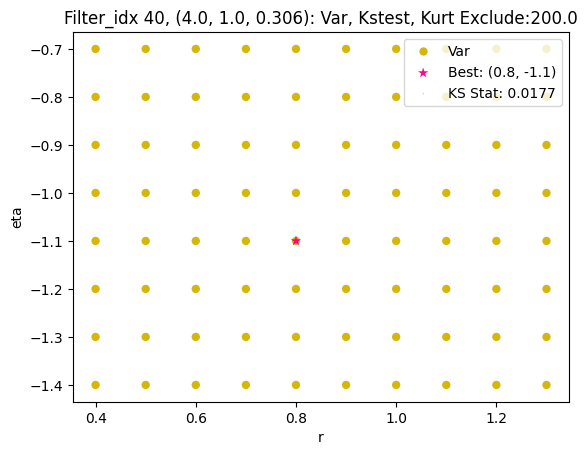

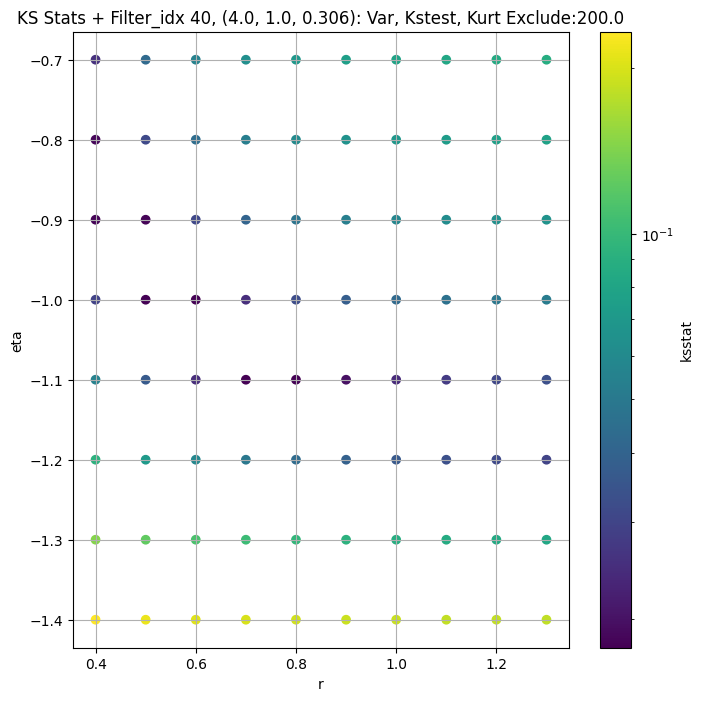

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.009705712111032994 58.184


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.00969861412597095 42.42424


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.009655596954877 37.066742


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.009574207273482238 31.776396
Number of samples: 100000, Without approximation : 2359296.0


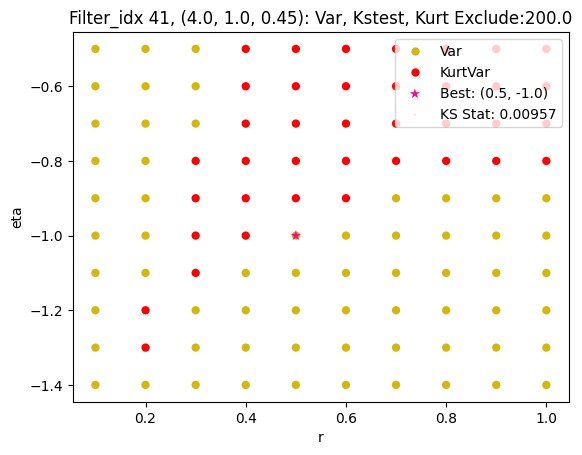

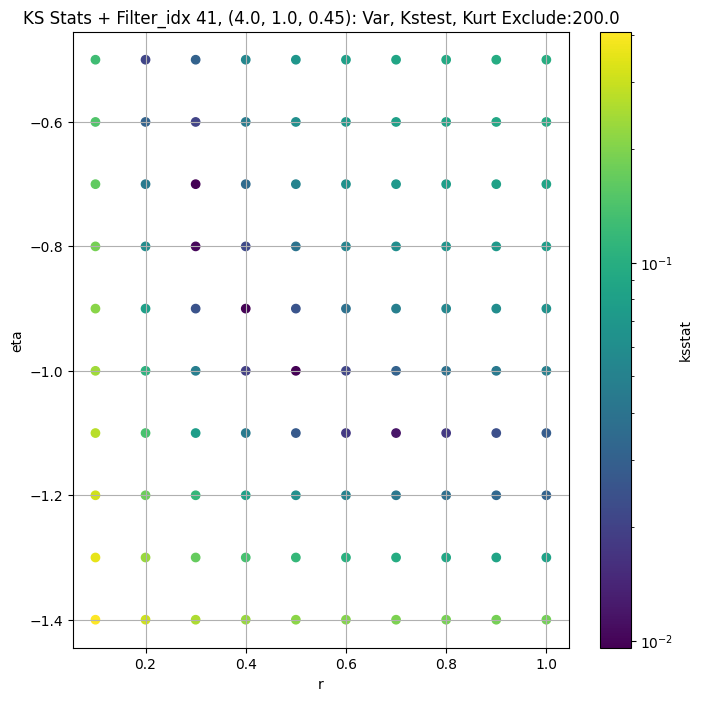

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",38922.66400,30951.148000,47092.977000,4.409872,2.737330,7.668057,2359296.0,"(2.0, 0.5, 0.044)",0.008644,0.8,-1.0,5.683329e+04,50.0,37773.965000,0.000884
1,"(2.0, 0.5, 0.065)",13811.33800,10857.232000,17411.840000,5.708673,3.505895,10.191732,2359296.0,"(2.0, 0.5, 0.065)",0.009054,0.6,-1.0,1.172767e+04,0.0,13811.338000,0.000884
2,"(2.0, 0.5, 0.096)",5212.11130,4147.616000,6494.641000,5.850252,3.246446,9.314557,2359296.0,"(2.0, 0.5, 0.096)",0.006735,0.7,-1.0,6.220927e+03,0.0,5212.111300,0.000884
3,"(2.0, 0.5, 0.141)",1797.79000,1354.278400,2296.739300,9.139929,5.153275,16.219257,2359296.0,"(2.0, 0.5, 0.141)",0.017808,1.4,-1.2,6.314137e+03,200.0,1548.520800,0.000884
4,"(2.0, 0.5, 0.208)",583.18730,428.792420,749.157100,10.078462,5.642832,22.572874,2359296.0,"(2.0, 0.5, 0.208)",0.009929,0.2,-0.3,1.928529e-02,0.0,583.187300,0.000884
5,"(2.0, 0.5, 0.306)",181.50945,127.899025,248.526540,15.314480,5.525773,54.680214,2359296.0,"(2.0, 0.5, 0.306)",0.010090,0.5,-1.0,7.908279e+01,100.0,158.165590,0.000884
6,"(2.0, 0.5, 0.45)",111.37292,80.555720,156.800570,14.459356,5.156713,57.622300,2359296.0,"(2.0, 0.5, 0.45)",0.004955,0.3,-0.5,7.330189e-01,50.0,102.647120,0.000884
7,"(2.0, 1.0, 0.044)",52155.28000,40917.543000,66751.110000,7.146744,4.161360,11.858514,2359296.0,"(2.0, 1.0, 0.044)",0.004159,0.7,-1.0,5.965013e+04,50.0,49976.973000,0.000884
8,"(2.0, 1.0, 0.065)",19633.50200,15193.773000,24351.654000,6.894701,3.830083,11.340195,2359296.0,"(2.0, 1.0, 0.065)",0.006090,1.3,-1.1,5.237068e+04,200.0,17277.875000,0.000884


In [17]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [18]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 100 = 150, ksstat: 0.006211611540975159, var: 36163.62109375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 75 = 125, ksstat: 0.005702680332022182, var: 36539.4140625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 50 = 100, ksstat: 0.00569618484363088, var: 36928.3984375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 25 = 75, ksstat: 0.005491196336989232, var: 37338.24609375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 0 = 50, ksstat: 0.005212420902658055, var: 37773.96484375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + -25 = 25, ksstat: 0.00521449786144268, var: 38257.74609375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + -50 = 0, ksstat: 0.005216080226727482, var: 38922.6640625
Number of samples: 100000, Without approximation : 2359296.0


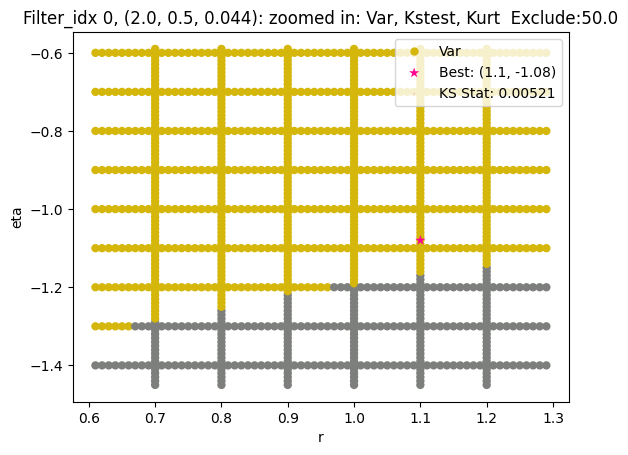

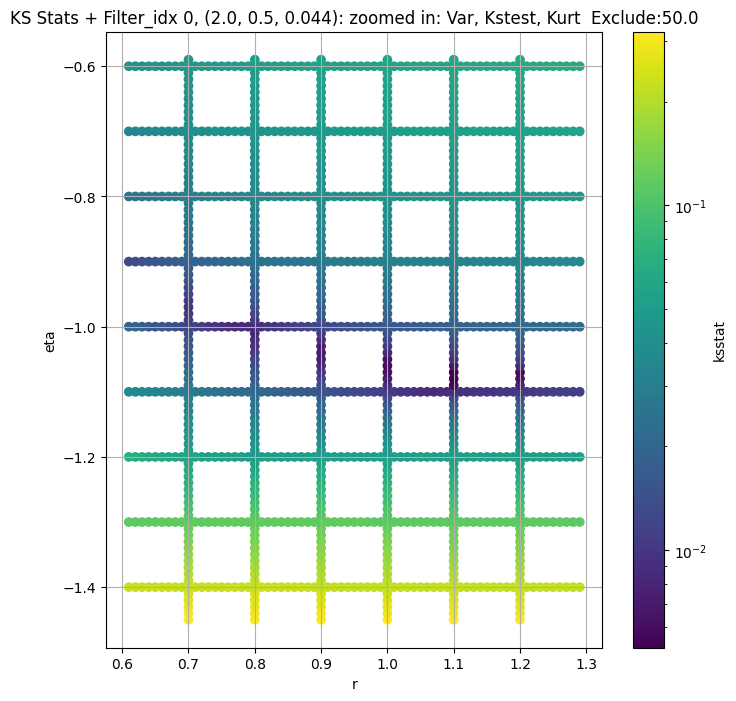

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 1, 0.0 + 100 = 100, ksstat: 0.007936328343105703, var: 12965.4765625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 1, 0.0 + 75 = 75, ksstat: 0.008194173252436765, var: 13131.990234375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 1, 0.0 + 50 = 50, ksstat: 0.007485024841577703, var: 13315.7080078125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 1, 0.0 + 25 = 25, ksstat: 0.007800966401556975, var: 13526.96484375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 1, 0.0 + 0 = 0, ksstat: 0.007160147460440469, var: 13811.337890625
Number of samples: 100000, Without approximation : 2359296.0


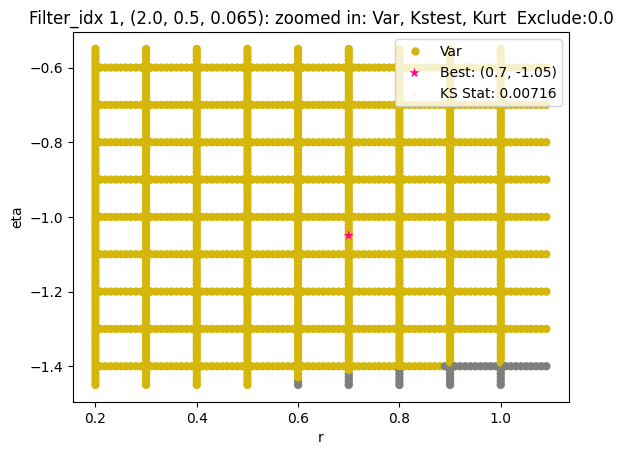

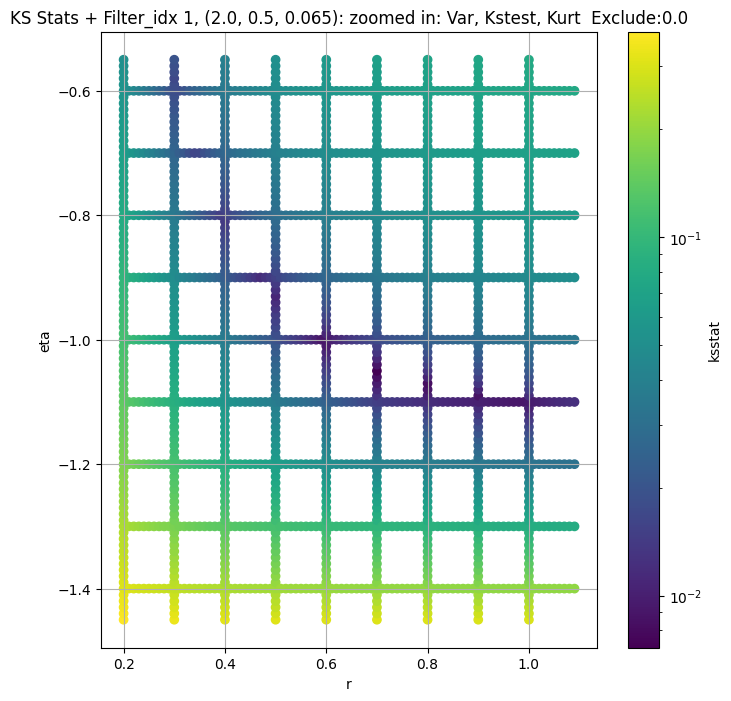

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 2, 0.0 + 100 = 100, ksstat: 0.005999501994949308, var: 4879.92529296875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 2, 0.0 + 75 = 75, ksstat: 0.006028372935429016, var: 4945.93212890625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 2, 0.0 + 50 = 50, ksstat: 0.006050069239951994, var: 5017.78466796875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 2, 0.0 + 25 = 25, ksstat: 0.005994787684147962, var: 5099.9453125


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 2, 0.0 + 0 = 0, ksstat: 0.006042286391757856, var: 5212.111328125
Number of samples: 100000, Without approximation : 2359296.0


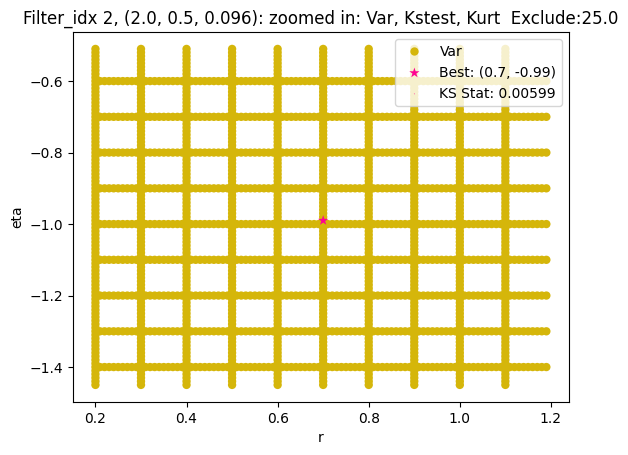

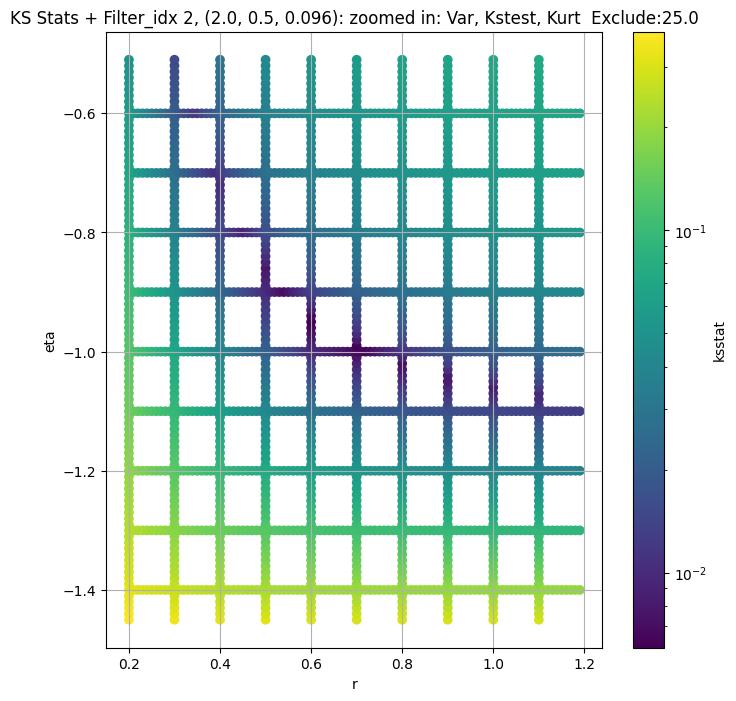

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + 100 = 300, ksstat: 0.017788751131207592, var: 1470.332275390625


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + 75 = 275, ksstat: 0.0177887980747794, var: 1488.51611328125


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + 50 = 250, ksstat: 0.01778874189386892, var: 1507.5303955078125


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + 25 = 225, ksstat: 0.017788773084493448, var: 1527.4852294921875


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + 0 = 200, ksstat: 0.01778879941488315, var: 1548.520751953125


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + -25 = 175, ksstat: 0.017788822091812817, var: 1570.8397216796875


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + -50 = 150, ksstat: 0.01778884229796951, var: 1594.6656494140625


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + -75 = 125, ksstat: 0.017788857112370382, var: 1619.9879150390625


  0%|          | 0/1380 [00:00<?, ?it/s]

Finding Minimum after computing 1380 CDFs
filter_idx 3, 200.0 + -100 = 100, ksstat: 0.017788870581355976, var: 1647.2574462890625
Number of samples: 100000, Without approximation : 2359296.0


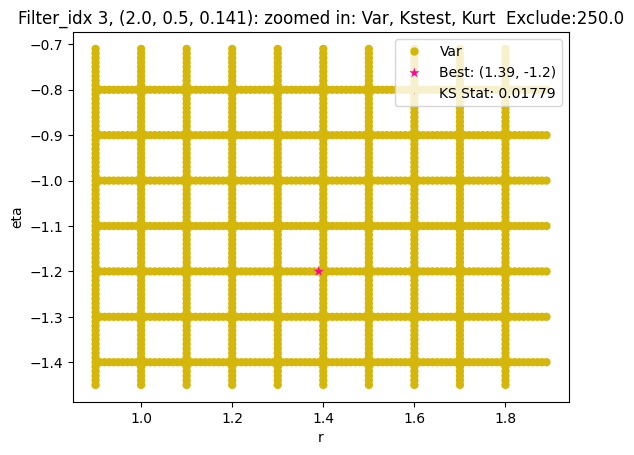

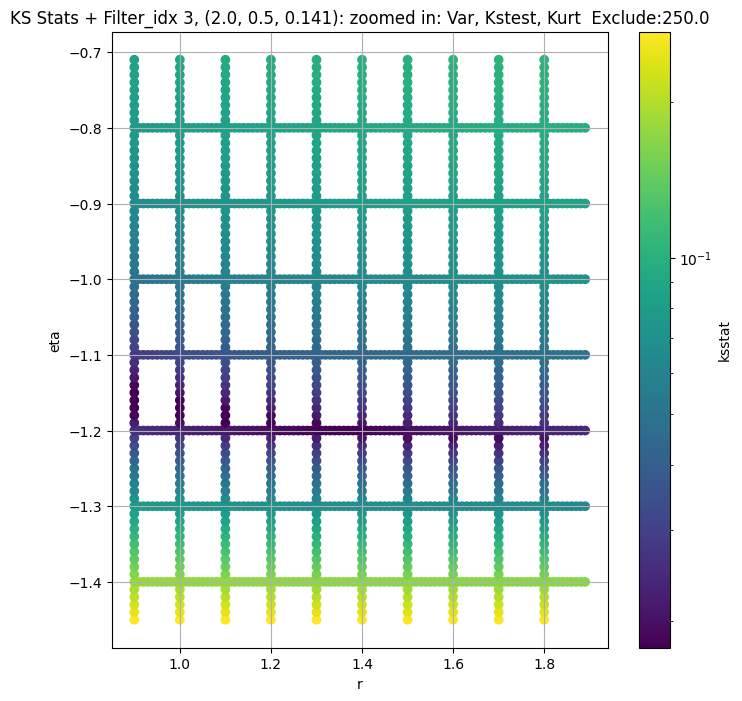

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 4, 0.0 + 100 = 100, ksstat: 0.008989689641611287, var: 530.0140380859375


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 4, 0.0 + 75 = 75, ksstat: 0.00849680163377775, var: 540.0459594726562


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 4, 0.0 + 50 = 50, ksstat: 0.008274169461169989, var: 551.4540405273438


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 4, 0.0 + 25 = 25, ksstat: 0.008409789321985328, var: 564.6456298828125


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 4, 0.0 + 0 = 0, ksstat: 0.008310189261272138, var: 583.1873168945312
Number of samples: 100000, Without approximation : 2359296.0


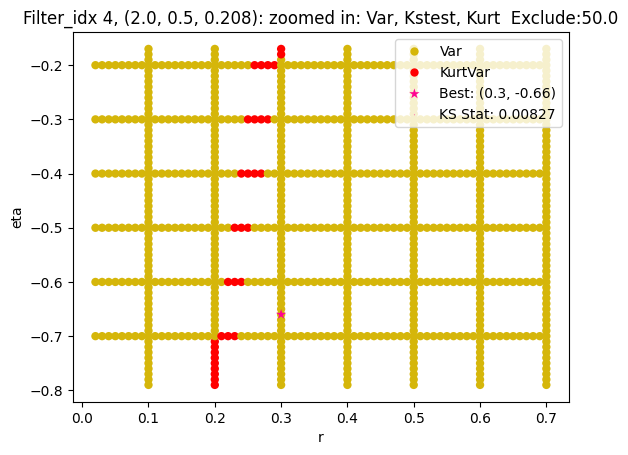

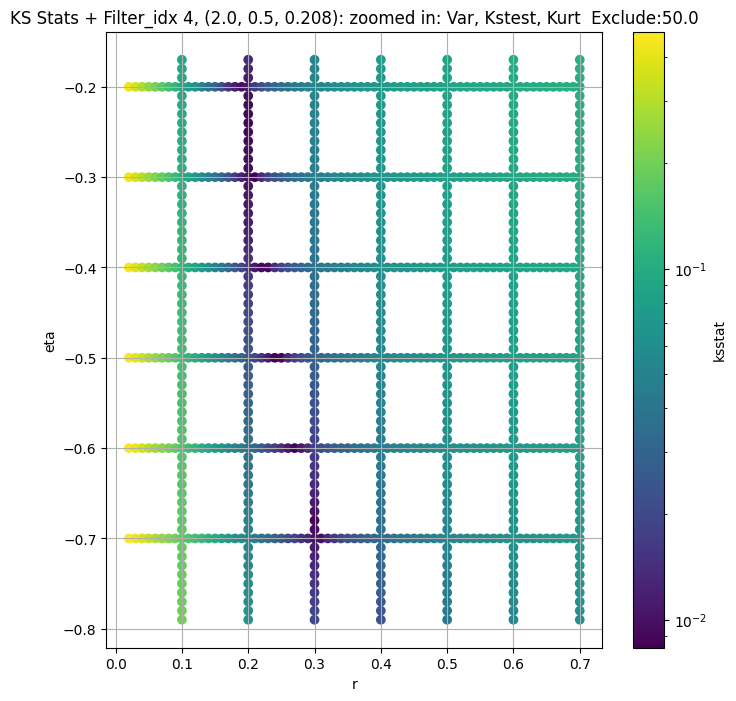

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + 100 = 200, ksstat: 0.010086749706629428, var: 146.44786071777344


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + 75 = 175, ksstat: 0.010086944619186466, var: 148.93453979492188


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + 50 = 150, ksstat: 0.010087151783271242, var: 151.64759826660156


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + 25 = 125, ksstat: 0.010087376882341903, var: 154.68043518066406


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + 0 = 100, ksstat: 0.010086605506839985, var: 158.16558837890625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + -25 = 75, ksstat: 0.010086343352283589, var: 162.24546813964844


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + -50 = 50, ksstat: 0.010086689341603228, var: 167.09756469726562


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + -75 = 25, ksstat: 0.010086516208123564, var: 173.08302307128906


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 5, 100.0 + -100 = 0, ksstat: 0.010091425166494083, var: 181.5094451904297
Number of samples: 100000, Without approximation : 2359296.0


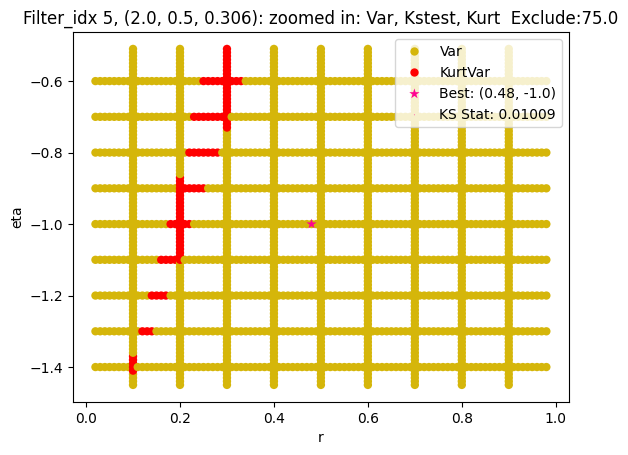

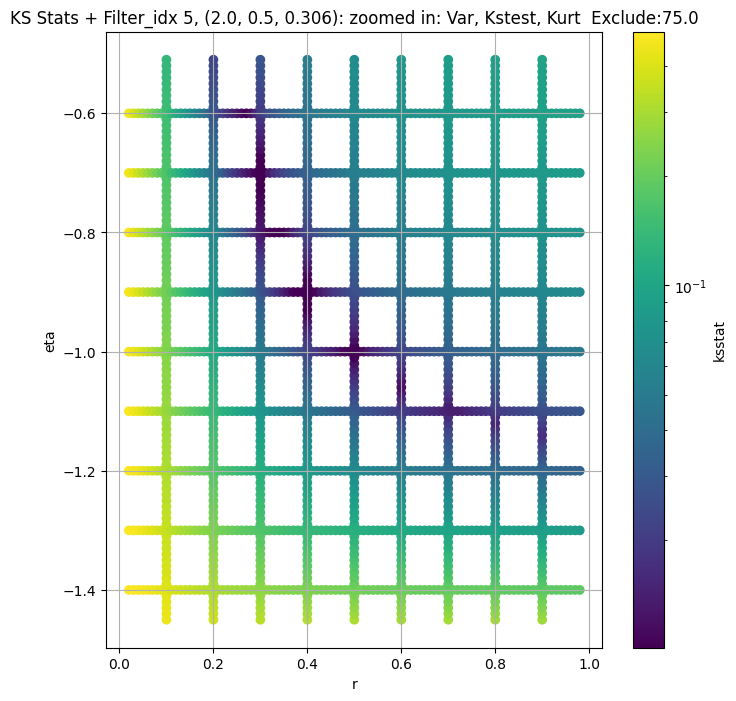

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 50.0 + 100 = 150, ksstat: 0.00577617767234484, var: 93.57413482666016


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 50.0 + 75 = 125, ksstat: 0.005307642055982664, var: 95.3854751586914


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 50.0 + 50 = 100, ksstat: 0.005180429614813242, var: 97.41075897216797


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 50.0 + 25 = 75, ksstat: 0.004660419159676965, var: 99.77635192871094


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 50.0 + 0 = 50, ksstat: 0.004571065643745431, var: 102.6471176147461


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 50.0 + -25 = 25, ksstat: 0.003956128728700714, var: 106.2090835571289


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 6, 50.0 + -50 = 0, ksstat: 0.003582699133745537, var: 111.37291717529297
Number of samples: 100000, Without approximation : 2359296.0


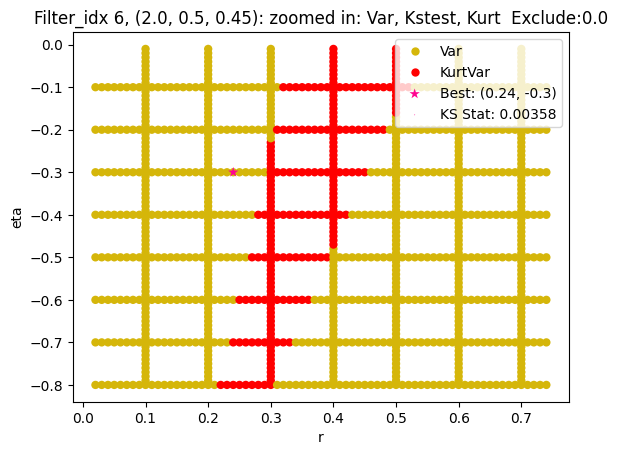

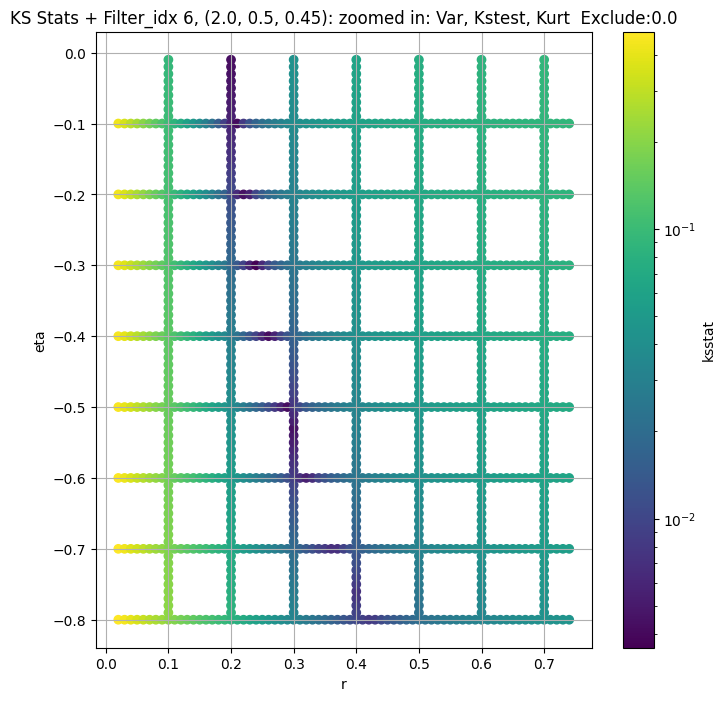

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 50.0 + 100 = 150, ksstat: 0.0042412287309655, var: 46917.234375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 50.0 + 75 = 125, ksstat: 0.003919841311058936, var: 47614.56640625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 50.0 + 50 = 100, ksstat: 0.003922109678103802, var: 48368.12890625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 50.0 + 25 = 75, ksstat: 0.003924405022801114, var: 49149.00390625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 50.0 + 0 = 50, ksstat: 0.003924865953722212, var: 49976.97265625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 50.0 + -25 = 25, ksstat: 0.003924865953722212, var: 50898.72265625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 50.0 + -50 = 0, ksstat: 0.003924865953722212, var: 52155.28125
Number of samples: 100000, Without approximation : 2359296.0


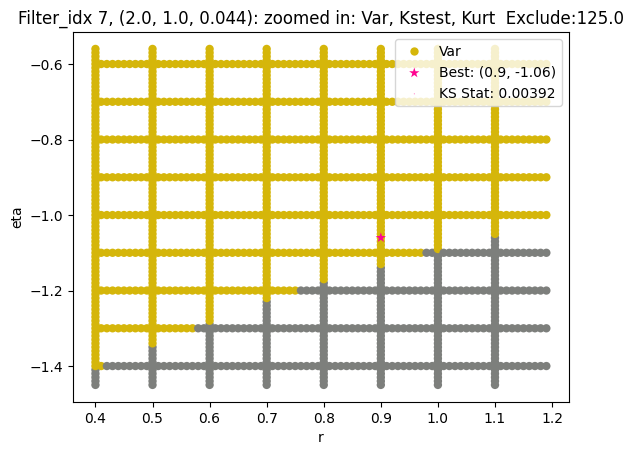

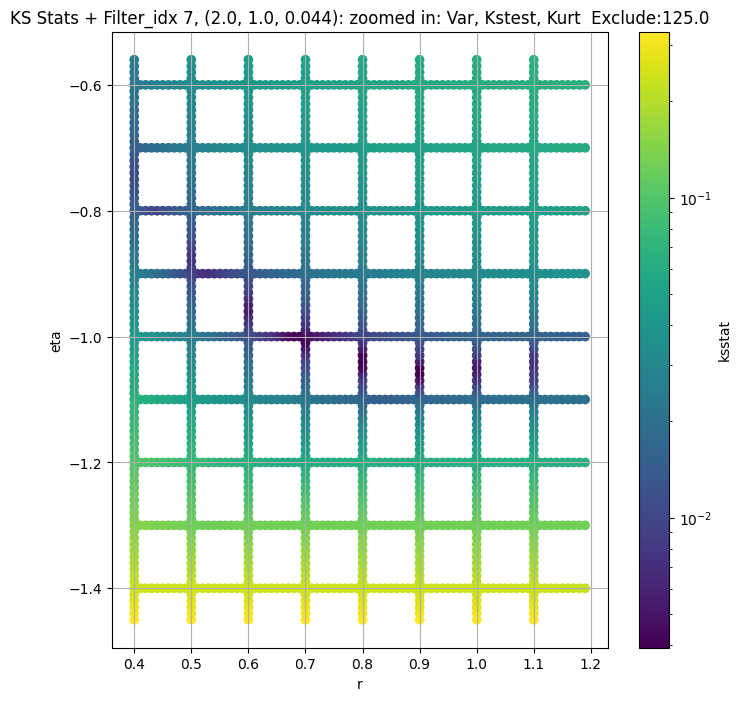

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 100 = 300, ksstat: 0.006155513775810917, var: 16524.8125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 75 = 275, ksstat: 0.0060895647193934255, var: 16700.7890625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 50 = 250, ksstat: 0.006089553448219431, var: 16884.27734375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 25 = 225, ksstat: 0.006089564877842735, var: 17076.18359375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + 0 = 200, ksstat: 0.006089551040974417, var: 17277.875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + -25 = 175, ksstat: 0.006089562529435155, var: 17491.263671875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + -50 = 150, ksstat: 0.006089546918248923, var: 17718.279296875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + -75 = 125, ksstat: 0.006092167881926458, var: 17958.216796875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 8, 200.0 + -100 = 100, ksstat: 0.006092222982035156, var: 18213.5859375
Number of samples: 100000, Without approximation : 2359296.0


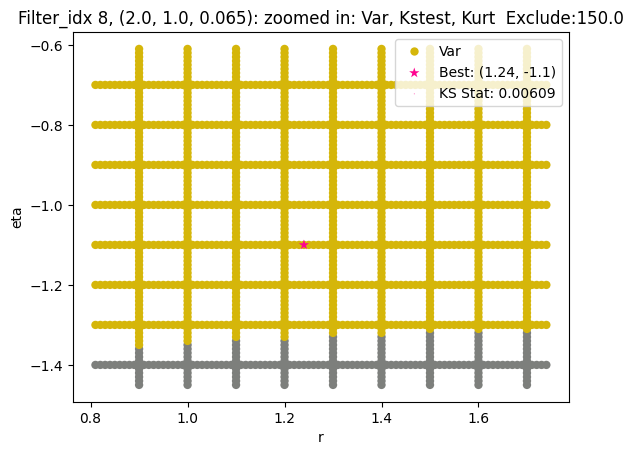

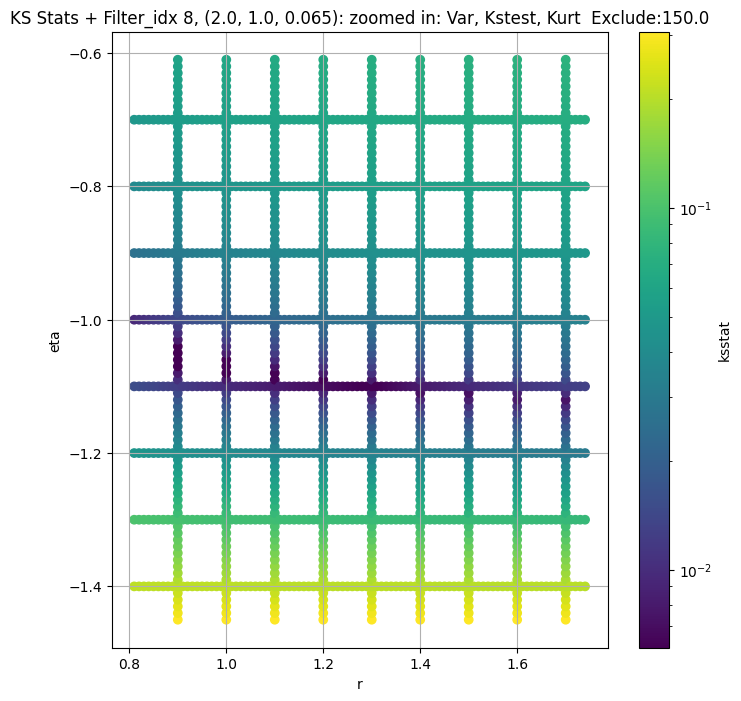

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 100 = 300, ksstat: 0.014355362359494417, var: 6004.3115234375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 75 = 275, ksstat: 0.01435531848161642, var: 6070.2890625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 50 = 250, ksstat: 0.014355336862879042, var: 6139.08984375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 25 = 225, ksstat: 0.014355357040836514, var: 6211.54296875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 0 = 200, ksstat: 0.014355310661265552, var: 6288.44091796875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + -25 = 175, ksstat: 0.014355261969245026, var: 6370.4462890625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + -50 = 150, ksstat: 0.014355288587161452, var: 6458.82861328125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + -75 = 125, ksstat: 0.014355241811929376, var: 6554.94970703125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + -100 = 100, ksstat: 0.014355196449876984, var: 6661.39697265625
Number of samples: 100000, Without approximation : 2359296.0


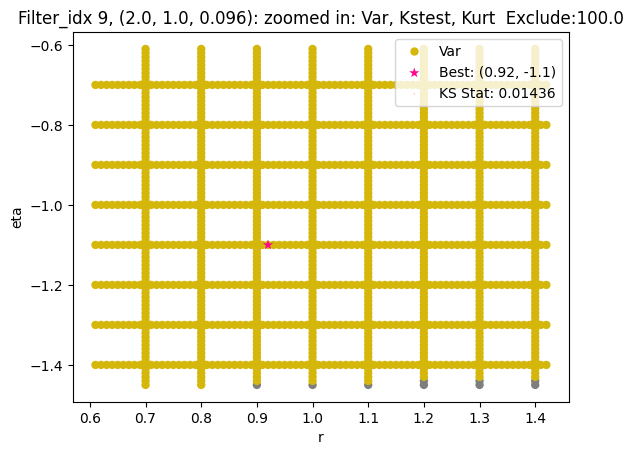

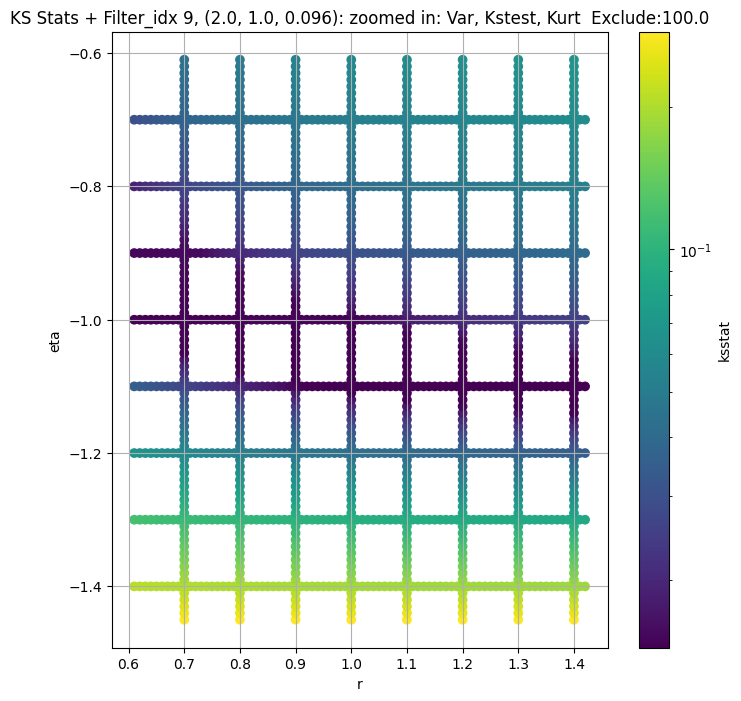

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 10, 50.0 + 100 = 150, ksstat: 0.006575852654929881, var: 2431.312255859375


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 10, 50.0 + 75 = 125, ksstat: 0.006087095735979542, var: 2468.4130859375


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 10, 50.0 + 50 = 100, ksstat: 0.0065883250255997505, var: 2508.892333984375


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 10, 50.0 + 25 = 75, ksstat: 0.006572571677717132, var: 2554.516357421875


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 10, 50.0 + 0 = 50, ksstat: 0.006257834360709369, var: 2608.001708984375


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 10, 50.0 + -25 = 25, ksstat: 0.005675402632537185, var: 2672.991455078125


  0%|          | 0/1790 [00:00<?, ?it/s]

Finding Minimum after computing 1790 CDFs
filter_idx 10, 50.0 + -50 = 0, ksstat: 0.0051230884348164585, var: 2767.642822265625
Number of samples: 100000, Without approximation : 2359296.0


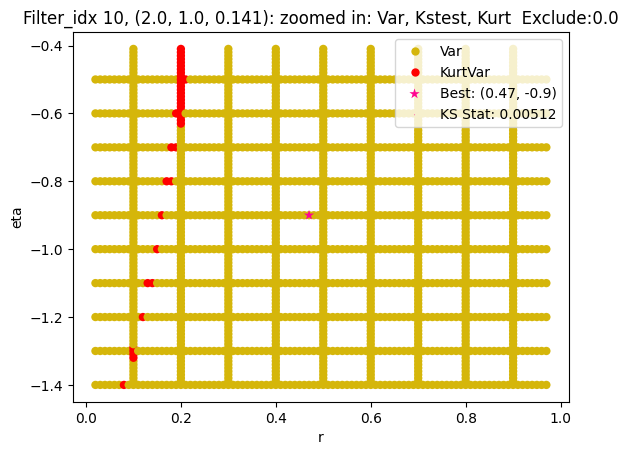

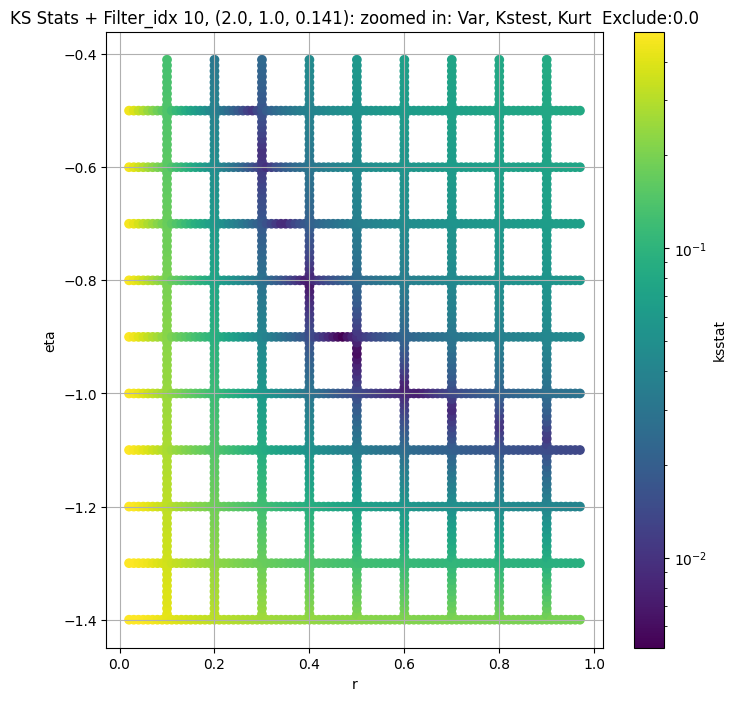

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 11, 50.0 + 100 = 150, ksstat: 0.018130208123004476, var: 860.7344970703125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 11, 50.0 + 75 = 125, ksstat: 0.018130207429461087, var: 875.8495483398438


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 11, 50.0 + 50 = 100, ksstat: 0.018130195201663202, var: 892.3428344726562


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 11, 50.0 + 25 = 75, ksstat: 0.018130281517553914, var: 910.526611328125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 11, 50.0 + 0 = 50, ksstat: 0.018130259793059433, var: 930.7449951171875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 11, 50.0 + -25 = 25, ksstat: 0.018130313731982484, var: 956.6689453125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 11, 50.0 + -50 = 0, ksstat: 0.018130336256016122, var: 996.8963012695312
Number of samples: 100000, Without approximation : 2359296.0


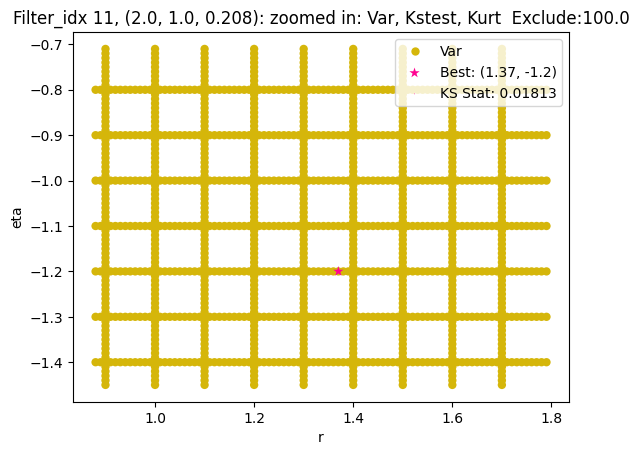

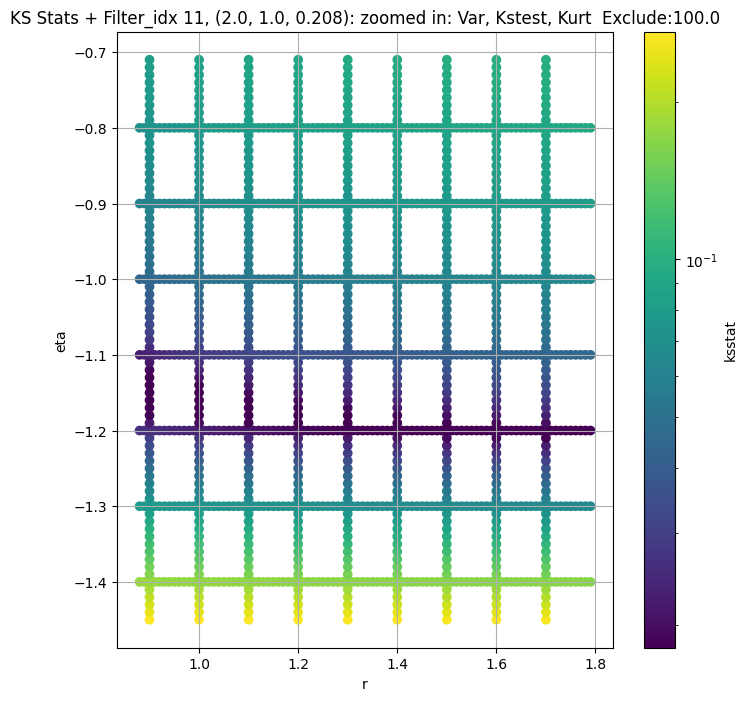

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.007271677392923004, var: 268.5774230957031


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.00687765666347262, var: 273.8759765625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.006583201425292451, var: 280.28466796875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.006203572198653584, var: 289.66680908203125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.006148230677991376, var: 305.44903564453125
Number of samples: 100000, Without approximation : 2359296.0


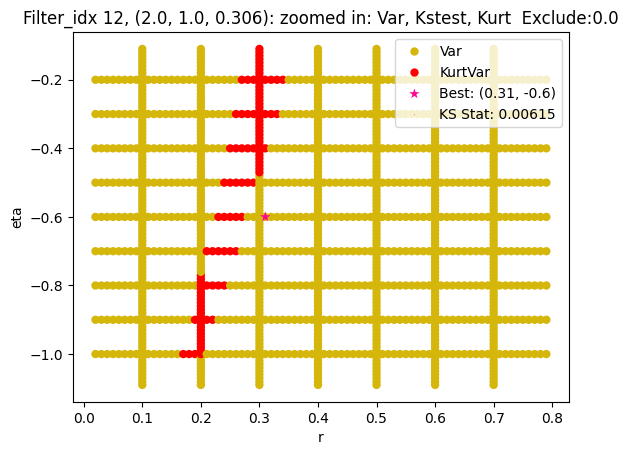

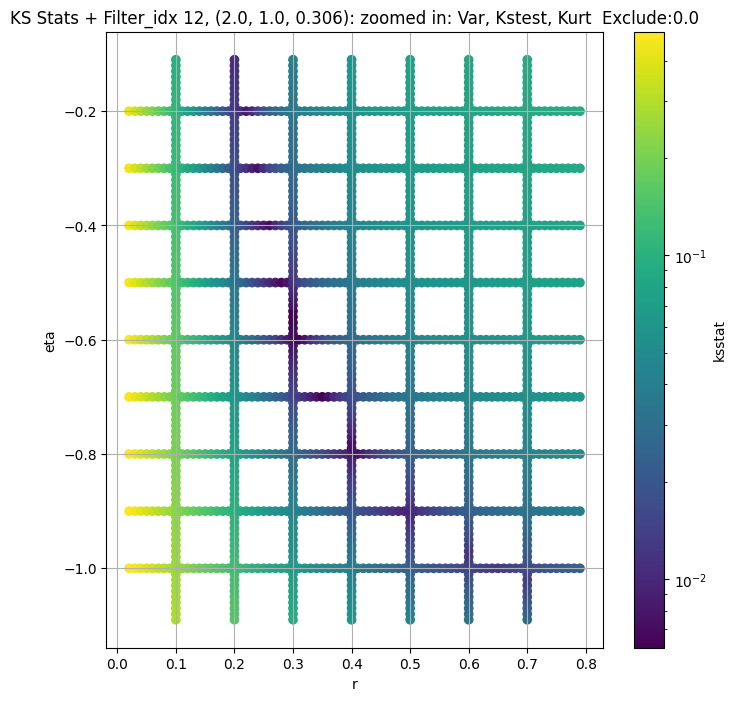

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + 100 = 200, ksstat: 0.019626568276758516, var: 53.48258972167969


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + 75 = 175, ksstat: 0.019626510863746005, var: 54.784786224365234


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + 50 = 150, ksstat: 0.019626559445391267, var: 56.34486389160156


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + 25 = 125, ksstat: 0.019626149010754934, var: 58.266685485839844


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + 0 = 100, ksstat: 0.019625869314245814, var: 60.68540573120117


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + -25 = 75, ksstat: 0.019625770430777068, var: 63.76387023925781


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + -50 = 50, ksstat: 0.0196250785402472, var: 67.7569351196289


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + -75 = 25, ksstat: 0.019623837824532475, var: 73.61976623535156


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 13, 100.0 + -100 = 0, ksstat: 0.019623476135412488, var: 83.43418884277344
Number of samples: 100000, Without approximation : 2359296.0


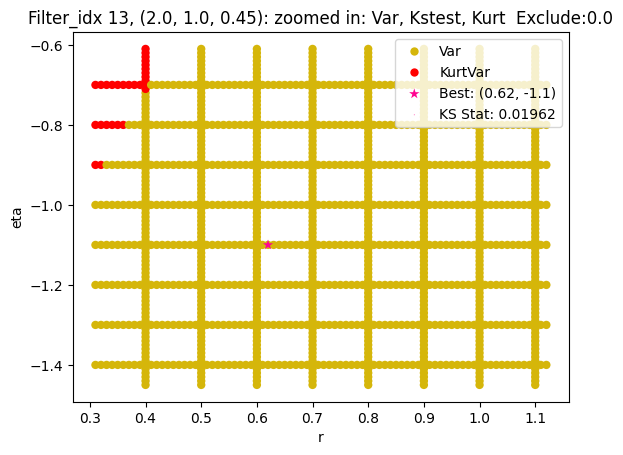

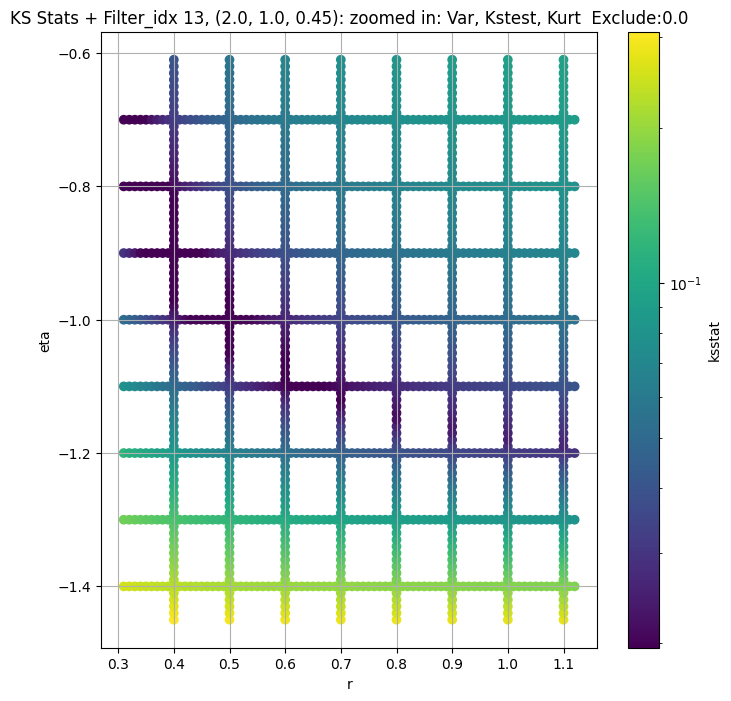

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.003412135804666913, var: 27077.853515625


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.0030591070962996715, var: 27466.25390625


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.0027740953721790973, var: 27895.599609375


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.0024957763940477162, var: 28381.171875


  0%|          | 0/1692 [00:00<?, ?it/s]

Finding Minimum after computing 1692 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.0019403409258615945, var: 28972.158203125
Number of samples: 100000, Without approximation : 2359296.0


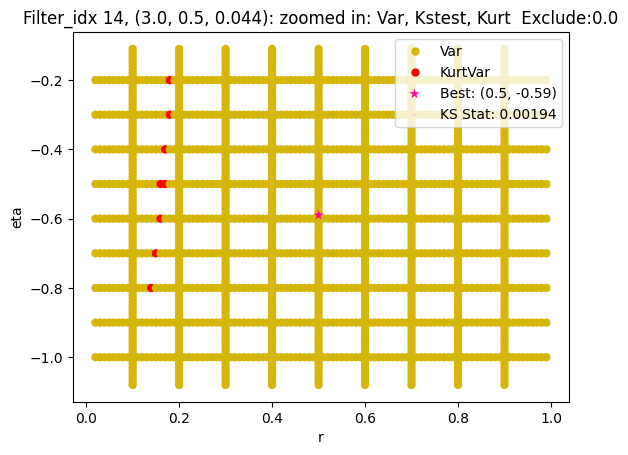

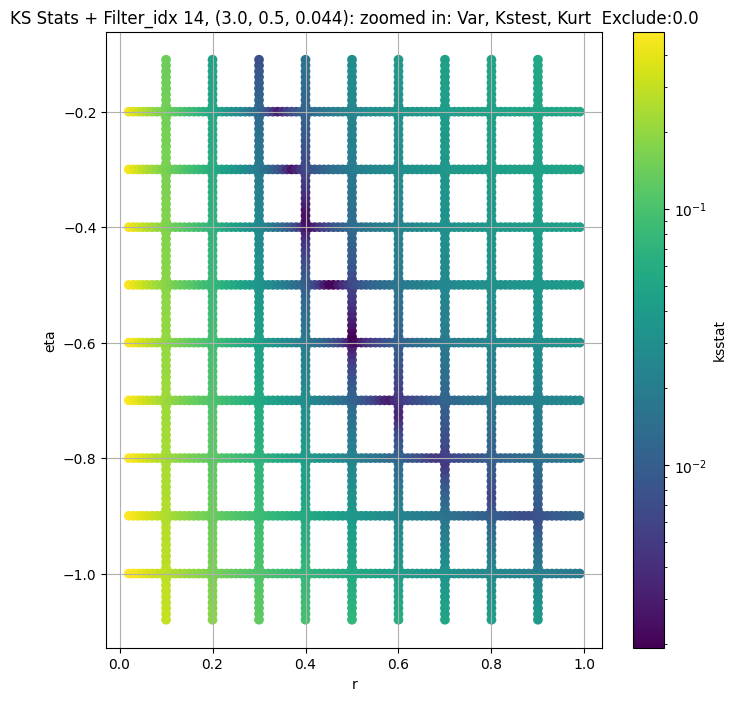

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + 100 = 300, ksstat: 0.011861431274561018, var: 9956.11328125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + 75 = 275, ksstat: 0.011859819746736444, var: 10065.291015625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + 50 = 250, ksstat: 0.011858081416521782, var: 10179.6923828125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + 25 = 225, ksstat: 0.011859767688699951, var: 10297.109375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + 0 = 200, ksstat: 0.011857774549578703, var: 10419.6142578125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + -25 = 175, ksstat: 0.011855668925363383, var: 10549.3056640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + -50 = 150, ksstat: 0.011857625522367188, var: 10687.541015625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + -75 = 125, ksstat: 0.011859853751123528, var: 10836.4013671875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 15, 200.0 + -100 = 100, ksstat: 0.011853584954038099, var: 10997.2421875
Number of samples: 100000, Without approximation : 2359296.0


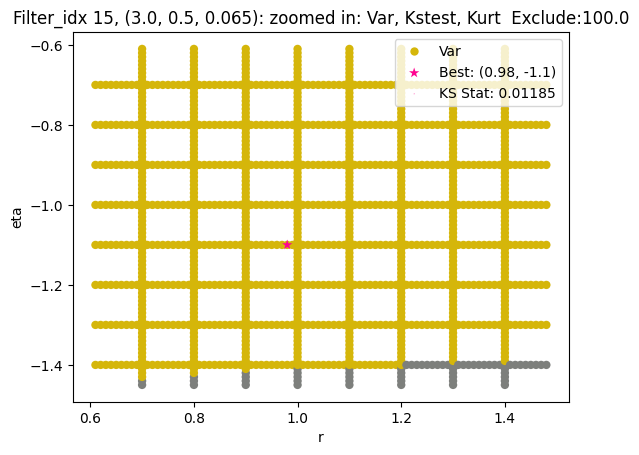

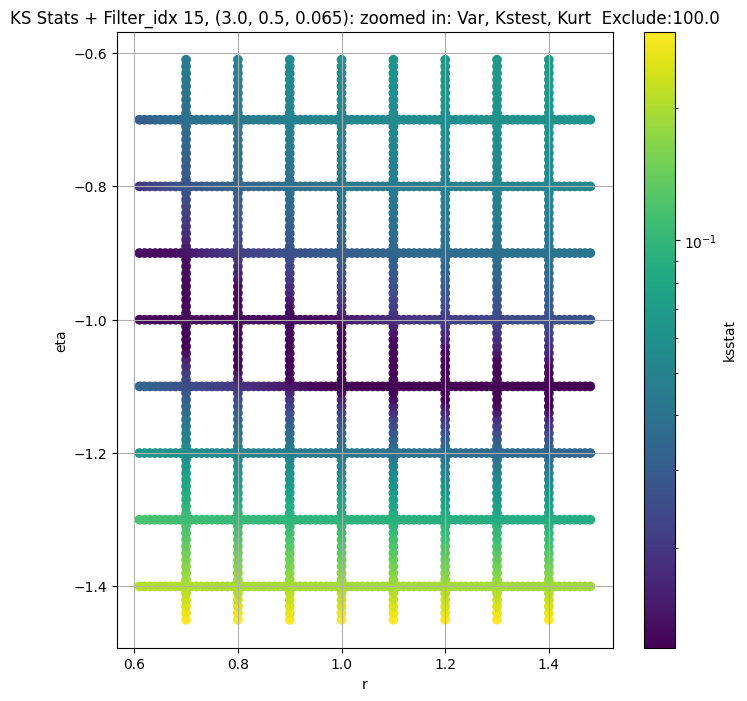

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 0.0 + 100 = 100, ksstat: 0.007172594388846765, var: 4391.25


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 0.0 + 75 = 75, ksstat: 0.007185432150056181, var: 4468.19677734375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 0.0 + 50 = 50, ksstat: 0.007189462365360888, var: 4554.4775390625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 0.0 + 25 = 25, ksstat: 0.0071943088044092995, var: 4656.44775390625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 16, 0.0 + 0 = 0, ksstat: 0.007202404123328843, var: 4800.1708984375
Number of samples: 100000, Without approximation : 2359296.0


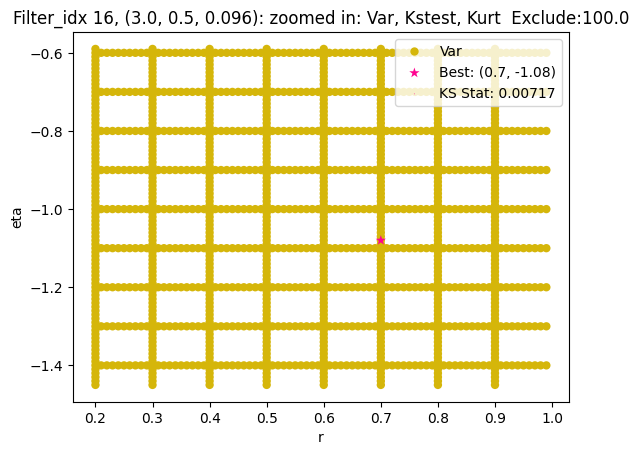

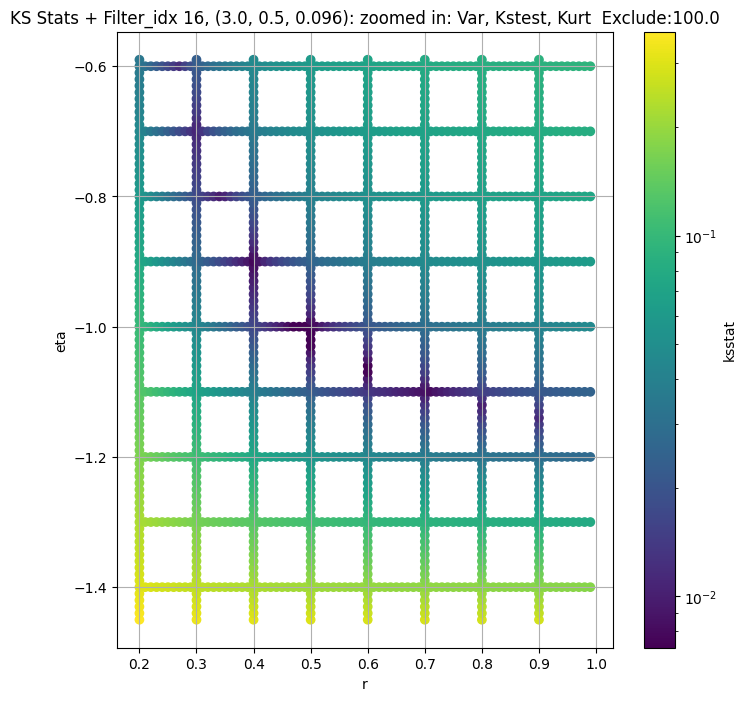

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + 100 = 200, ksstat: 0.023716406146368885, var: 1375.386962890625


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + 75 = 175, ksstat: 0.023716409226215096, var: 1396.637939453125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + 50 = 150, ksstat: 0.02371642650512601, var: 1419.52685546875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + 25 = 125, ksstat: 0.02371646725018106, var: 1444.5745849609375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + 0 = 100, ksstat: 0.02368326860375425, var: 1471.279052734375


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + -25 = 75, ksstat: 0.02360574571678331, var: 1501.269775390625


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + -50 = 50, ksstat: 0.023607618205167213, var: 1536.1036376953125


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + -75 = 25, ksstat: 0.02360443398900247, var: 1578.0184326171875


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 17, 100.0 + -100 = 0, ksstat: 0.02360729084669877, var: 1633.936279296875
Number of samples: 100000, Without approximation : 2359296.0


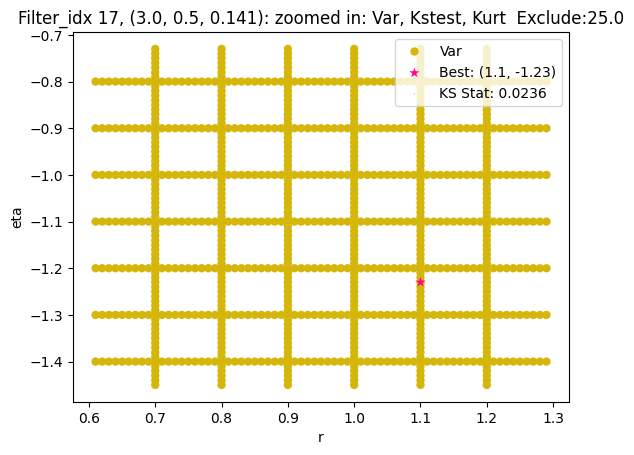

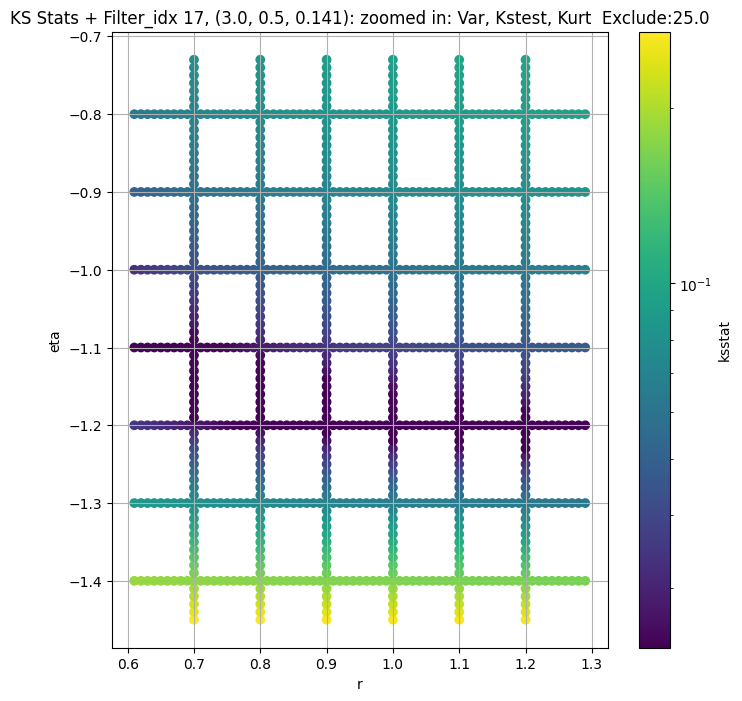

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 18, 0.0 + 100 = 100, ksstat: 0.008897273194615751, var: 662.4166870117188


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 18, 0.0 + 75 = 75, ksstat: 0.008930010641288177, var: 673.18505859375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 18, 0.0 + 50 = 50, ksstat: 0.008929434583402118, var: 685.1685791015625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 18, 0.0 + 25 = 25, ksstat: 0.008922694202081805, var: 699.8444213867188


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 18, 0.0 + 0 = 0, ksstat: 0.008950113266168902, var: 721.16162109375
Number of samples: 100000, Without approximation : 2359296.0


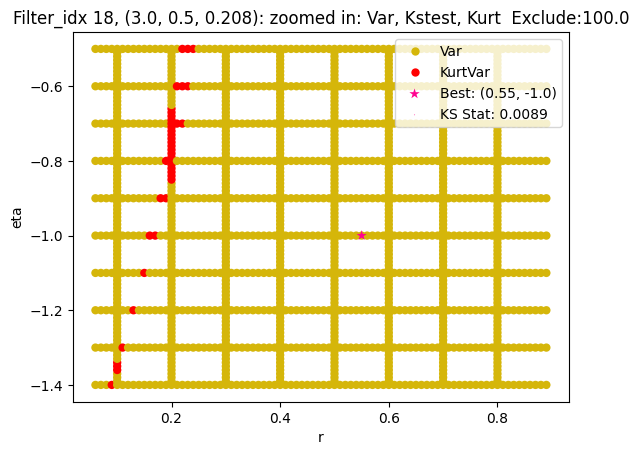

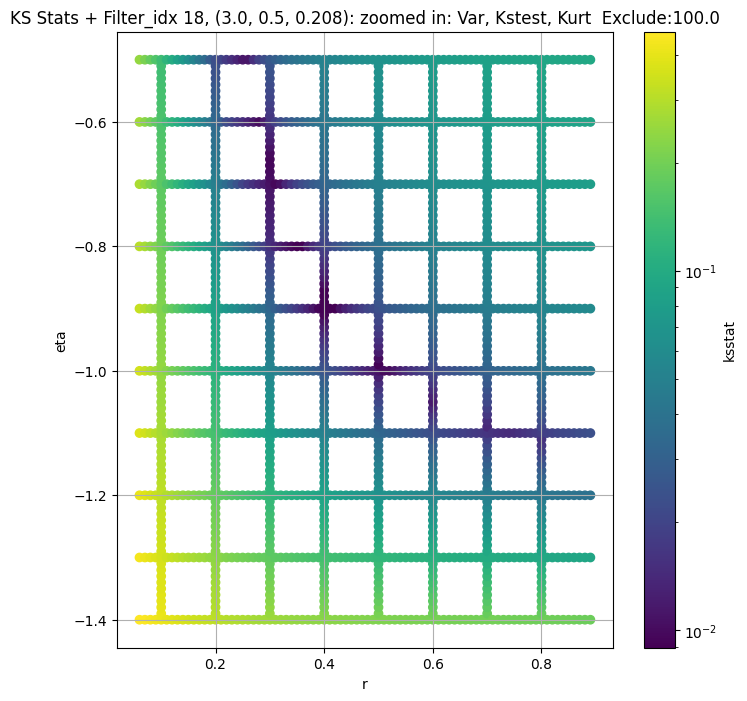

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + 100 = 200, ksstat: 0.009442161875004573, var: 184.31410217285156


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + 75 = 175, ksstat: 0.009442505061991346, var: 187.1038055419922


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + 50 = 150, ksstat: 0.009442723222270244, var: 190.1087646484375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + 25 = 125, ksstat: 0.009442955267191355, var: 193.38511657714844


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + 0 = 100, ksstat: 0.009442397187817586, var: 196.9998779296875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + -25 = 75, ksstat: 0.00944224587167275, var: 201.08966064453125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + -50 = 50, ksstat: 0.009442110077167443, var: 205.7603759765625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + -75 = 25, ksstat: 0.00944201622458174, var: 211.4582061767578


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 19, 100.0 + -100 = 0, ksstat: 0.009442083568426463, var: 220.14051818847656
Number of samples: 100000, Without approximation : 2359296.0


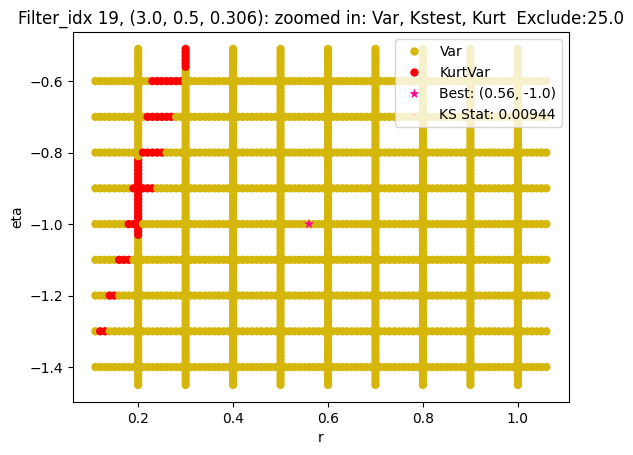

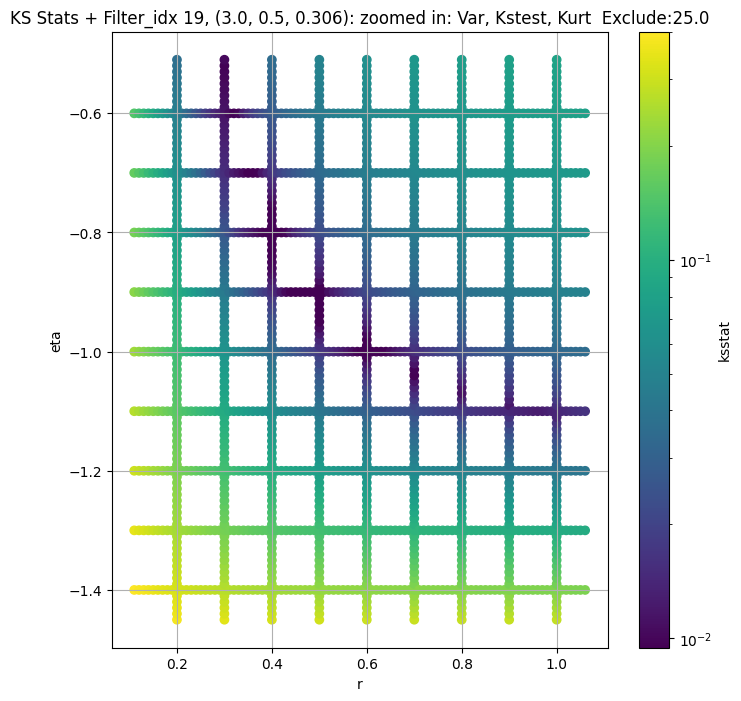

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + 100 = 200, ksstat: 0.008539929027478133, var: 46.51876449584961


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + 75 = 175, ksstat: 0.008794379634268767, var: 47.62847900390625


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + 50 = 150, ksstat: 0.008502678854722001, var: 48.91209030151367


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + 25 = 125, ksstat: 0.008708582411306232, var: 50.43528747558594


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + 0 = 100, ksstat: 0.008029235349868824, var: 52.30344772338867


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + -25 = 75, ksstat: 0.007937972956772787, var: 54.61725616455078


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + -50 = 50, ksstat: 0.008064745397650508, var: 57.4183349609375


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + -75 = 25, ksstat: 0.008424416274070312, var: 60.85024642944336


  0%|          | 0/999 [00:00<?, ?it/s]

Finding Minimum after computing 999 CDFs
filter_idx 20, 100.0 + -100 = 0, ksstat: 0.008239769934279051, var: 65.82343292236328
Number of samples: 100000, Without approximation : 2359296.0


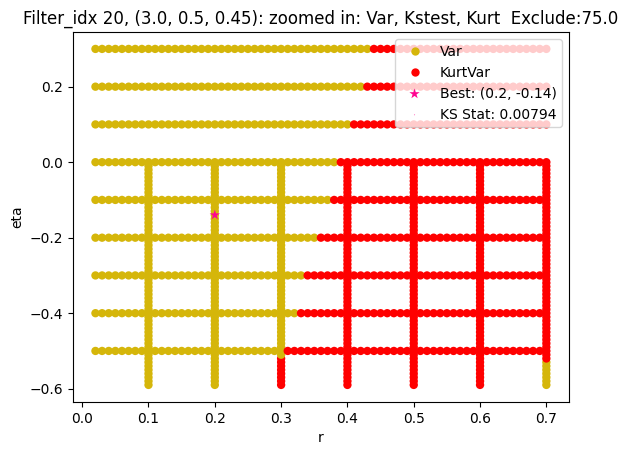

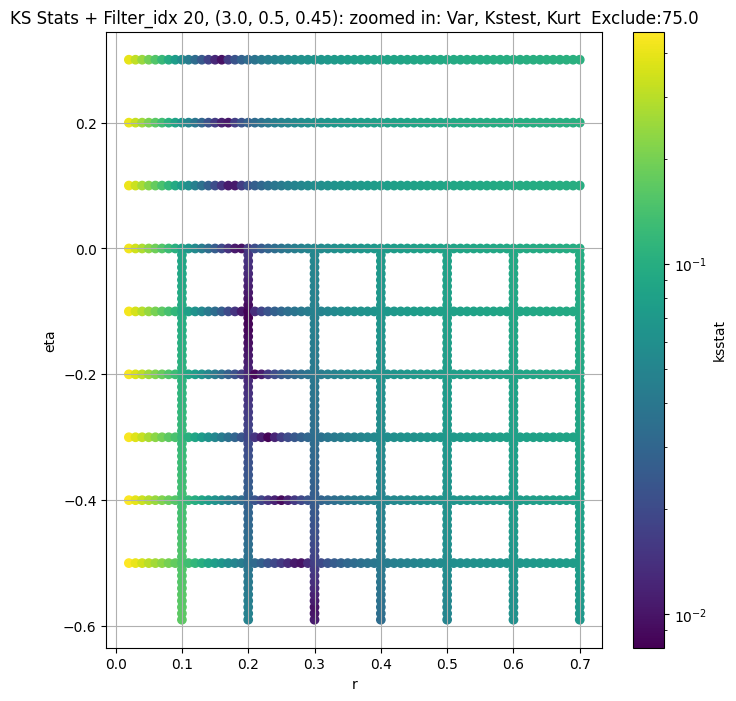

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 100 = 150, ksstat: 0.006504723900514042, var: 39547.484375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 75 = 125, ksstat: 0.006511799180983102, var: 40151.66796875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 50 = 100, ksstat: 0.006506184978663121, var: 40802.4609375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 25 = 75, ksstat: 0.00651433358912934, var: 41522.63671875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 0 = 50, ksstat: 0.006486082396255477, var: 42325.5625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + -25 = 25, ksstat: 0.006491298318534011, var: 43290.1875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + -50 = 0, ksstat: 0.006491844276314884, var: 44780.3046875
Number of samples: 100000, Without approximation : 2359296.0


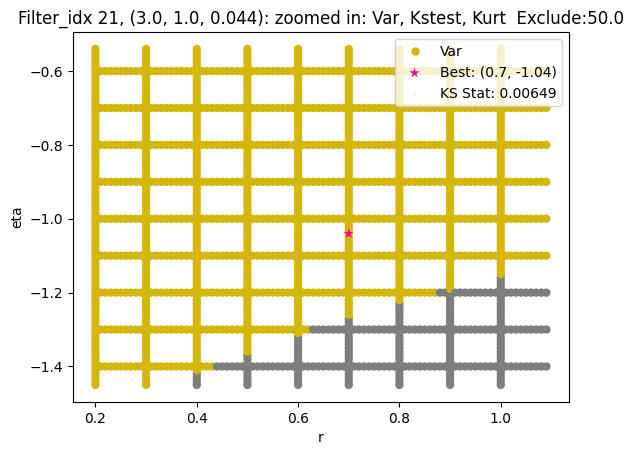

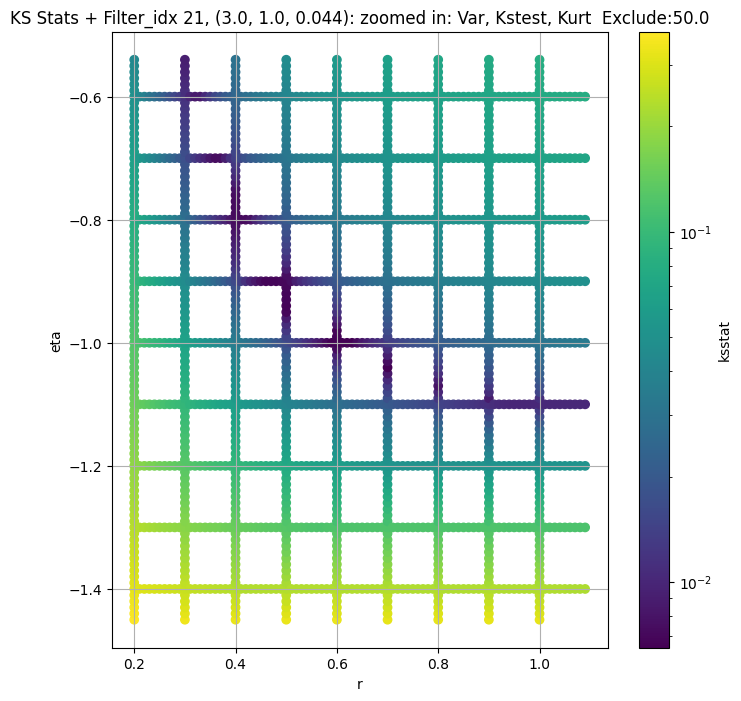

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.005376825993579248, var: 13149.548828125


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.005196668031044793, var: 13407.10546875


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.005316108628204086, var: 13689.787109375


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.004647675380499594, var: 14008.0771484375


  0%|          | 0/1512 [00:00<?, ?it/s]

Finding Minimum after computing 1512 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.004335446744571536, var: 14435.0654296875
Number of samples: 100000, Without approximation : 2359296.0


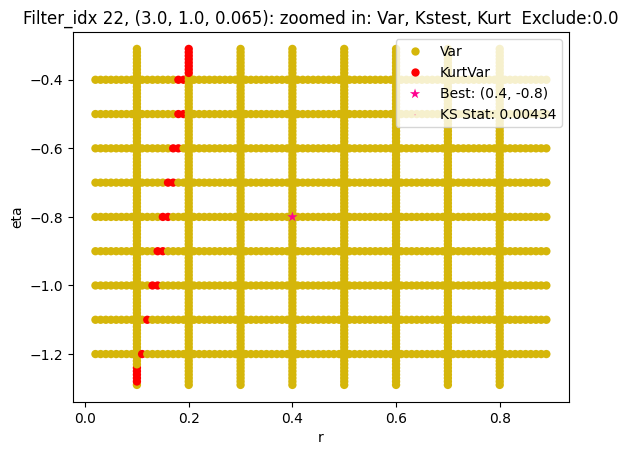

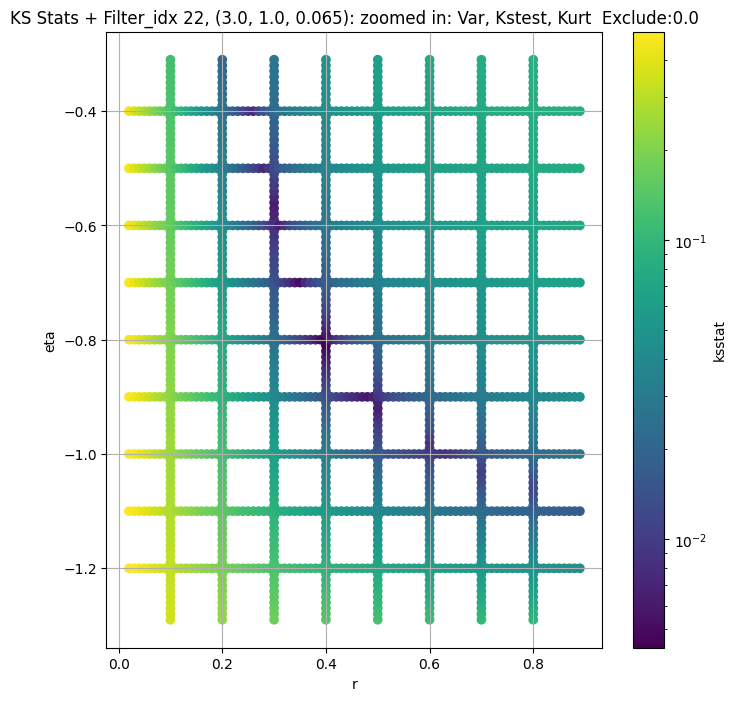

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.010146177289801828, var: 5242.38330078125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.00951704226235113, var: 5378.140625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.008889130493754283, var: 5536.89453125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.008451666283049275, var: 5724.24951171875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.007824695869326992, var: 5968.86279296875
Number of samples: 100000, Without approximation : 2359296.0


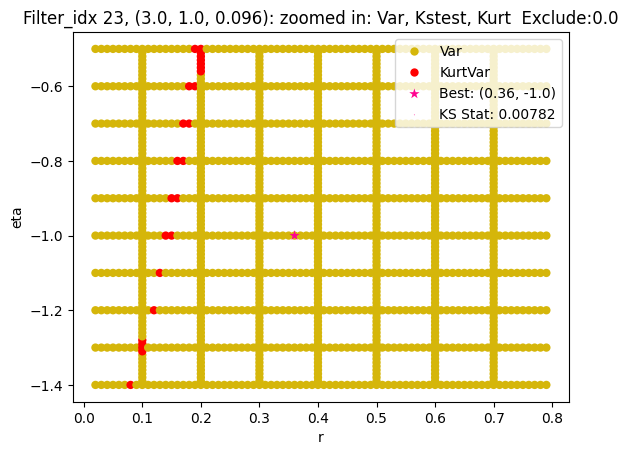

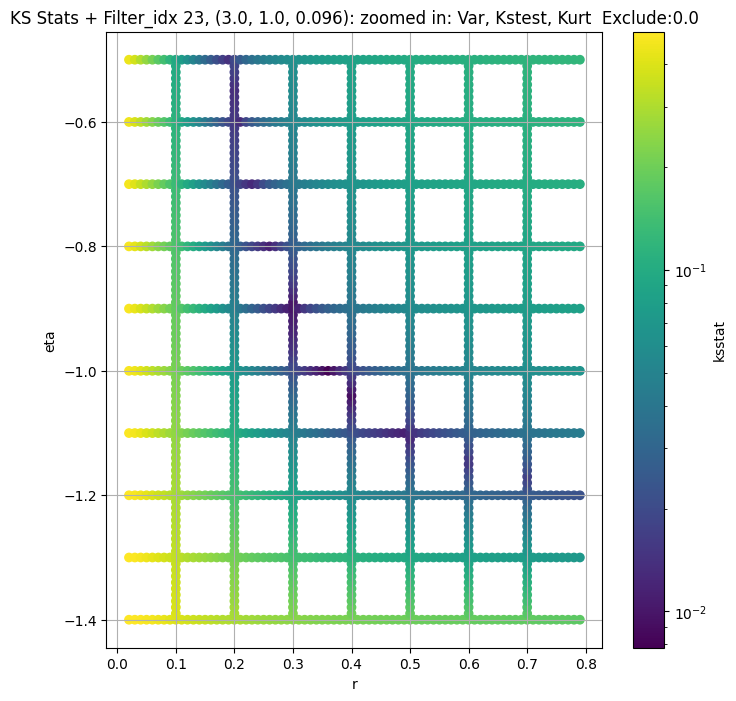

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.009973116515436975, var: 1795.624267578125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.010507855288030186, var: 1849.67724609375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.009410042631818105, var: 1913.5938720703125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.009607213912415105, var: 1990.02587890625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.008879142406890472, var: 2101.80810546875
Number of samples: 100000, Without approximation : 2359296.0


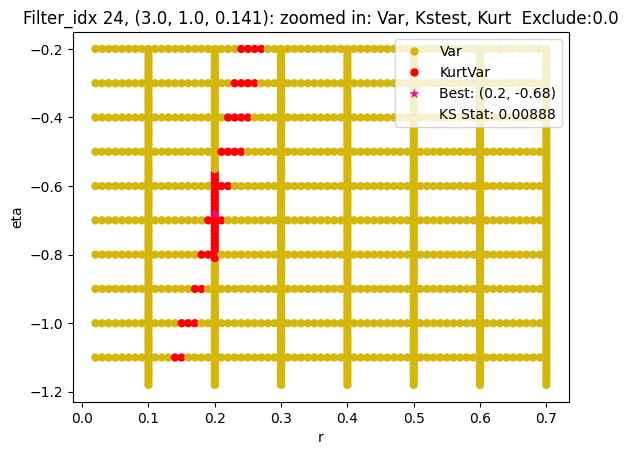

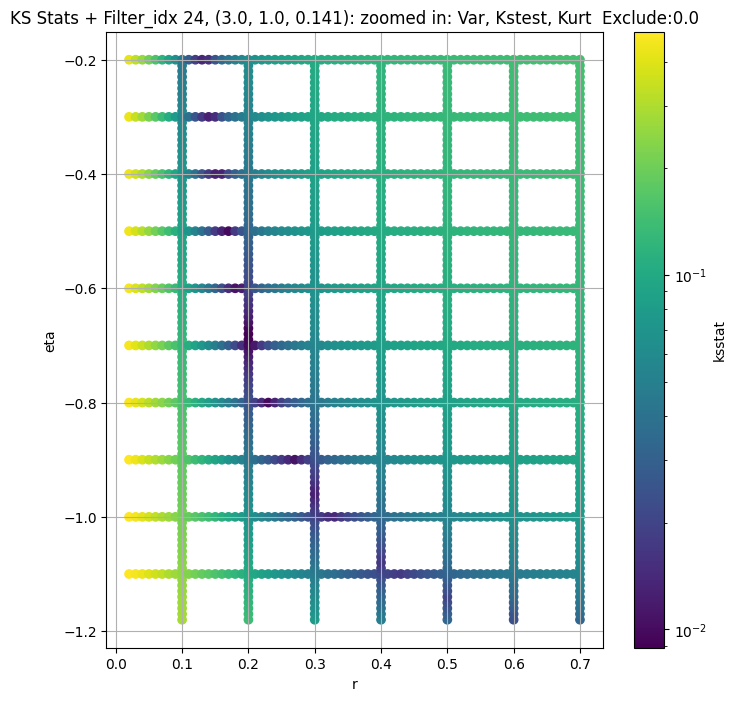

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 25, 0.0 + 100 = 100, ksstat: 0.00936842831669693, var: 685.62646484375


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 25, 0.0 + 75 = 75, ksstat: 0.009738934474010308, var: 703.1519775390625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 25, 0.0 + 50 = 50, ksstat: 0.00881434990182739, var: 723.8035888671875


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 25, 0.0 + 25 = 25, ksstat: 0.009490049328602979, var: 750.839111328125


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 25, 0.0 + 0 = 0, ksstat: 0.008323904703529617, var: 794.8213500976562
Number of samples: 100000, Without approximation : 2359296.0


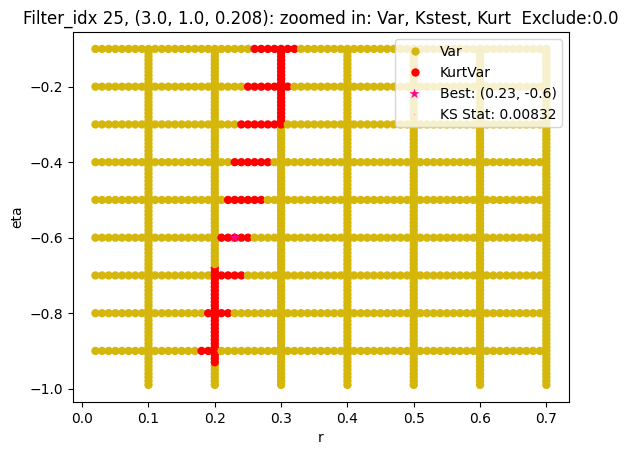

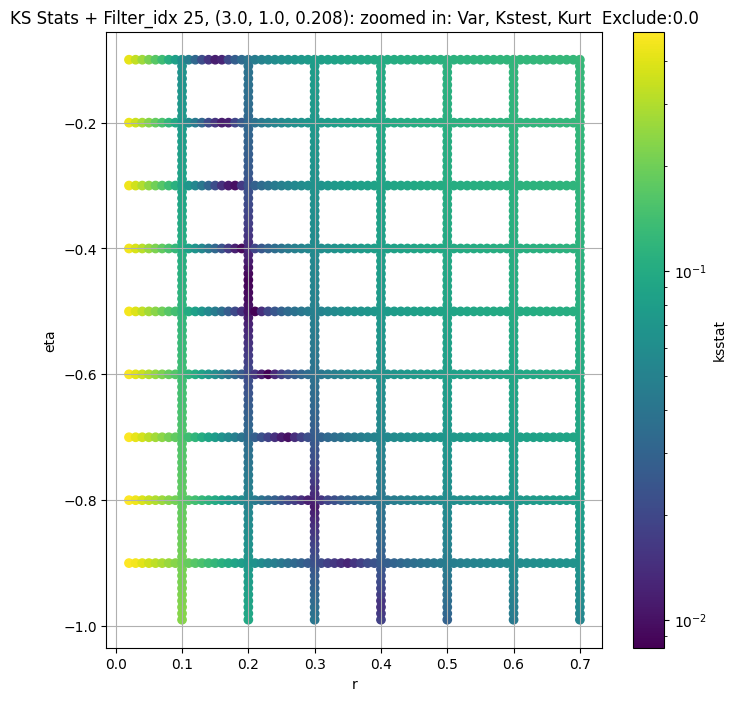

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 100 = 300, ksstat: 0.009089859717998583, var: 118.61882019042969


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 75 = 275, ksstat: 0.009107856259800595, var: 120.8286361694336


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 50 = 250, ksstat: 0.009089959424832261, var: 123.1939468383789


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 25 = 225, ksstat: 0.00910248131969299, var: 125.73438262939453


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + 0 = 200, ksstat: 0.0091041730281326, var: 128.4818878173828


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + -25 = 175, ksstat: 0.009101556961521484, var: 131.4850616455078


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + -50 = 150, ksstat: 0.009099003724661103, var: 134.80250549316406


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + -75 = 125, ksstat: 0.009117794211772057, var: 138.43081665039062


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 26, 200.0 + -100 = 100, ksstat: 0.009119848240294215, var: 142.5181884765625
Number of samples: 100000, Without approximation : 2359296.0


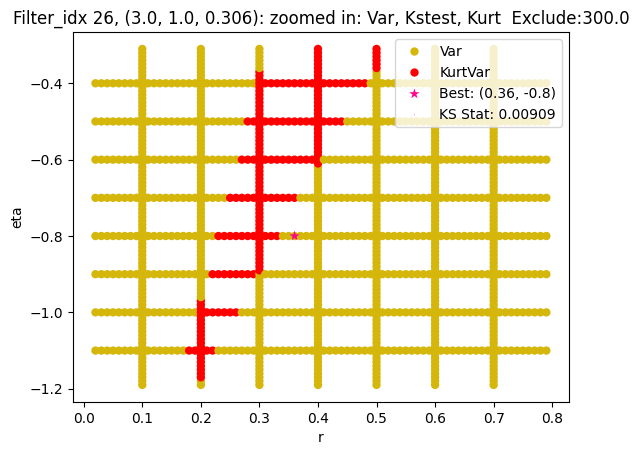

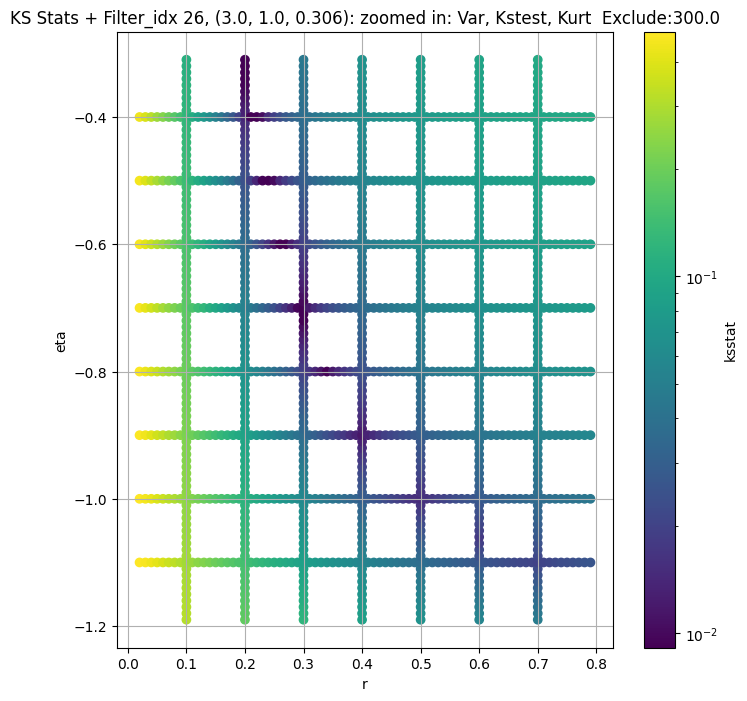

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 100 = 150, ksstat: 0.008734051515911112, var: 60.66217803955078


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 75 = 125, ksstat: 0.008132086300167485, var: 62.0295524597168


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 50 = 100, ksstat: 0.007426130424034144, var: 63.60923385620117


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 25 = 75, ksstat: 0.006809379976618235, var: 65.45447540283203


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + 0 = 50, ksstat: 0.007186931968354848, var: 67.91387176513672


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + -25 = 25, ksstat: 0.0070610044842408515, var: 72.00044250488281


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 27, 50.0 + -50 = 0, ksstat: 0.0077852425288432725, var: 79.18611145019531
Number of samples: 100000, Without approximation : 2359296.0


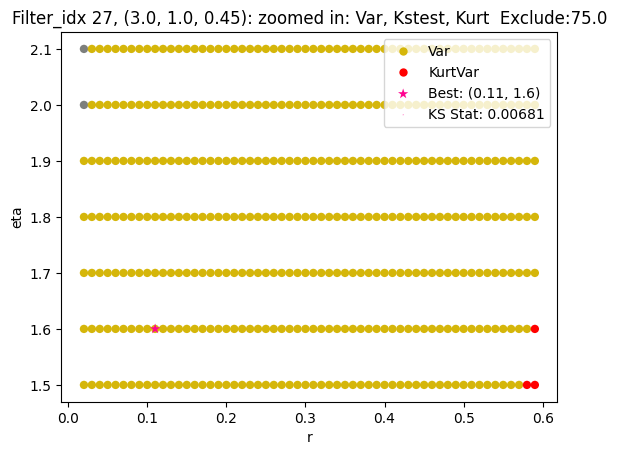

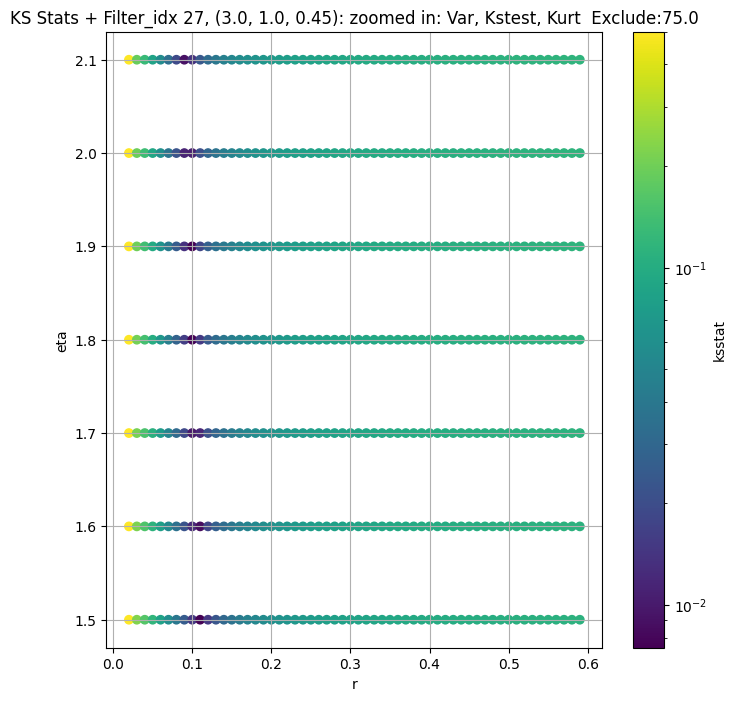

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.003327735726089222, var: 30685.173828125


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.0031112867945505274, var: 31138.423828125


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.003134794935582219, var: 31633.640625


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.0031401698872428607, var: 32203.98046875


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.0031184596227511463, var: 32999.5078125
Number of samples: 100000, Without approximation : 2359296.0


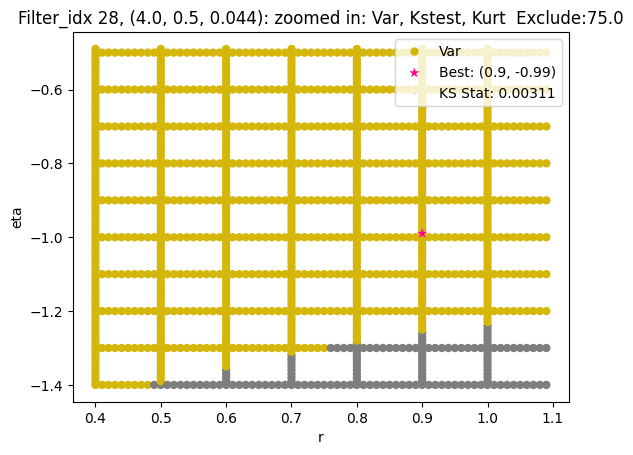

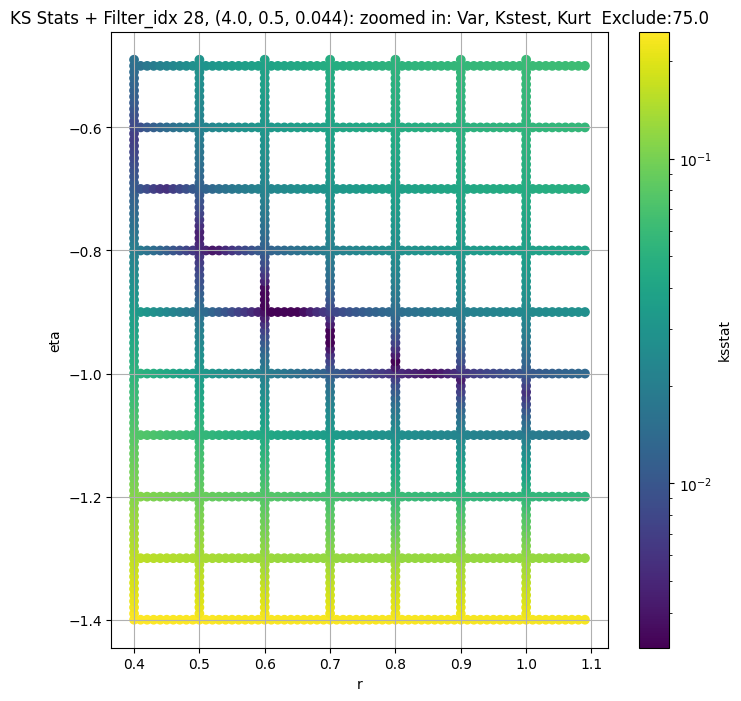

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + 100 = 300, ksstat: 0.00736737099594359, var: 9631.80859375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + 75 = 275, ksstat: 0.0072266711054727595, var: 9734.8828125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + 50 = 250, ksstat: 0.007085953272353507, var: 9842.29296875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + 25 = 225, ksstat: 0.006796187084177487, var: 9954.33203125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + 0 = 200, ksstat: 0.006517240354996845, var: 10071.4443359375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + -25 = 175, ksstat: 0.00618429116524255, var: 10194.650390625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + -50 = 150, ksstat: 0.006280041827642913, var: 10324.6689453125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + -75 = 125, ksstat: 0.006371050871266215, var: 10462.0439453125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 29, 200.0 + -100 = 100, ksstat: 0.006121968184722326, var: 10608.052734375
Number of samples: 100000, Without approximation : 2359296.0


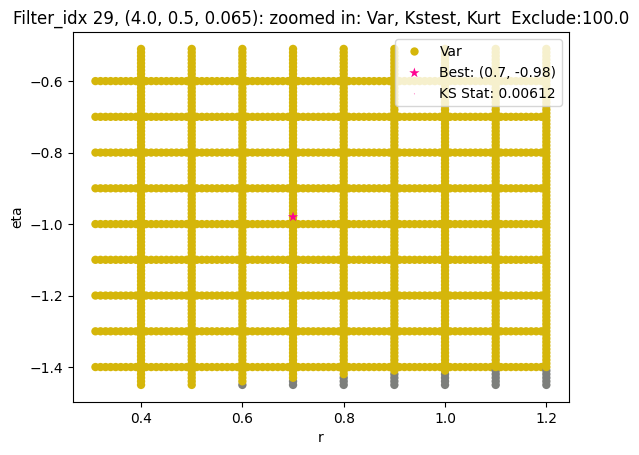

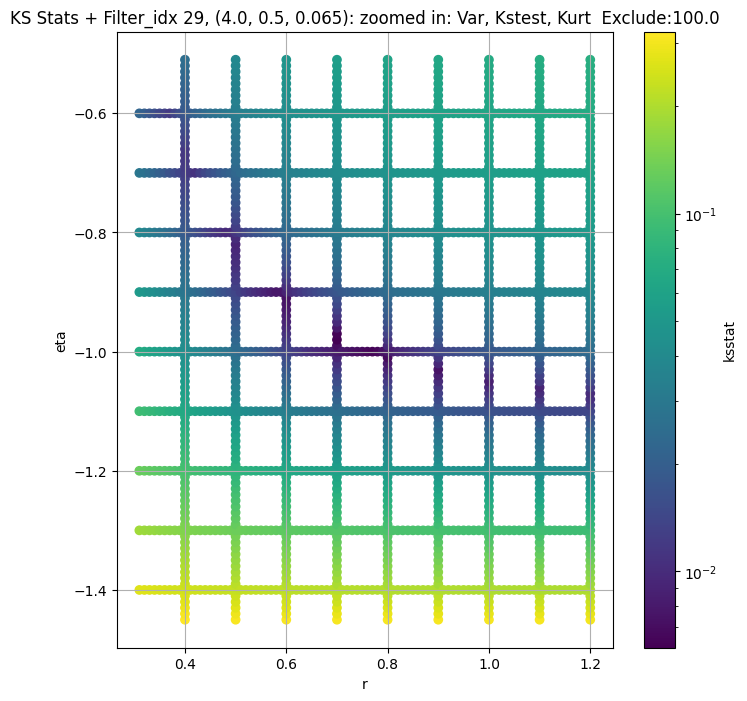

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 30, 50.0 + 100 = 150, ksstat: 0.010279337721741943, var: 4096.70654296875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 30, 50.0 + 75 = 125, ksstat: 0.010656656335437553, var: 4153.55712890625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 30, 50.0 + 50 = 100, ksstat: 0.010447637166632884, var: 4214.88916015625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 30, 50.0 + 25 = 75, ksstat: 0.010188334594658843, var: 4282.38818359375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 30, 50.0 + 0 = 50, ksstat: 0.009725978334791052, var: 4358.4541015625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 30, 50.0 + -25 = 25, ksstat: 0.00967356956787524, var: 4448.85791015625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 30, 50.0 + -50 = 0, ksstat: 0.009649485856879914, var: 4582.912109375
Number of samples: 100000, Without approximation : 2359296.0


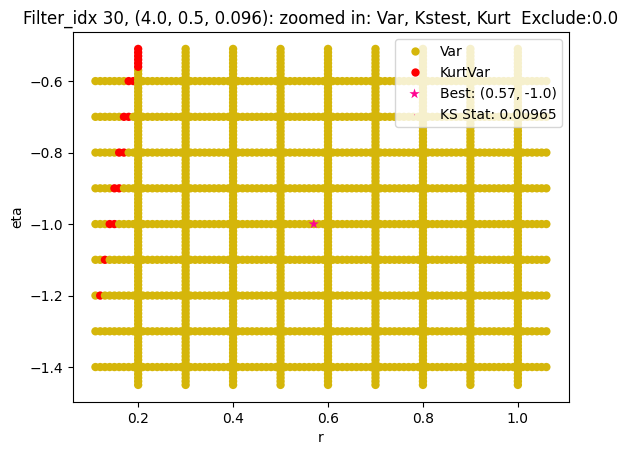

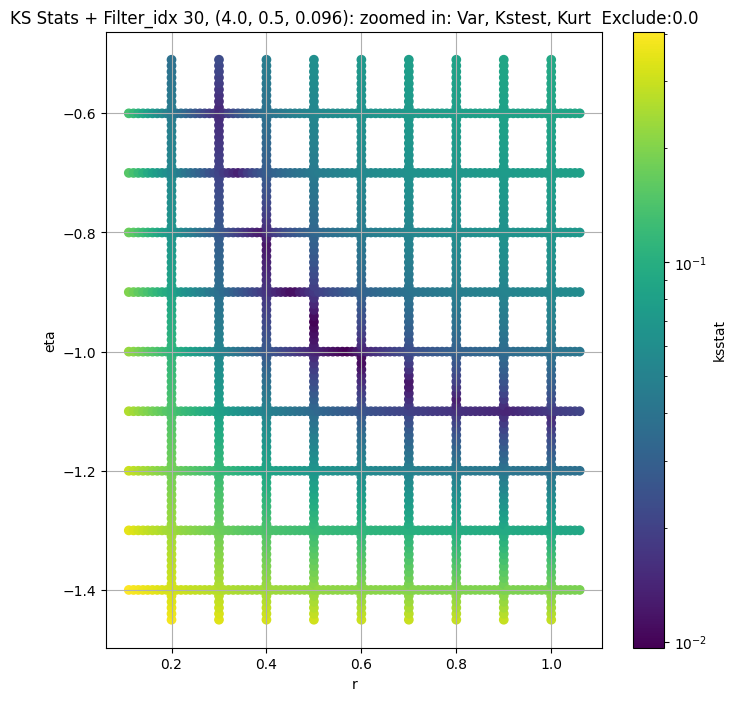

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 0.0 + 100 = 100, ksstat: 0.014923006235504632, var: 1437.99609375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 0.0 + 75 = 75, ksstat: 0.014924093026447816, var: 1467.66455078125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 0.0 + 50 = 50, ksstat: 0.014922921763066088, var: 1501.634765625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 0.0 + 25 = 25, ksstat: 0.014924379479024918, var: 1543.3763427734375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 31, 0.0 + 0 = 0, ksstat: 0.014921780691785902, var: 1618.371826171875
Number of samples: 100000, Without approximation : 2359296.0


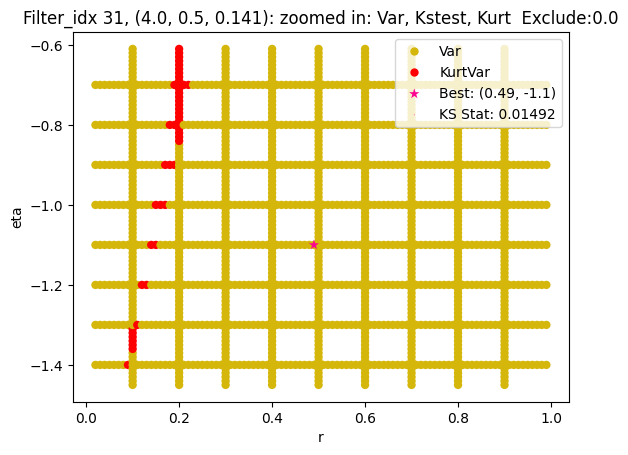

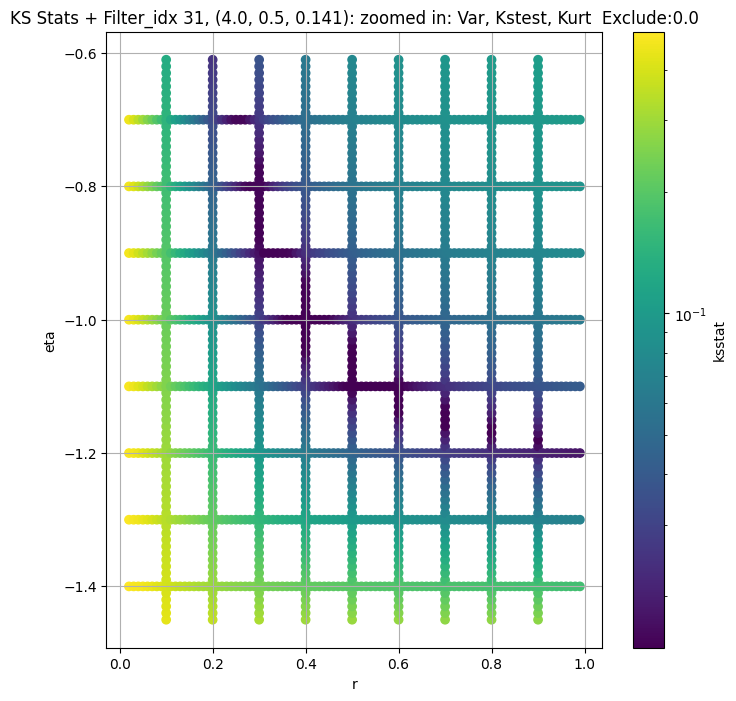

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 100 = 300, ksstat: 0.01675294834317903, var: 444.5396423339844


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 75 = 275, ksstat: 0.016754991565194832, var: 451.1762390136719


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 50 = 250, ksstat: 0.016751881391980583, var: 458.1253967285156


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 25 = 225, ksstat: 0.01675406129850887, var: 465.3995056152344


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + 0 = 200, ksstat: 0.016750847300620708, var: 473.0155334472656


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -25 = 175, ksstat: 0.016753204697150692, var: 481.114990234375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -50 = 150, ksstat: 0.016749965938604006, var: 489.7752990722656


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -75 = 125, ksstat: 0.016752603474416206, var: 499.1426696777344


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 200.0 + -100 = 100, ksstat: 0.016749422112973533, var: 509.28692626953125
Number of samples: 100000, Without approximation : 2359296.0


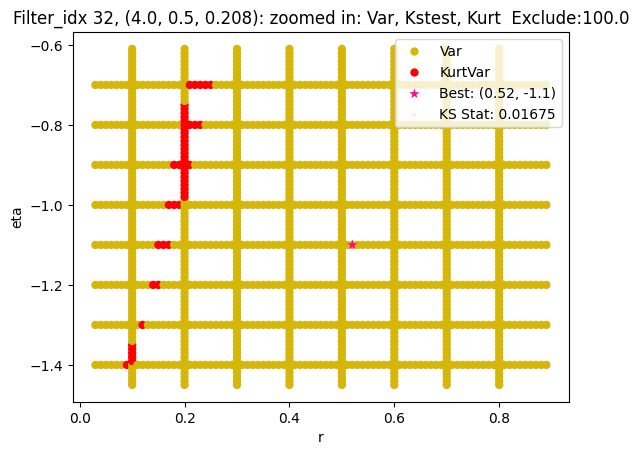

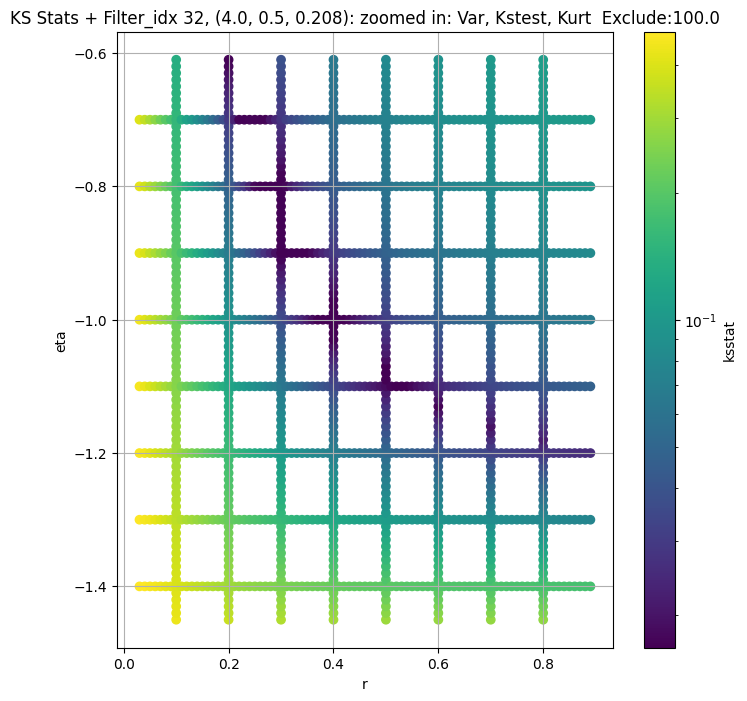

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + 100 = 300, ksstat: 0.018075513662789033, var: 124.44239807128906


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + 75 = 275, ksstat: 0.01807583432364135, var: 126.52669525146484


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + 50 = 250, ksstat: 0.018076709145185332, var: 128.731201171875


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + 25 = 225, ksstat: 0.018075237719272275, var: 131.07203674316406


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + 0 = 200, ksstat: 0.018076405183041322, var: 133.56040954589844


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + -25 = 175, ksstat: 0.018077614354949922, var: 136.21311950683594


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + -50 = 150, ksstat: 0.01807292302298852, var: 139.0791778564453


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + -75 = 125, ksstat: 0.018074335700020427, var: 142.224365234375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 200.0 + -100 = 100, ksstat: 0.018072561711616253, var: 145.59510803222656
Number of samples: 100000, Without approximation : 2359296.0


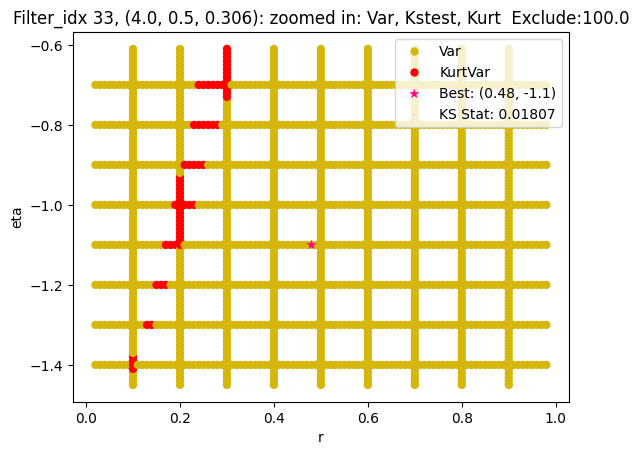

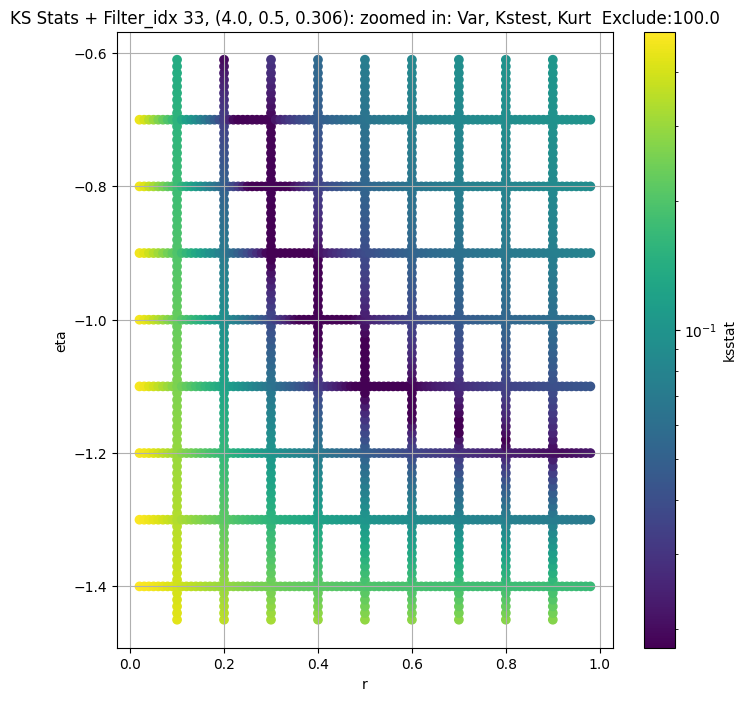

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + 100 = 200, ksstat: 0.028859493559109328, var: 44.83059310913086


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + 75 = 175, ksstat: 0.02885869366382099, var: 45.902931213378906


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + 50 = 150, ksstat: 0.028857982930400206, var: 47.12489318847656


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + 25 = 125, ksstat: 0.02843782611727974, var: 48.543087005615234


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + 0 = 100, ksstat: 0.028447591173768938, var: 50.13649368286133


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + -25 = 75, ksstat: 0.028439092591008075, var: 52.06043243408203


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + -50 = 50, ksstat: 0.028452876138129746, var: 54.5020637512207


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + -75 = 25, ksstat: 0.028359331653534547, var: 57.37372589111328


  0%|          | 0/1305 [00:00<?, ?it/s]

Finding Minimum after computing 1305 CDFs
filter_idx 34, 100.0 + -100 = 0, ksstat: 0.028370077221258838, var: 63.26654815673828
Number of samples: 100000, Without approximation : 2359296.0


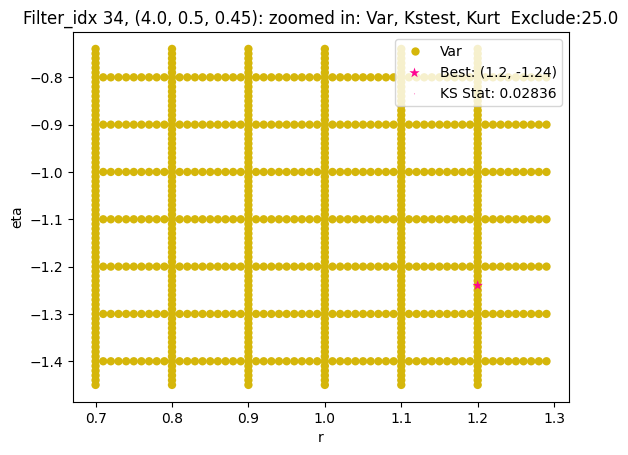

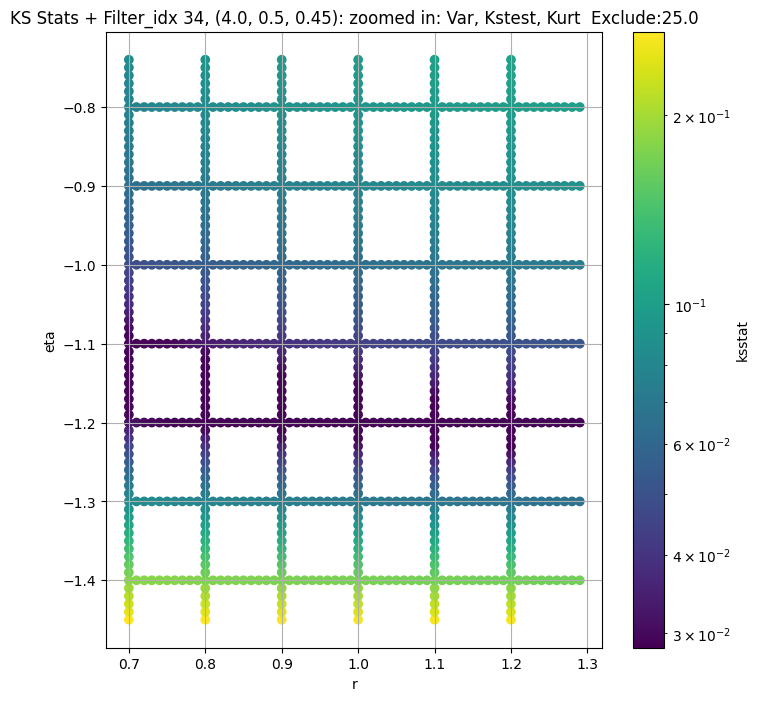

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + 100 = 300, ksstat: 0.006332336640672398, var: 30060.302734375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + 75 = 275, ksstat: 0.006569522558429908, var: 30598.576171875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + 50 = 250, ksstat: 0.006572930894108486, var: 31173.142578125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + 25 = 225, ksstat: 0.006780829495628082, var: 31780.91796875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + 0 = 200, ksstat: 0.006726672058627536, var: 32438.57421875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + -25 = 175, ksstat: 0.0068725031454838215, var: 33153.70703125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + -50 = 150, ksstat: 0.006788537009299822, var: 33924.71875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + -75 = 125, ksstat: 0.006804934868599677, var: 34756.7734375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 35, 200.0 + -100 = 100, ksstat: 0.006970322801275519, var: 35670.203125
Number of samples: 100000, Without approximation : 2359296.0


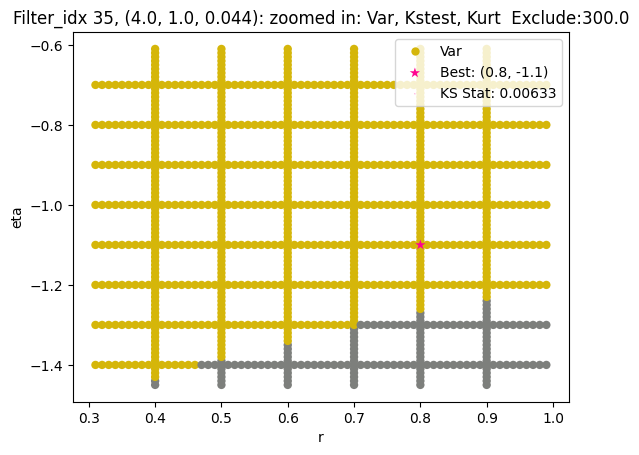

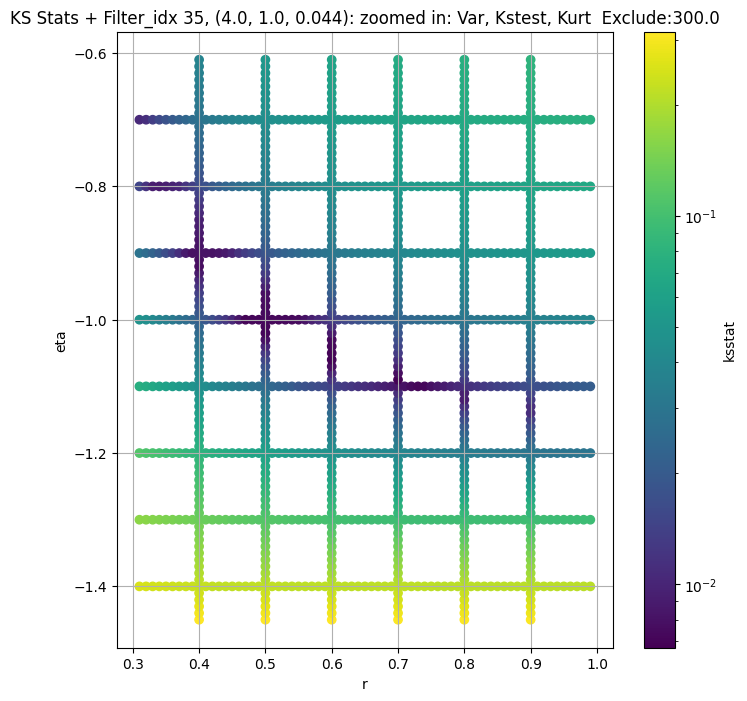

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 36, 50.0 + 100 = 150, ksstat: 0.0024790210376131588, var: 13113.1669921875


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 36, 50.0 + 75 = 125, ksstat: 0.002803646633910084, var: 13322.029296875


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 36, 50.0 + 50 = 100, ksstat: 0.0023732902268745193, var: 13548.76953125


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 36, 50.0 + 25 = 75, ksstat: 0.002444674598201635, var: 13795.61328125


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 36, 50.0 + 0 = 50, ksstat: 0.0024492588425185646, var: 14070.8935546875


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 36, 50.0 + -25 = 25, ksstat: 0.0024505763247780754, var: 14393.103515625


  0%|          | 0/1701 [00:00<?, ?it/s]

Finding Minimum after computing 1701 CDFs
filter_idx 36, 50.0 + -50 = 0, ksstat: 0.00255869075598672, var: 14875.310546875
Number of samples: 100000, Without approximation : 2359296.0


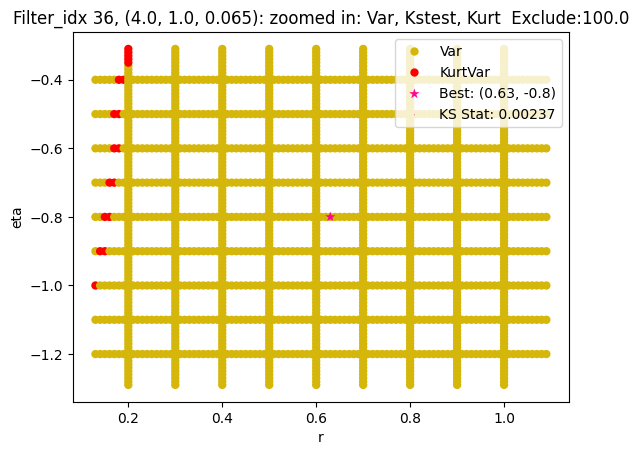

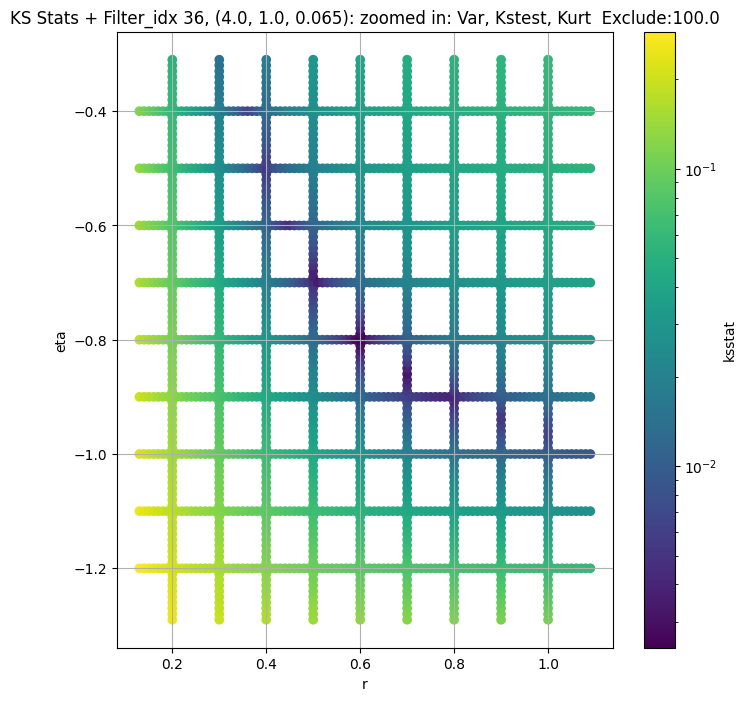

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 37, 50.0 + 100 = 150, ksstat: 0.004914068866386456, var: 3950.11083984375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 37, 50.0 + 75 = 125, ksstat: 0.004509619939523923, var: 4020.1396484375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 37, 50.0 + 50 = 100, ksstat: 0.0038705857780937936, var: 4097.19384765625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 37, 50.0 + 25 = 75, ksstat: 0.003921874667447145, var: 4182.9609375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 37, 50.0 + 0 = 50, ksstat: 0.0038498689980485112, var: 4280.6845703125


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 37, 50.0 + -25 = 25, ksstat: 0.003858825527763038, var: 4397.86669921875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 37, 50.0 + -50 = 0, ksstat: 0.0031356063249612376, var: 4569.45947265625
Number of samples: 100000, Without approximation : 2359296.0


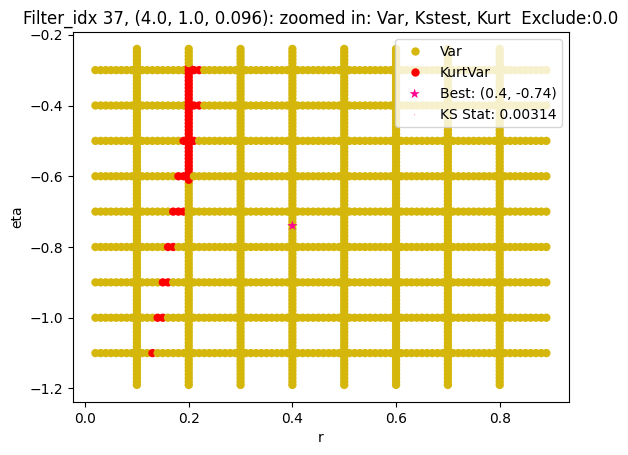

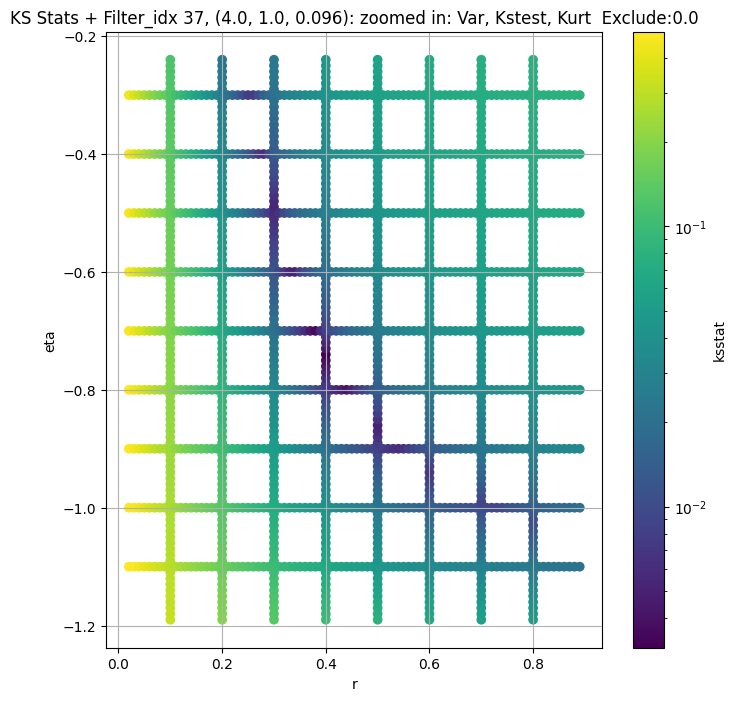

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + 100 = 200, ksstat: 0.013240507585328465, var: 1438.009765625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + 75 = 175, ksstat: 0.013239060366865119, var: 1463.742431640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + 50 = 150, ksstat: 0.01324130453598693, var: 1491.416015625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + 25 = 125, ksstat: 0.0132436641109267, var: 1521.3670654296875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + 0 = 100, ksstat: 0.013238691723064244, var: 1554.364990234375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + -25 = 75, ksstat: 0.013237631535927274, var: 1591.988037109375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + -50 = 50, ksstat: 0.013236992273349069, var: 1636.9136962890625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + -75 = 25, ksstat: 0.013236910633796617, var: 1695.8643798828125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 38, 100.0 + -100 = 0, ksstat: 0.013234760010703006, var: 1789.685791015625
Number of samples: 100000, Without approximation : 2359296.0


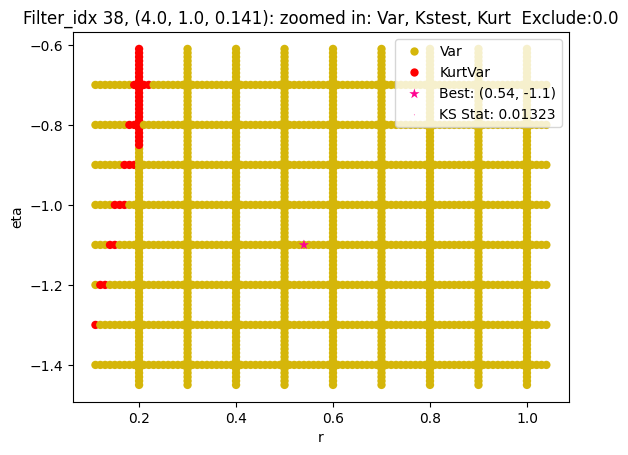

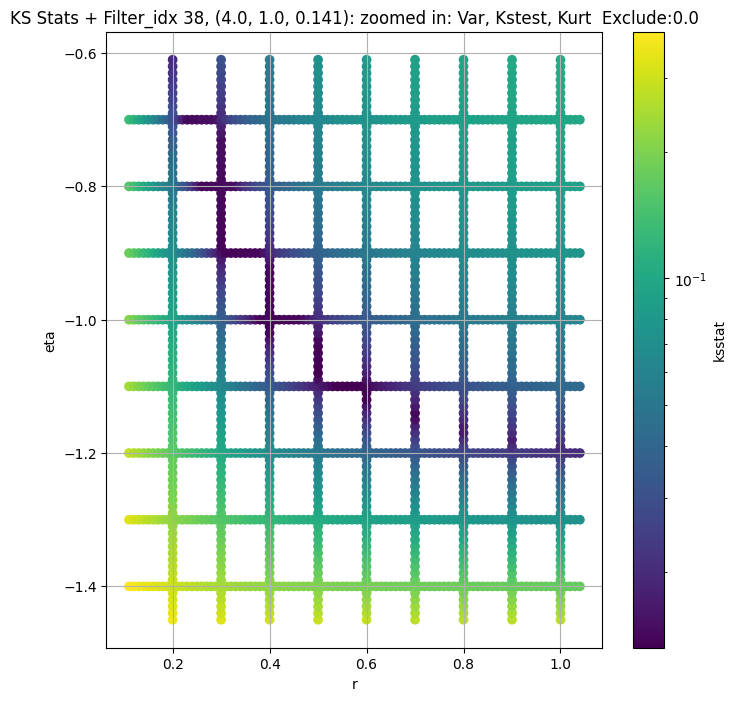

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + 100 = 200, ksstat: 0.00833308092810281, var: 488.5230407714844


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + 75 = 175, ksstat: 0.008354468787024283, var: 499.5972595214844


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + 50 = 150, ksstat: 0.00796157263103392, var: 511.6366271972656


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + 25 = 125, ksstat: 0.007999403173555852, var: 525.0377807617188


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + 0 = 100, ksstat: 0.008236356210042983, var: 539.8493041992188


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + -25 = 75, ksstat: 0.00786671030732633, var: 556.6572265625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + -50 = 50, ksstat: 0.007874658010674829, var: 576.7051391601562


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + -75 = 25, ksstat: 0.007872722761061546, var: 602.5327758789062


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 39, 100.0 + -100 = 0, ksstat: 0.007861969888719123, var: 647.6827392578125
Number of samples: 100000, Without approximation : 2359296.0


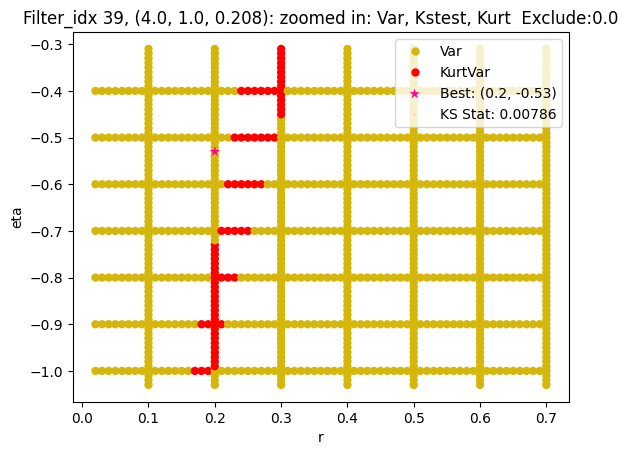

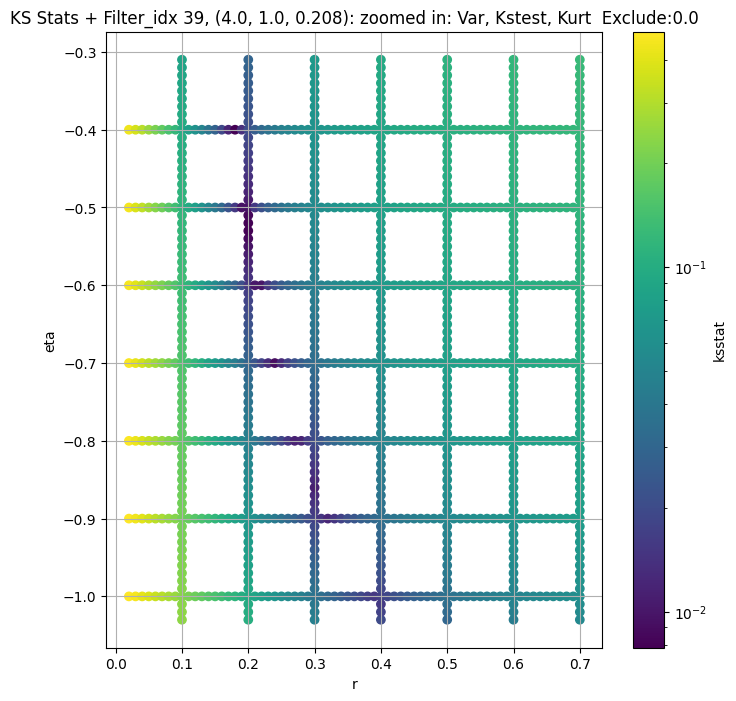

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + 100 = 300, ksstat: 0.017690115946612406, var: 165.8761749267578


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + 75 = 275, ksstat: 0.01768983595544754, var: 168.47833251953125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + 50 = 250, ksstat: 0.017689558688536278, var: 171.2475128173828


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + 25 = 225, ksstat: 0.01769058269831769, var: 174.19757080078125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + 0 = 200, ksstat: 0.017689020347235018, var: 177.35879516601562


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + -25 = 175, ksstat: 0.017688770788776953, var: 180.76441955566406


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + -50 = 150, ksstat: 0.01768856693395282, var: 184.52618408203125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + -75 = 125, ksstat: 0.01768845509001704, var: 188.81417846679688


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 40, 200.0 + -100 = 100, ksstat: 0.017688501457825634, var: 193.8798828125
Number of samples: 100000, Without approximation : 2359296.0


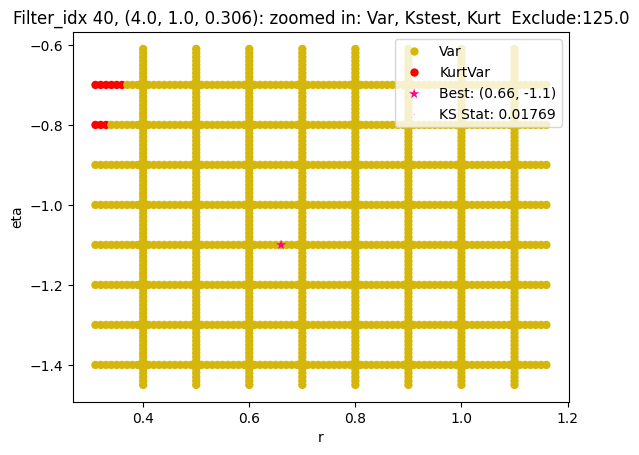

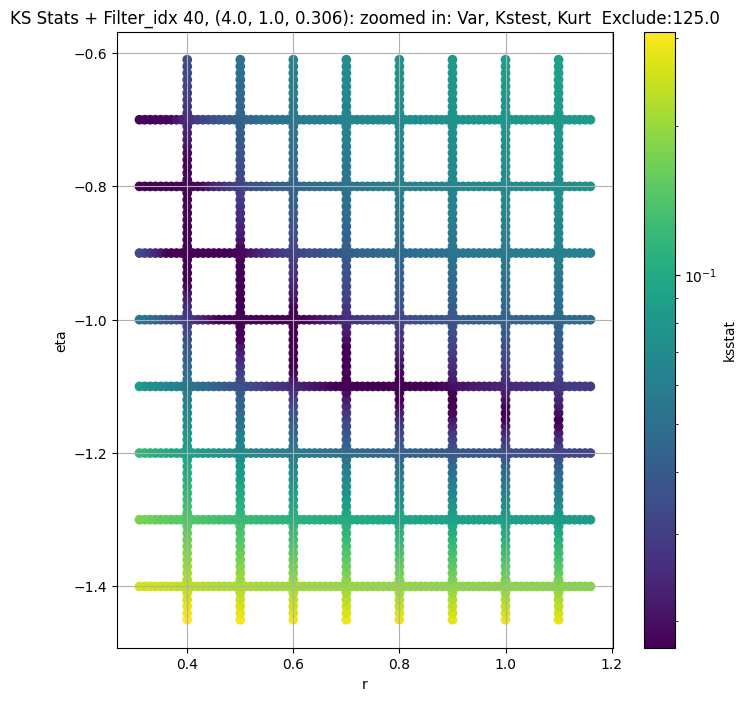

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + 100 = 300, ksstat: 0.009563554360187965, var: 28.694650650024414


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + 75 = 275, ksstat: 0.009560730000168327, var: 29.35972785949707


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + 50 = 250, ksstat: 0.009560046903291042, var: 30.086183547973633


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + 25 = 225, ksstat: 0.00956108820284024, var: 30.885601043701172


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + 0 = 200, ksstat: 0.009558181365662166, var: 31.776395797729492


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + -25 = 175, ksstat: 0.009559387558130017, var: 32.78630828857422


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + -50 = 150, ksstat: 0.009558577478398222, var: 33.95183181762695


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + -75 = 125, ksstat: 0.009560187607340564, var: 35.33582305908203


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 41, 200.0 + -100 = 100, ksstat: 0.009559793939865502, var: 37.066741943359375
Number of samples: 100000, Without approximation : 2359296.0


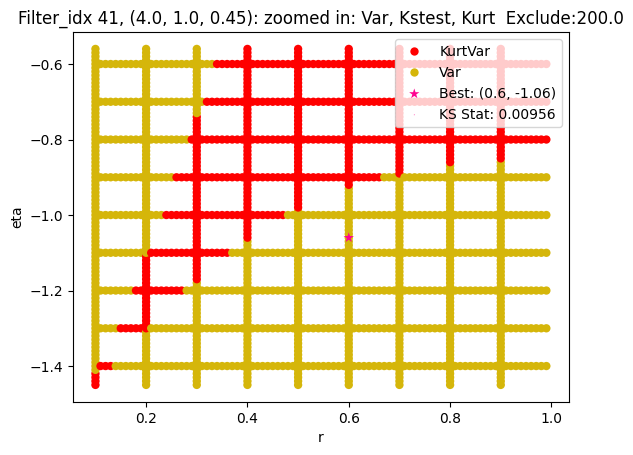

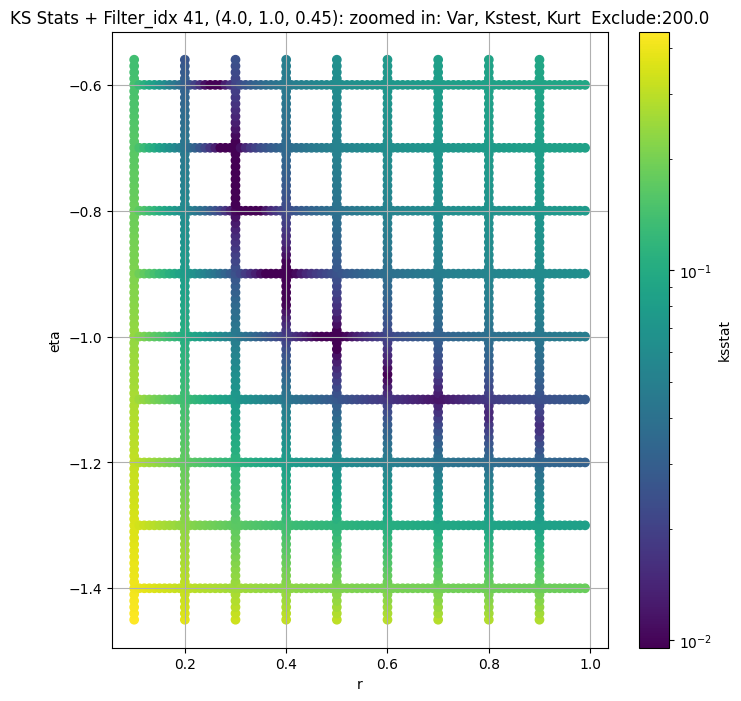

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",38922.66400,30951.148000,47092.977000,4.409872,2.737330,7.668057,2359296.0,"(2.0, 0.5, 0.044)",0.008644,...,5.683329e+04,50.0,37773.964844,0.000884,0.005212,1.10,-1.08,9.777747e+04,50.0,69984
1,"(2.0, 0.5, 0.065)",13811.33800,10857.232000,17411.840000,5.708673,3.505895,10.191732,2359296.0,"(2.0, 0.5, 0.065)",0.009054,...,1.172767e+04,0.0,13811.337891,0.000884,0.007160,0.70,-1.05,1.871063e+04,0.0,36864
2,"(2.0, 0.5, 0.096)",5212.11130,4147.616000,6494.641000,5.850252,3.246446,9.314557,2359296.0,"(2.0, 0.5, 0.096)",0.006735,...,6.220927e+03,0.0,5099.945312,0.000884,0.005995,0.70,-0.99,5.943039e+03,25.0,52488
3,"(2.0, 0.5, 0.141)",1797.79000,1354.278400,2296.739300,9.139929,5.153275,16.219257,2359296.0,"(2.0, 0.5, 0.141)",0.017808,...,6.314137e+03,200.0,1507.530396,0.000884,0.017789,1.39,-1.20,6.128946e+03,250.0,5832
4,"(2.0, 0.5, 0.208)",583.18730,428.792420,749.157100,10.078462,5.642832,22.572874,2359296.0,"(2.0, 0.5, 0.208)",0.009929,...,1.928529e-02,0.0,551.454041,0.000884,0.008274,0.30,-0.66,6.126896e+00,50.0,27648
5,"(2.0, 0.5, 0.306)",181.50945,127.899025,248.526540,15.314480,5.525773,54.680214,2359296.0,"(2.0, 0.5, 0.306)",0.010090,...,7.908279e+01,100.0,162.245468,0.000884,0.010086,0.48,-1.00,7.045173e+01,75.0,18432
6,"(2.0, 0.5, 0.45)",111.37292,80.555720,156.800570,14.459356,5.156713,57.622300,2359296.0,"(2.0, 0.5, 0.45)",0.004955,...,7.330189e-01,50.0,111.372917,0.000884,0.003583,0.24,-0.30,4.632562e-02,0.0,147456
7,"(2.0, 1.0, 0.044)",52155.28000,40917.543000,66751.110000,7.146744,4.161360,11.858514,2359296.0,"(2.0, 1.0, 0.044)",0.004159,...,5.965013e+04,50.0,47614.566406,0.000884,0.003920,0.90,-1.06,9.656542e+04,125.0,124416
8,"(2.0, 1.0, 0.065)",19633.50200,15193.773000,24351.654000,6.894701,3.830083,11.340195,2359296.0,"(2.0, 1.0, 0.065)",0.006090,...,5.237068e+04,200.0,17718.279297,0.000884,0.006090,1.24,-1.10,5.224107e+04,150.0,52488


In [19]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

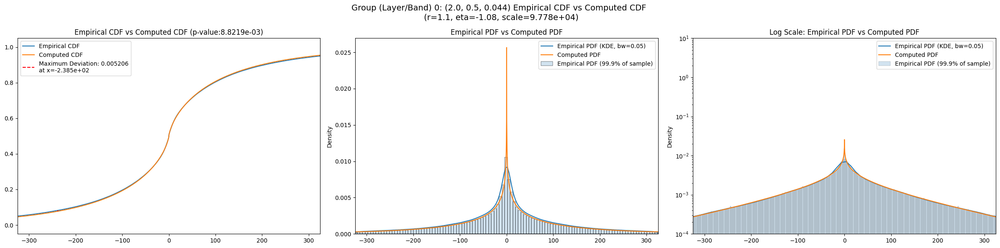

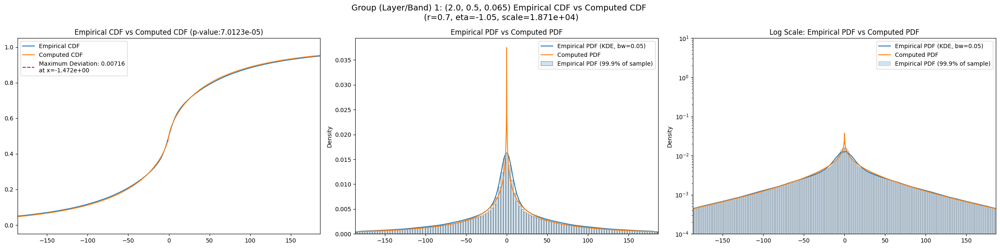

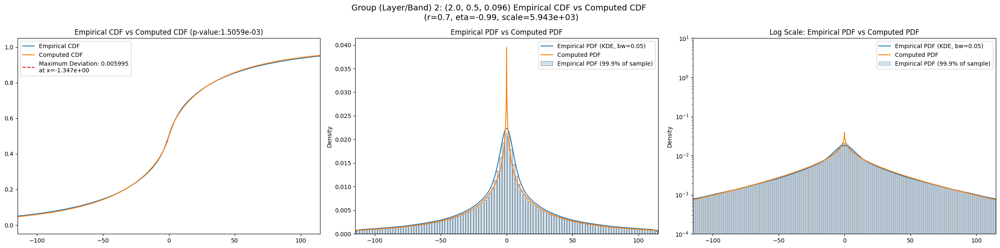

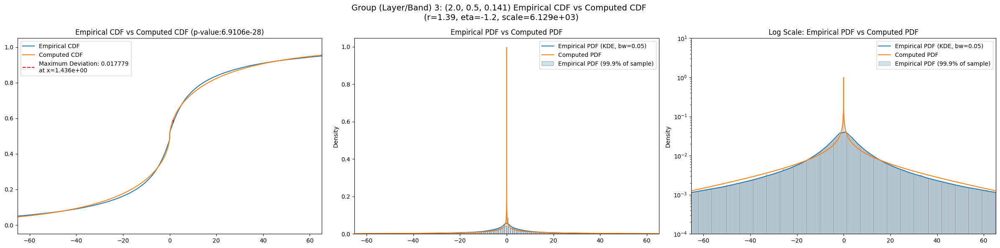

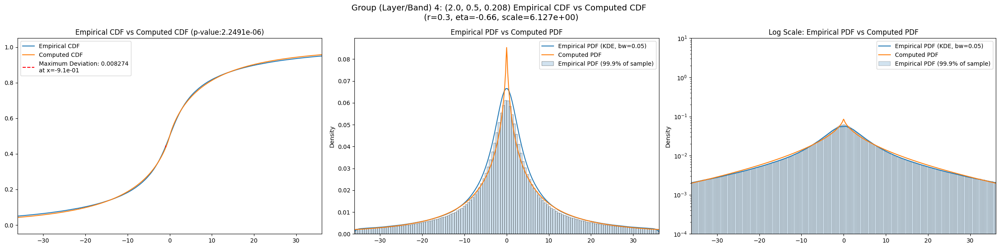

...

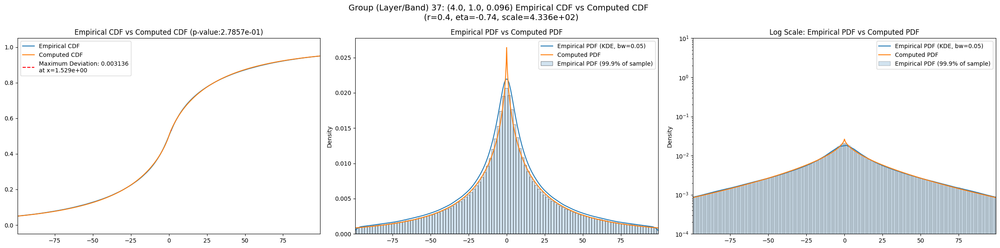

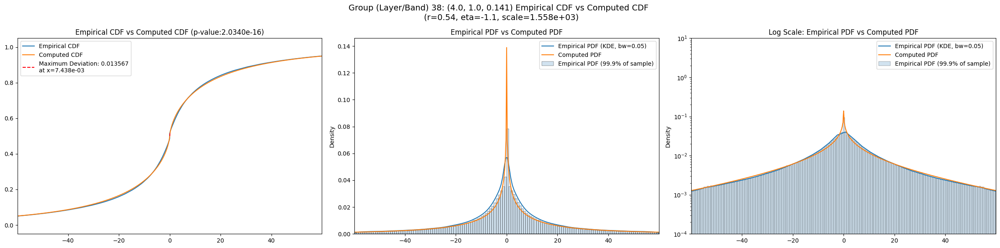

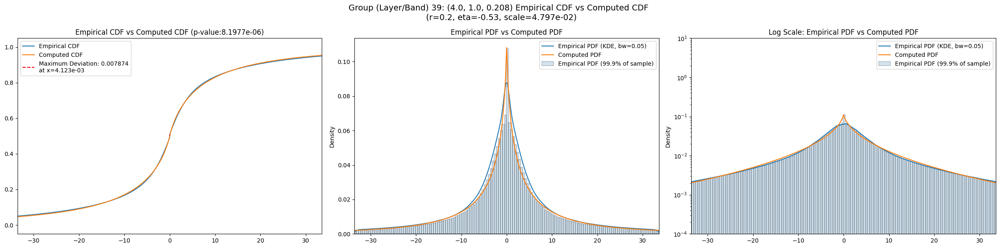

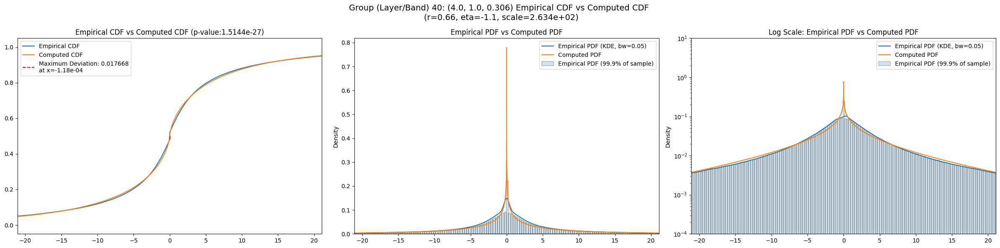

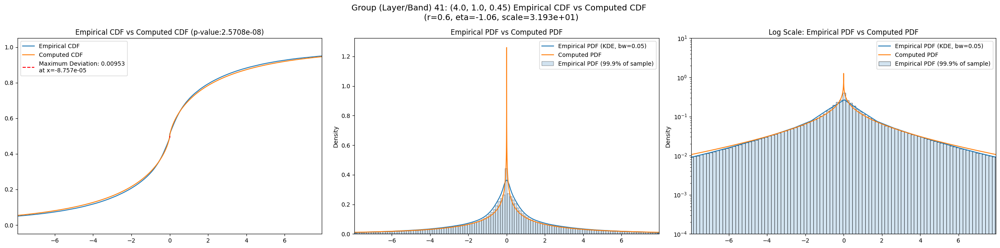

In [20]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [21]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [22]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",38922.66400,30951.148000,47092.977000,4.409872,2.737330,7.668057,2359296.0,"(2.0, 0.5, 0.044)",0.008644,...,117.88100,0.060877,0.0,99.93610,0.036344,0.0,79.90550,0.040156,0.0,4.193125e-56
1,"(2.0, 0.5, 0.065)",13811.33800,10857.232000,17411.840000,5.708673,3.505895,10.191732,2359296.0,"(2.0, 0.5, 0.065)",0.009054,...,63.00840,0.066535,0.0,53.74410,0.041296,0.0,43.07160,0.045024,0.0,1.730472e-105
2,"(2.0, 0.5, 0.096)",5212.11130,4147.616000,6494.641000,5.850252,3.246446,9.314557,2359296.0,"(2.0, 0.5, 0.096)",0.006735,...,41.35350,0.060915,0.0,35.67050,0.034487,0.0,28.49300,0.037400,0.0,4.509313e-74
3,"(2.0, 0.5, 0.141)",1797.79000,1354.278400,2296.739300,9.139929,5.153275,16.219257,2359296.0,"(2.0, 0.5, 0.141)",0.017808,...,19.25550,0.072135,0.0,16.88810,0.045713,0.0,13.14020,0.045122,0.0,0.000000e+00
4,"(2.0, 0.5, 0.208)",583.18730,428.792420,749.157100,10.078462,5.642832,22.572874,2359296.0,"(2.0, 0.5, 0.208)",0.009929,...,11.92530,0.062894,0.0,10.52260,0.036012,0.0,8.30479,0.034184,0.0,1.005881e-140
5,"(2.0, 0.5, 0.306)",181.50945,127.899025,248.526540,15.314480,5.525773,54.680214,2359296.0,"(2.0, 0.5, 0.306)",0.010090,...,6.19805,0.066632,0.0,5.43725,0.039693,0.0,4.28128,0.039254,0.0,6.579432e-209
6,"(2.0, 0.5, 0.45)",111.37292,80.555720,156.800570,14.459356,5.156713,57.622300,2359296.0,"(2.0, 0.5, 0.45)",0.004955,...,5.70063,0.054543,0.0,5.01445,0.027417,0.0,3.96747,0.027241,0.0,9.914207e-27
7,"(2.0, 1.0, 0.044)",52155.28000,40917.543000,66751.110000,7.146744,4.161360,11.858514,2359296.0,"(2.0, 1.0, 0.044)",0.004159,...,128.32100,0.057600,0.0,108.80500,0.033078,0.0,86.91200,0.036846,0.0,6.497095e-32
8,"(2.0, 1.0, 0.065)",19633.50200,15193.773000,24351.654000,6.894701,3.830083,11.340195,2359296.0,"(2.0, 1.0, 0.065)",0.006090,...,77.22260,0.061088,0.0,66.66270,0.034612,0.0,53.28740,0.037890,0.0,2.029889e-76


## Results

In [23]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [24]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.008644,0.000884,0.005212,0.060877,0.036344,0.040156
1,0.009054,0.000884,0.007160,0.066535,0.041296,0.045024
2,0.006735,0.000884,0.005995,0.060915,0.034487,0.037400
3,0.017808,0.000884,0.017789,0.072135,0.045713,0.045122
4,0.009929,0.000884,0.008274,0.062894,0.036012,0.034184
5,0.010090,0.000884,0.010086,0.066632,0.039693,0.039254
6,0.004955,0.000884,0.003583,0.054543,0.027417,0.027241
7,0.004159,0.000884,0.003920,0.057600,0.033078,0.036846
8,0.006090,0.000884,0.006090,0.061088,0.034612,0.037890


In [25]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,37773.964844,0.005212,1.10,-1.08,9.777747e+04,50.0
1,13811.337891,0.007160,0.70,-1.05,1.871063e+04,0.0
2,5099.945312,0.005995,0.70,-0.99,5.943039e+03,25.0
3,1507.530396,0.017789,1.39,-1.20,6.128946e+03,250.0
4,551.454041,0.008274,0.30,-0.66,6.126896e+00,50.0
5,162.245468,0.010086,0.48,-1.00,7.045173e+01,75.0
6,111.372917,0.003583,0.24,-0.30,4.632562e-02,0.0
7,47614.566406,0.003920,0.90,-1.06,9.656542e+04,125.0
8,17718.279297,0.006090,1.24,-1.10,5.224107e+04,150.0
